### **Implementation of WGAN with Root Mean Square loss function**

Mounted at /content/drive


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


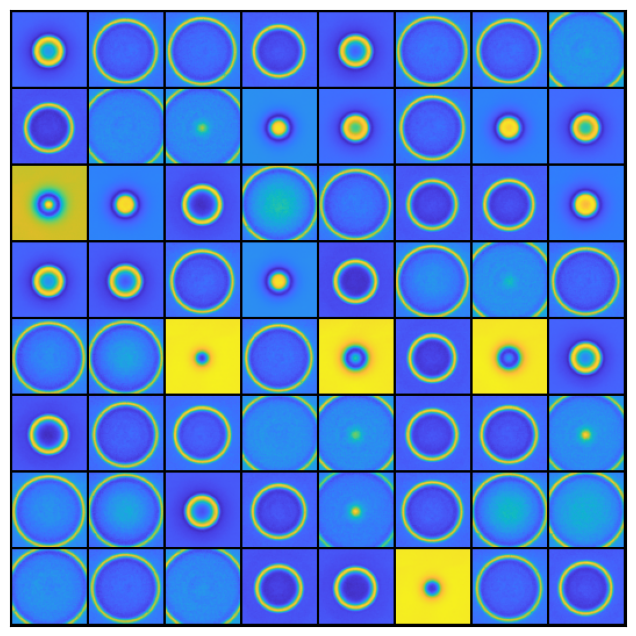

In [1]:
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as T

image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

# Connect Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Path to the dataset
DATA_DIR = '/content/drive/MyDrive/Healthy'

train_ds = ImageFolder(DATA_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)]))

train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True)

import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline


def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

show_batch(train_dl)

In [2]:
def to_device(data, device):
    #Moving tensor(s) to chosen device
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    #Wrapping a dataloader to move data to a device
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
    #Yielding a batch of data after moving it to device
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
    #Number of batches
        return len(self.dl)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

train_dl = DeviceDataLoader(train_dl, device)

### Discriminator and Generator Network

In [3]:
import torch
import torch.nn as nn

# Function to apply spectral normalization to layers in a model
def apply_spectral_norm(model):
    for name, module in model.named_modules():
        if isinstance(module, (nn.Conv2d, nn.ConvTranspose2d)):
            nn.utils.spectral_norm(module)

discriminator = nn.Sequential(
    # in: 3 x 64 x 64
    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(),
    nn.Sigmoid()
)

apply_spectral_norm(discriminator)

latent_size = 256

class ResidualBlock(nn.Module):
    def __init__(self, in_channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(in_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(in_channels)

    def forward(self, x):
        residual = x
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += residual
        out = self.relu(out)
        return out

generator = nn.Sequential(
    # in: latent_size x 1 x 1
    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(inplace=True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(inplace=True),
    # out: 256 x 8 x 8

    # A residual block
    ResidualBlock(256),

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(inplace=True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(inplace=True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

apply_spectral_norm(generator)

### Training the discriminator and generator network

Saving generated-images-0000.png


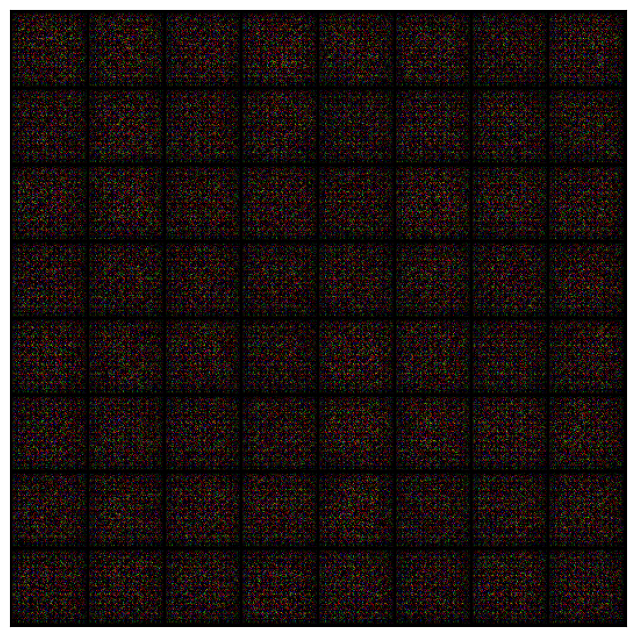

In [4]:
# Moving models and data to the device
discriminator = discriminator.to(device)
generator = generator.to(device)

def train_discriminator(real_images, opt_d):
    # Clearing discriminator gradients
    opt_d.zero_grad()

    # Passsing real images through discriminator
    real_preds = discriminator(real_images)
    real_loss = -torch.mean(real_preds)
    real_score = torch.mean(real_preds).item()

    # Generating fake images
    latent = torch.randn(real_images.size(0), latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Passing fake images through discriminator
    fake_preds = discriminator(fake_images)
    fake_loss = torch.mean(fake_preds)
    fake_score = torch.mean(fake_preds).item()

    # Calculating Wasserstein discriminator loss
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()

    # Clipping the discriminator weights (optional step for WGAN)
    for param in discriminator.parameters():
        param.data.clamp_(-0.01, 0.01)  # Clipping weights as suggested in WGAN

    return loss.item(), real_score, fake_score


def train_generator(opt_g):
    # Clearing generator gradients
    opt_g.zero_grad()

    # Generating fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Getting discriminator's predictions on fake images
    preds = discriminator(fake_images)

    # Calculating generator loss (minimize the negative mean of discriminator's output)
    loss = -torch.mean(preds)

    # Updating generator weights
    loss.backward()
    opt_g.step()

    return loss.item()

#saving the samples

from torchvision.utils import save_image
import os
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)
save_samples(0, fixed_latent)

### Full training loop

In [5]:
from tqdm.notebook import tqdm
import torch.nn.functional as F
import albumentations as A
import numpy as np

# Define a function to apply adaptive augmentation
def apply_adaptive_augmentation(images):
    # Convert PyTorch tensor to NumPy array
    images_np = images.cpu().detach().numpy()

    # Check and convert to three channels if necessary
    if images_np.shape[3] != 3:
        # Convert grayscale images to three-channel format (assuming single channel)
        images_np = np.repeat(images_np, 3, axis=3)

    # Calculate image statistics for adaptive augmentation
    mean = images_np.mean(axis=(0, 1, 2))
    std = images_np.std(axis=(0, 1, 2))

    # Define augmentation policies based on calculated statistics
    transform = A.Compose([
        A.RandomBrightnessContrast(p=0.5),
        A.OneOf([
            A.ChannelShuffle(p=0.5),
        ]),
        A.OneOf([
            A.Blur(p=0.5),
            A.GaussNoise(p=0.5),
        ]),
        # Adaptive augmentation based on image statistics
        A.OneOf([
            A.RandomGamma(p=0.5),
            A.ToGray(p=0.5),
        ], p=(mean[0] > 0.5)),
    ])

    # Apply adaptive augmentation on NumPy array
    augmented_images_np = []
    for img in images_np:
        if len(img.shape) == 3 and img.shape[2] == 3:
            augmented_images_np.append(transform(image=img)['image'])


    # Convert augmented NumPy array back to PyTorch tensor
    augmented_images = torch.from_numpy(np.array(augmented_images_np)).to(device)
    return augmented_images


#The training loop
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()

    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            augmented_real_images = apply_adaptive_augmentation(real_images)
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)

        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)

    return losses_g, losses_d, real_scores, fake_scores

In [6]:
lr = 0.0002
epochs = 1750

# Moving models and data to the device
discriminator = discriminator.to(device)
generator = generator.to(device)

# Generating random latent tensors on the same device
xb = torch.randn(batch_size, latent_size, 1, 1, device=device)

# Proceeding with your training loop or model evaluation
fake_images = generator(xb)
print(fake_images.shape)
history = fit(epochs, lr)

torch.Size([128, 3, 64, 64])


  0%|          | 0/3 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch [1/1750], loss_g: -0.5082, loss_d: 0.0071, real_score: 0.5035, fake_score: 0.5106
Saving generated-images-0001.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [2/1750], loss_g: -0.5177, loss_d: 0.0179, real_score: 0.5059, fake_score: 0.5238
Saving generated-images-0002.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [3/1750], loss_g: -0.5146, loss_d: 0.0154, real_score: 0.5063, fake_score: 0.5217
Saving generated-images-0003.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [4/1750], loss_g: -0.5088, loss_d: 0.0091, real_score: 0.5058, fake_score: 0.5149
Saving generated-images-0004.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [5/1750], loss_g: -0.5057, loss_d: 0.0053, real_score: 0.5053, fake_score: 0.5105
Saving generated-images-0005.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [6/1750], loss_g: -0.5047, loss_d: 0.0039, real_score: 0.5047, fake_score: 0.5086
Saving generated-images-0006.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [7/1750], loss_g: -0.5038, loss_d: 0.0027, real_score: 0.5046, fake_score: 0.5073
Saving generated-images-0007.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [8/1750], loss_g: -0.5033, loss_d: 0.0019, real_score: 0.5043, fake_score: 0.5062
Saving generated-images-0008.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [9/1750], loss_g: -0.5026, loss_d: 0.0010, real_score: 0.5042, fake_score: 0.5052
Saving generated-images-0009.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [10/1750], loss_g: -0.5023, loss_d: 0.0003, real_score: 0.5044, fake_score: 0.5046
Saving generated-images-0010.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [11/1750], loss_g: -0.5027, loss_d: 0.0001, real_score: 0.5048, fake_score: 0.5049
Saving generated-images-0011.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [12/1750], loss_g: -0.5027, loss_d: -0.0001, real_score: 0.5049, fake_score: 0.5048
Saving generated-images-0012.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [13/1750], loss_g: -0.5023, loss_d: -0.0009, real_score: 0.5052, fake_score: 0.5043
Saving generated-images-0013.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [14/1750], loss_g: -0.5023, loss_d: -0.0017, real_score: 0.5061, fake_score: 0.5045
Saving generated-images-0014.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [15/1750], loss_g: -0.5024, loss_d: -0.0020, real_score: 0.5070, fake_score: 0.5050
Saving generated-images-0015.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [16/1750], loss_g: -0.5026, loss_d: -0.0025, real_score: 0.5080, fake_score: 0.5054
Saving generated-images-0016.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [17/1750], loss_g: -0.5026, loss_d: -0.0029, real_score: 0.5086, fake_score: 0.5057
Saving generated-images-0017.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [18/1750], loss_g: -0.5021, loss_d: -0.0043, real_score: 0.5099, fake_score: 0.5056
Saving generated-images-0018.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [19/1750], loss_g: -0.5010, loss_d: -0.0063, real_score: 0.5114, fake_score: 0.5051
Saving generated-images-0019.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [20/1750], loss_g: -0.5001, loss_d: -0.0086, real_score: 0.5142, fake_score: 0.5055
Saving generated-images-0020.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [21/1750], loss_g: -0.4983, loss_d: -0.0111, real_score: 0.5169, fake_score: 0.5059
Saving generated-images-0021.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [22/1750], loss_g: -0.4939, loss_d: -0.0159, real_score: 0.5202, fake_score: 0.5043
Saving generated-images-0022.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [23/1750], loss_g: -0.4851, loss_d: -0.0254, real_score: 0.5243, fake_score: 0.4989
Saving generated-images-0023.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [24/1750], loss_g: -0.4714, loss_d: -0.0432, real_score: 0.5318, fake_score: 0.4885
Saving generated-images-0024.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [25/1750], loss_g: -0.4625, loss_d: -0.0534, real_score: 0.5383, fake_score: 0.4848
Saving generated-images-0025.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [26/1750], loss_g: -0.4511, loss_d: -0.0756, real_score: 0.5471, fake_score: 0.4715
Saving generated-images-0026.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [27/1750], loss_g: -0.4336, loss_d: -0.1039, real_score: 0.5613, fake_score: 0.4573
Saving generated-images-0027.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [28/1750], loss_g: -0.4194, loss_d: -0.1316, real_score: 0.5713, fake_score: 0.4397
Saving generated-images-0028.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [29/1750], loss_g: -0.4063, loss_d: -0.1579, real_score: 0.5848, fake_score: 0.4269
Saving generated-images-0029.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [30/1750], loss_g: -0.3925, loss_d: -0.1841, real_score: 0.6013, fake_score: 0.4172
Saving generated-images-0030.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [31/1750], loss_g: -0.3991, loss_d: -0.1462, real_score: 0.5450, fake_score: 0.3988
Saving generated-images-0031.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [32/1750], loss_g: -0.3975, loss_d: -0.1522, real_score: 0.5930, fake_score: 0.4408
Saving generated-images-0032.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [33/1750], loss_g: -0.3694, loss_d: -0.2320, real_score: 0.6191, fake_score: 0.3871
Saving generated-images-0033.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [34/1750], loss_g: -0.3592, loss_d: -0.2580, real_score: 0.6299, fake_score: 0.3719
Saving generated-images-0034.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [35/1750], loss_g: -0.3513, loss_d: -0.2797, real_score: 0.6427, fake_score: 0.3630
Saving generated-images-0035.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [36/1750], loss_g: -0.3462, loss_d: -0.2944, real_score: 0.6498, fake_score: 0.3554
Saving generated-images-0036.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [37/1750], loss_g: -0.3390, loss_d: -0.3050, real_score: 0.6515, fake_score: 0.3465
Saving generated-images-0037.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [38/1750], loss_g: -0.3351, loss_d: -0.3138, real_score: 0.6557, fake_score: 0.3419
Saving generated-images-0038.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [39/1750], loss_g: -0.3344, loss_d: -0.3186, real_score: 0.6613, fake_score: 0.3428
Saving generated-images-0039.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [40/1750], loss_g: -0.3287, loss_d: -0.3252, real_score: 0.6633, fake_score: 0.3381
Saving generated-images-0040.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [41/1750], loss_g: -0.3286, loss_d: -0.3266, real_score: 0.6670, fake_score: 0.3404
Saving generated-images-0041.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [42/1750], loss_g: -0.3274, loss_d: -0.3251, real_score: 0.6616, fake_score: 0.3364
Saving generated-images-0042.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [43/1750], loss_g: -0.3262, loss_d: -0.3385, real_score: 0.6721, fake_score: 0.3336
Saving generated-images-0043.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [44/1750], loss_g: -0.3612, loss_d: -0.3127, real_score: 0.6453, fake_score: 0.3326
Saving generated-images-0044.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [45/1750], loss_g: -0.3300, loss_d: -0.3051, real_score: 0.6315, fake_score: 0.3264
Saving generated-images-0045.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [46/1750], loss_g: -0.3265, loss_d: -0.3344, real_score: 0.6738, fake_score: 0.3394
Saving generated-images-0046.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [47/1750], loss_g: -0.3208, loss_d: -0.3489, real_score: 0.6747, fake_score: 0.3257
Saving generated-images-0047.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [48/1750], loss_g: -0.3218, loss_d: -0.3404, real_score: 0.6740, fake_score: 0.3336
Saving generated-images-0048.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [49/1750], loss_g: -0.3247, loss_d: -0.1319, real_score: 0.6696, fake_score: 0.5377
Saving generated-images-0049.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [50/1750], loss_g: -0.3792, loss_d: -0.0766, real_score: 0.6755, fake_score: 0.5989
Saving generated-images-0050.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [51/1750], loss_g: -0.3718, loss_d: -0.1491, real_score: 0.6671, fake_score: 0.5180
Saving generated-images-0051.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [52/1750], loss_g: -0.3265, loss_d: -0.3098, real_score: 0.6463, fake_score: 0.3365
Saving generated-images-0052.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [53/1750], loss_g: -0.3174, loss_d: -0.3268, real_score: 0.6743, fake_score: 0.3475
Saving generated-images-0053.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [54/1750], loss_g: -0.6162, loss_d: -0.0177, real_score: 0.6777, fake_score: 0.6600
Saving generated-images-0054.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [55/1750], loss_g: -0.6325, loss_d: 0.0029, real_score: 0.6437, fake_score: 0.6467
Saving generated-images-0055.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [56/1750], loss_g: -0.5271, loss_d: -0.0419, real_score: 0.6442, fake_score: 0.6022
Saving generated-images-0056.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [57/1750], loss_g: -0.3843, loss_d: -0.1358, real_score: 0.6405, fake_score: 0.5047
Saving generated-images-0057.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [58/1750], loss_g: -0.3246, loss_d: -0.2007, real_score: 0.6344, fake_score: 0.4337
Saving generated-images-0058.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [59/1750], loss_g: -0.3530, loss_d: -0.2735, real_score: 0.6087, fake_score: 0.3352
Saving generated-images-0059.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [60/1750], loss_g: -0.3600, loss_d: -0.1775, real_score: 0.5052, fake_score: 0.3276
Saving generated-images-0060.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [61/1750], loss_g: -0.3330, loss_d: -0.2911, real_score: 0.6419, fake_score: 0.3508
Saving generated-images-0061.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [62/1750], loss_g: -0.3223, loss_d: -0.3317, real_score: 0.6655, fake_score: 0.3338
Saving generated-images-0062.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [63/1750], loss_g: -0.3243, loss_d: -0.3386, real_score: 0.6712, fake_score: 0.3326
Saving generated-images-0063.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [64/1750], loss_g: -0.3257, loss_d: -0.3328, real_score: 0.6622, fake_score: 0.3294
Saving generated-images-0064.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [65/1750], loss_g: -0.3272, loss_d: -0.0991, real_score: 0.6726, fake_score: 0.5736
Saving generated-images-0065.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [66/1750], loss_g: -0.3977, loss_d: -0.2314, real_score: 0.5797, fake_score: 0.3483
Saving generated-images-0066.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [67/1750], loss_g: -0.3876, loss_d: -0.2120, real_score: 0.5767, fake_score: 0.3647
Saving generated-images-0067.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [68/1750], loss_g: -0.3259, loss_d: -0.2755, real_score: 0.6402, fake_score: 0.3647
Saving generated-images-0068.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [69/1750], loss_g: -0.3173, loss_d: -0.3419, real_score: 0.6714, fake_score: 0.3295
Saving generated-images-0069.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [70/1750], loss_g: -0.3170, loss_d: -0.3515, real_score: 0.6756, fake_score: 0.3241
Saving generated-images-0070.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [71/1750], loss_g: -0.3189, loss_d: -0.3593, real_score: 0.6788, fake_score: 0.3195
Saving generated-images-0071.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [72/1750], loss_g: -0.3114, loss_d: -0.3266, real_score: 0.6817, fake_score: 0.3551
Saving generated-images-0072.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [73/1750], loss_g: -0.3660, loss_d: -0.0737, real_score: 0.6640, fake_score: 0.5903
Saving generated-images-0073.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [74/1750], loss_g: -0.4770, loss_d: -0.0507, real_score: 0.6754, fake_score: 0.6247
Saving generated-images-0074.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [75/1750], loss_g: -0.3713, loss_d: -0.2089, real_score: 0.5744, fake_score: 0.3655
Saving generated-images-0075.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [76/1750], loss_g: -0.3291, loss_d: -0.3034, real_score: 0.6643, fake_score: 0.3608
Saving generated-images-0076.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [77/1750], loss_g: -0.3279, loss_d: -0.3341, real_score: 0.6625, fake_score: 0.3284
Saving generated-images-0077.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [78/1750], loss_g: -0.3187, loss_d: -0.3413, real_score: 0.6770, fake_score: 0.3358
Saving generated-images-0078.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [79/1750], loss_g: -0.3459, loss_d: -0.3325, real_score: 0.6535, fake_score: 0.3210
Saving generated-images-0079.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [80/1750], loss_g: -0.3226, loss_d: -0.1624, real_score: 0.6656, fake_score: 0.5032
Saving generated-images-0080.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [81/1750], loss_g: -0.3580, loss_d: -0.2442, real_score: 0.5831, fake_score: 0.3389
Saving generated-images-0081.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [82/1750], loss_g: -0.3214, loss_d: -0.2499, real_score: 0.6652, fake_score: 0.4152
Saving generated-images-0082.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [83/1750], loss_g: -0.3606, loss_d: -0.2226, real_score: 0.5690, fake_score: 0.3464
Saving generated-images-0083.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [84/1750], loss_g: -0.3236, loss_d: -0.2670, real_score: 0.6555, fake_score: 0.3884
Saving generated-images-0084.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [85/1750], loss_g: -0.3647, loss_d: -0.1966, real_score: 0.5163, fake_score: 0.3197
Saving generated-images-0085.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [86/1750], loss_g: -0.3212, loss_d: -0.2585, real_score: 0.6712, fake_score: 0.4127
Saving generated-images-0086.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [87/1750], loss_g: -0.3731, loss_d: -0.2126, real_score: 0.5456, fake_score: 0.3330
Saving generated-images-0087.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [88/1750], loss_g: -0.3511, loss_d: -0.2762, real_score: 0.6346, fake_score: 0.3584
Saving generated-images-0088.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [89/1750], loss_g: -0.3258, loss_d: -0.2622, real_score: 0.6565, fake_score: 0.3943
Saving generated-images-0089.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [90/1750], loss_g: -0.3592, loss_d: -0.1792, real_score: 0.5088, fake_score: 0.3296
Saving generated-images-0090.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [91/1750], loss_g: -0.3346, loss_d: -0.2420, real_score: 0.6508, fake_score: 0.4088
Saving generated-images-0091.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [92/1750], loss_g: -0.3426, loss_d: -0.2646, real_score: 0.6328, fake_score: 0.3682
Saving generated-images-0092.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [93/1750], loss_g: -0.3316, loss_d: -0.2514, real_score: 0.6442, fake_score: 0.3928
Saving generated-images-0093.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [94/1750], loss_g: -0.3632, loss_d: -0.1882, real_score: 0.5195, fake_score: 0.3313
Saving generated-images-0094.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [95/1750], loss_g: -0.3451, loss_d: -0.1218, real_score: 0.6618, fake_score: 0.5400
Saving generated-images-0095.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [96/1750], loss_g: -0.3328, loss_d: -0.2866, real_score: 0.6444, fake_score: 0.3579
Saving generated-images-0096.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [97/1750], loss_g: -0.3371, loss_d: -0.2917, real_score: 0.6450, fake_score: 0.3533
Saving generated-images-0097.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [98/1750], loss_g: -0.3218, loss_d: -0.1967, real_score: 0.6629, fake_score: 0.4662
Saving generated-images-0098.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [99/1750], loss_g: -0.3788, loss_d: -0.1880, real_score: 0.6010, fake_score: 0.4130
Saving generated-images-0099.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [100/1750], loss_g: -0.3394, loss_d: -0.2361, real_score: 0.6337, fake_score: 0.3976
Saving generated-images-0100.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [101/1750], loss_g: -0.3485, loss_d: -0.2674, real_score: 0.6163, fake_score: 0.3489
Saving generated-images-0101.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [102/1750], loss_g: -0.3386, loss_d: -0.1677, real_score: 0.6590, fake_score: 0.4914
Saving generated-images-0102.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [103/1750], loss_g: -0.3506, loss_d: -0.2662, real_score: 0.6182, fake_score: 0.3521
Saving generated-images-0103.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [104/1750], loss_g: -0.3422, loss_d: -0.2604, real_score: 0.6333, fake_score: 0.3730
Saving generated-images-0104.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [105/1750], loss_g: -0.3387, loss_d: -0.2866, real_score: 0.6505, fake_score: 0.3639
Saving generated-images-0105.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [106/1750], loss_g: -0.3743, loss_d: -0.1661, real_score: 0.4950, fake_score: 0.3289
Saving generated-images-0106.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [107/1750], loss_g: -0.3342, loss_d: -0.2492, real_score: 0.6364, fake_score: 0.3872
Saving generated-images-0107.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [108/1750], loss_g: -0.3569, loss_d: -0.1716, real_score: 0.5103, fake_score: 0.3387
Saving generated-images-0108.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [109/1750], loss_g: -0.3689, loss_d: -0.2442, real_score: 0.6027, fake_score: 0.3586
Saving generated-images-0109.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [110/1750], loss_g: -0.3327, loss_d: -0.2440, real_score: 0.6626, fake_score: 0.4186
Saving generated-images-0110.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [111/1750], loss_g: -0.3463, loss_d: -0.2543, real_score: 0.6331, fake_score: 0.3788
Saving generated-images-0111.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [112/1750], loss_g: -0.3417, loss_d: -0.2675, real_score: 0.6325, fake_score: 0.3651
Saving generated-images-0112.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [113/1750], loss_g: -0.3442, loss_d: -0.2753, real_score: 0.6319, fake_score: 0.3567
Saving generated-images-0113.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [114/1750], loss_g: -0.3509, loss_d: -0.2853, real_score: 0.6307, fake_score: 0.3454
Saving generated-images-0114.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [115/1750], loss_g: -0.3331, loss_d: -0.2869, real_score: 0.6564, fake_score: 0.3696
Saving generated-images-0115.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [116/1750], loss_g: -0.3612, loss_d: -0.2780, real_score: 0.6326, fake_score: 0.3546
Saving generated-images-0116.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [117/1750], loss_g: -0.3270, loss_d: -0.2809, real_score: 0.6564, fake_score: 0.3755
Saving generated-images-0117.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [118/1750], loss_g: -0.3698, loss_d: -0.1758, real_score: 0.4970, fake_score: 0.3211
Saving generated-images-0118.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [119/1750], loss_g: -0.3407, loss_d: -0.2768, real_score: 0.6407, fake_score: 0.3639
Saving generated-images-0119.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [120/1750], loss_g: -0.4147, loss_d: -0.2532, real_score: 0.5819, fake_score: 0.3287
Saving generated-images-0120.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [121/1750], loss_g: -0.3314, loss_d: -0.3204, real_score: 0.6653, fake_score: 0.3449
Saving generated-images-0121.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [122/1750], loss_g: -0.3307, loss_d: -0.3286, real_score: 0.6649, fake_score: 0.3363
Saving generated-images-0122.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [123/1750], loss_g: -0.3378, loss_d: -0.2884, real_score: 0.6410, fake_score: 0.3525
Saving generated-images-0123.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [124/1750], loss_g: -0.3303, loss_d: -0.2869, real_score: 0.6598, fake_score: 0.3730
Saving generated-images-0124.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [125/1750], loss_g: -0.3237, loss_d: -0.3081, real_score: 0.6673, fake_score: 0.3593
Saving generated-images-0125.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [126/1750], loss_g: -0.3249, loss_d: -0.3023, real_score: 0.6601, fake_score: 0.3579
Saving generated-images-0126.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [127/1750], loss_g: -0.3326, loss_d: -0.2795, real_score: 0.6036, fake_score: 0.3242
Saving generated-images-0127.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [128/1750], loss_g: -0.3265, loss_d: -0.3279, real_score: 0.6543, fake_score: 0.3264
Saving generated-images-0128.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [129/1750], loss_g: -0.3375, loss_d: -0.3138, real_score: 0.6438, fake_score: 0.3300
Saving generated-images-0129.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [130/1750], loss_g: -0.3194, loss_d: -0.2359, real_score: 0.6725, fake_score: 0.4366
Saving generated-images-0130.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [131/1750], loss_g: -0.3301, loss_d: -0.2113, real_score: 0.6606, fake_score: 0.4494
Saving generated-images-0131.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [132/1750], loss_g: -0.3554, loss_d: -0.2634, real_score: 0.6155, fake_score: 0.3521
Saving generated-images-0132.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [133/1750], loss_g: -0.3526, loss_d: -0.2835, real_score: 0.6327, fake_score: 0.3492
Saving generated-images-0133.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [134/1750], loss_g: -0.3303, loss_d: -0.1452, real_score: 0.6557, fake_score: 0.5104
Saving generated-images-0134.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [135/1750], loss_g: -0.3413, loss_d: -0.2631, real_score: 0.6225, fake_score: 0.3594
Saving generated-images-0135.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [136/1750], loss_g: -0.3454, loss_d: -0.2755, real_score: 0.6196, fake_score: 0.3441
Saving generated-images-0136.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [137/1750], loss_g: -0.3480, loss_d: -0.2916, real_score: 0.6282, fake_score: 0.3366
Saving generated-images-0137.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [138/1750], loss_g: -0.3189, loss_d: -0.2614, real_score: 0.6690, fake_score: 0.4076
Saving generated-images-0138.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [139/1750], loss_g: -0.3419, loss_d: -0.2340, real_score: 0.6255, fake_score: 0.3915
Saving generated-images-0139.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [140/1750], loss_g: -0.3561, loss_d: -0.2475, real_score: 0.5891, fake_score: 0.3416
Saving generated-images-0140.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [141/1750], loss_g: -0.3407, loss_d: -0.2733, real_score: 0.6225, fake_score: 0.3492
Saving generated-images-0141.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [142/1750], loss_g: -0.3305, loss_d: -0.2814, real_score: 0.6537, fake_score: 0.3724
Saving generated-images-0142.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [143/1750], loss_g: -0.3342, loss_d: -0.3033, real_score: 0.6499, fake_score: 0.3467
Saving generated-images-0143.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [144/1750], loss_g: -0.3560, loss_d: -0.2924, real_score: 0.6237, fake_score: 0.3313
Saving generated-images-0144.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [145/1750], loss_g: -0.3344, loss_d: -0.2363, real_score: 0.6524, fake_score: 0.4160
Saving generated-images-0145.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [146/1750], loss_g: -0.3548, loss_d: -0.2281, real_score: 0.5552, fake_score: 0.3271
Saving generated-images-0146.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [147/1750], loss_g: -0.3591, loss_d: -0.2579, real_score: 0.6031, fake_score: 0.3452
Saving generated-images-0147.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [148/1750], loss_g: -0.3390, loss_d: -0.2834, real_score: 0.6415, fake_score: 0.3581
Saving generated-images-0148.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [149/1750], loss_g: -0.3352, loss_d: -0.2922, real_score: 0.6536, fake_score: 0.3614
Saving generated-images-0149.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [150/1750], loss_g: -0.3303, loss_d: -0.3092, real_score: 0.6515, fake_score: 0.3422
Saving generated-images-0150.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [151/1750], loss_g: -0.3316, loss_d: -0.2988, real_score: 0.6563, fake_score: 0.3576
Saving generated-images-0151.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [152/1750], loss_g: -0.3353, loss_d: -0.3082, real_score: 0.6473, fake_score: 0.3392
Saving generated-images-0152.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [153/1750], loss_g: -0.3362, loss_d: -0.2836, real_score: 0.6486, fake_score: 0.3650
Saving generated-images-0153.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [154/1750], loss_g: -0.3453, loss_d: -0.2957, real_score: 0.6376, fake_score: 0.3419
Saving generated-images-0154.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [155/1750], loss_g: -0.3259, loss_d: -0.2612, real_score: 0.6646, fake_score: 0.4033
Saving generated-images-0155.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [156/1750], loss_g: -0.3762, loss_d: -0.1829, real_score: 0.5089, fake_score: 0.3260
Saving generated-images-0156.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [157/1750], loss_g: -0.3431, loss_d: -0.2657, real_score: 0.6447, fake_score: 0.3790
Saving generated-images-0157.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [158/1750], loss_g: -0.3332, loss_d: -0.2875, real_score: 0.6573, fake_score: 0.3698
Saving generated-images-0158.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [159/1750], loss_g: -0.3334, loss_d: -0.2898, real_score: 0.6458, fake_score: 0.3560
Saving generated-images-0159.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [160/1750], loss_g: -0.3351, loss_d: -0.3059, real_score: 0.6558, fake_score: 0.3499
Saving generated-images-0160.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [161/1750], loss_g: -0.3461, loss_d: -0.2974, real_score: 0.6427, fake_score: 0.3453
Saving generated-images-0161.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [162/1750], loss_g: -0.3347, loss_d: -0.2945, real_score: 0.6496, fake_score: 0.3550
Saving generated-images-0162.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [163/1750], loss_g: -0.3323, loss_d: -0.3074, real_score: 0.6529, fake_score: 0.3456
Saving generated-images-0163.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [164/1750], loss_g: -0.3298, loss_d: -0.2982, real_score: 0.6541, fake_score: 0.3560
Saving generated-images-0164.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [165/1750], loss_g: -0.4079, loss_d: -0.2282, real_score: 0.5582, fake_score: 0.3300
Saving generated-images-0165.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [166/1750], loss_g: -0.3400, loss_d: -0.3106, real_score: 0.6635, fake_score: 0.3529
Saving generated-images-0166.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [167/1750], loss_g: -0.3230, loss_d: -0.1596, real_score: 0.6709, fake_score: 0.5113
Saving generated-images-0167.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [168/1750], loss_g: -0.3273, loss_d: -0.2868, real_score: 0.6508, fake_score: 0.3640
Saving generated-images-0168.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [169/1750], loss_g: -0.3644, loss_d: -0.2303, real_score: 0.5518, fake_score: 0.3214
Saving generated-images-0169.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [170/1750], loss_g: -0.3356, loss_d: -0.2939, real_score: 0.6594, fake_score: 0.3654
Saving generated-images-0170.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [171/1750], loss_g: -0.3391, loss_d: -0.2935, real_score: 0.6442, fake_score: 0.3507
Saving generated-images-0171.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [172/1750], loss_g: -0.3238, loss_d: -0.2698, real_score: 0.6561, fake_score: 0.3863
Saving generated-images-0172.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [173/1750], loss_g: -0.3281, loss_d: -0.3029, real_score: 0.6553, fake_score: 0.3523
Saving generated-images-0173.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [174/1750], loss_g: -0.3274, loss_d: -0.3021, real_score: 0.6568, fake_score: 0.3547
Saving generated-images-0174.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [175/1750], loss_g: -0.3430, loss_d: -0.2962, real_score: 0.6403, fake_score: 0.3441
Saving generated-images-0175.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [176/1750], loss_g: -0.3352, loss_d: -0.2848, real_score: 0.6555, fake_score: 0.3707
Saving generated-images-0176.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [177/1750], loss_g: -0.3237, loss_d: -0.3000, real_score: 0.6599, fake_score: 0.3599
Saving generated-images-0177.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [178/1750], loss_g: -0.3722, loss_d: -0.2356, real_score: 0.5611, fake_score: 0.3255
Saving generated-images-0178.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [179/1750], loss_g: -0.4068, loss_d: -0.1772, real_score: 0.5731, fake_score: 0.3958
Saving generated-images-0179.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [180/1750], loss_g: -0.3525, loss_d: -0.2597, real_score: 0.6336, fake_score: 0.3739
Saving generated-images-0180.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [181/1750], loss_g: -0.3349, loss_d: -0.2764, real_score: 0.6483, fake_score: 0.3719
Saving generated-images-0181.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [182/1750], loss_g: -0.3429, loss_d: -0.2590, real_score: 0.6013, fake_score: 0.3423
Saving generated-images-0182.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [183/1750], loss_g: -0.3455, loss_d: -0.2706, real_score: 0.6132, fake_score: 0.3426
Saving generated-images-0183.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [184/1750], loss_g: -0.3452, loss_d: -0.2883, real_score: 0.6368, fake_score: 0.3484
Saving generated-images-0184.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [185/1750], loss_g: -0.3304, loss_d: -0.2781, real_score: 0.6557, fake_score: 0.3776
Saving generated-images-0185.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [186/1750], loss_g: -0.3359, loss_d: -0.2945, real_score: 0.6373, fake_score: 0.3428
Saving generated-images-0186.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [187/1750], loss_g: -0.3355, loss_d: -0.2998, real_score: 0.6540, fake_score: 0.3542
Saving generated-images-0187.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [188/1750], loss_g: -0.3413, loss_d: -0.2852, real_score: 0.6442, fake_score: 0.3591
Saving generated-images-0188.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [189/1750], loss_g: -0.3305, loss_d: -0.2937, real_score: 0.6592, fake_score: 0.3655
Saving generated-images-0189.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [190/1750], loss_g: -0.3751, loss_d: -0.2772, real_score: 0.6075, fake_score: 0.3303
Saving generated-images-0190.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [191/1750], loss_g: -0.3321, loss_d: -0.2206, real_score: 0.6599, fake_score: 0.4393
Saving generated-images-0191.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [192/1750], loss_g: -0.3399, loss_d: -0.2711, real_score: 0.6226, fake_score: 0.3515
Saving generated-images-0192.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [193/1750], loss_g: -0.3429, loss_d: -0.2857, real_score: 0.6410, fake_score: 0.3553
Saving generated-images-0193.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [194/1750], loss_g: -0.3458, loss_d: -0.2880, real_score: 0.6348, fake_score: 0.3468
Saving generated-images-0194.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [195/1750], loss_g: -0.3383, loss_d: -0.2898, real_score: 0.6519, fake_score: 0.3620
Saving generated-images-0195.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [196/1750], loss_g: -0.3434, loss_d: -0.2903, real_score: 0.6395, fake_score: 0.3491
Saving generated-images-0196.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [197/1750], loss_g: -0.3310, loss_d: -0.2664, real_score: 0.6596, fake_score: 0.3932
Saving generated-images-0197.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [198/1750], loss_g: -0.3278, loss_d: -0.2880, real_score: 0.6515, fake_score: 0.3635
Saving generated-images-0198.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [199/1750], loss_g: -0.3198, loss_d: -0.3147, real_score: 0.6627, fake_score: 0.3481
Saving generated-images-0199.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [200/1750], loss_g: -0.3250, loss_d: -0.3258, real_score: 0.6617, fake_score: 0.3360
Saving generated-images-0200.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [201/1750], loss_g: -0.3480, loss_d: -0.3070, real_score: 0.6414, fake_score: 0.3344
Saving generated-images-0201.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [202/1750], loss_g: -0.3286, loss_d: -0.2961, real_score: 0.6670, fake_score: 0.3710
Saving generated-images-0202.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [203/1750], loss_g: -0.3538, loss_d: -0.2749, real_score: 0.6311, fake_score: 0.3563
Saving generated-images-0203.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [204/1750], loss_g: -0.3252, loss_d: -0.2643, real_score: 0.6694, fake_score: 0.4051
Saving generated-images-0204.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [205/1750], loss_g: -0.3525, loss_d: -0.2283, real_score: 0.5681, fake_score: 0.3398
Saving generated-images-0205.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [206/1750], loss_g: -0.3732, loss_d: -0.2678, real_score: 0.6126, fake_score: 0.3448
Saving generated-images-0206.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [207/1750], loss_g: -0.3425, loss_d: -0.2949, real_score: 0.6580, fake_score: 0.3631
Saving generated-images-0207.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [208/1750], loss_g: -0.3418, loss_d: -0.2987, real_score: 0.6509, fake_score: 0.3522
Saving generated-images-0208.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [209/1750], loss_g: -0.3333, loss_d: -0.2954, real_score: 0.6497, fake_score: 0.3543
Saving generated-images-0209.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [210/1750], loss_g: -0.3386, loss_d: -0.2945, real_score: 0.6529, fake_score: 0.3584
Saving generated-images-0210.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [211/1750], loss_g: -0.3393, loss_d: -0.2915, real_score: 0.6391, fake_score: 0.3476
Saving generated-images-0211.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [212/1750], loss_g: -0.3357, loss_d: -0.2957, real_score: 0.6574, fake_score: 0.3617
Saving generated-images-0212.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [213/1750], loss_g: -0.3299, loss_d: -0.2983, real_score: 0.6577, fake_score: 0.3595
Saving generated-images-0213.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [214/1750], loss_g: -0.3356, loss_d: -0.2980, real_score: 0.6450, fake_score: 0.3470
Saving generated-images-0214.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [215/1750], loss_g: -0.3535, loss_d: -0.2900, real_score: 0.6307, fake_score: 0.3408
Saving generated-images-0215.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [216/1750], loss_g: -0.3359, loss_d: -0.2820, real_score: 0.6501, fake_score: 0.3681
Saving generated-images-0216.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [217/1750], loss_g: -0.3529, loss_d: -0.2965, real_score: 0.6405, fake_score: 0.3440
Saving generated-images-0217.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [218/1750], loss_g: -0.3218, loss_d: -0.2764, real_score: 0.6687, fake_score: 0.3923
Saving generated-images-0218.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [219/1750], loss_g: -0.3669, loss_d: -0.2726, real_score: 0.6232, fake_score: 0.3506
Saving generated-images-0219.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [220/1750], loss_g: -0.3335, loss_d: -0.2743, real_score: 0.6692, fake_score: 0.3948
Saving generated-images-0220.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [221/1750], loss_g: -0.3423, loss_d: -0.2977, real_score: 0.6448, fake_score: 0.3470
Saving generated-images-0221.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [222/1750], loss_g: -0.3283, loss_d: -0.2639, real_score: 0.6610, fake_score: 0.3970
Saving generated-images-0222.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [223/1750], loss_g: -0.4383, loss_d: -0.1944, real_score: 0.5242, fake_score: 0.3298
Saving generated-images-0223.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [224/1750], loss_g: -0.3484, loss_d: -0.2889, real_score: 0.6479, fake_score: 0.3590
Saving generated-images-0224.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [225/1750], loss_g: -0.3353, loss_d: -0.2844, real_score: 0.6577, fake_score: 0.3732
Saving generated-images-0225.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [226/1750], loss_g: -0.3368, loss_d: -0.2947, real_score: 0.6504, fake_score: 0.3557
Saving generated-images-0226.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [227/1750], loss_g: -0.3598, loss_d: -0.2924, real_score: 0.6323, fake_score: 0.3400
Saving generated-images-0227.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [228/1750], loss_g: -0.3333, loss_d: -0.2805, real_score: 0.6601, fake_score: 0.3795
Saving generated-images-0228.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [229/1750], loss_g: -0.3449, loss_d: -0.2997, real_score: 0.6310, fake_score: 0.3313
Saving generated-images-0229.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [230/1750], loss_g: -0.3534, loss_d: -0.2885, real_score: 0.6394, fake_score: 0.3510
Saving generated-images-0230.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [231/1750], loss_g: -0.3493, loss_d: -0.2989, real_score: 0.6406, fake_score: 0.3417
Saving generated-images-0231.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [232/1750], loss_g: -0.3240, loss_d: -0.2377, real_score: 0.6714, fake_score: 0.4337
Saving generated-images-0232.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [234/1750], loss_g: -0.3326, loss_d: -0.2153, real_score: 0.6699, fake_score: 0.4545
Saving generated-images-0234.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [235/1750], loss_g: -0.3370, loss_d: -0.2874, real_score: 0.6476, fake_score: 0.3602
Saving generated-images-0235.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [236/1750], loss_g: -0.3382, loss_d: -0.2967, real_score: 0.6466, fake_score: 0.3498
Saving generated-images-0236.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [237/1750], loss_g: -0.3305, loss_d: -0.2964, real_score: 0.6579, fake_score: 0.3615
Saving generated-images-0237.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [238/1750], loss_g: -0.3362, loss_d: -0.3012, real_score: 0.6514, fake_score: 0.3501
Saving generated-images-0238.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [239/1750], loss_g: -0.3337, loss_d: -0.3019, real_score: 0.6570, fake_score: 0.3551
Saving generated-images-0239.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [240/1750], loss_g: -0.3349, loss_d: -0.2975, real_score: 0.6516, fake_score: 0.3541
Saving generated-images-0240.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [241/1750], loss_g: -0.3337, loss_d: -0.3001, real_score: 0.6538, fake_score: 0.3536
Saving generated-images-0241.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [242/1750], loss_g: -0.3475, loss_d: -0.2859, real_score: 0.6388, fake_score: 0.3529
Saving generated-images-0242.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [243/1750], loss_g: -0.3279, loss_d: -0.2920, real_score: 0.6583, fake_score: 0.3663
Saving generated-images-0243.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [244/1750], loss_g: -0.3796, loss_d: -0.2634, real_score: 0.5971, fake_score: 0.3337
Saving generated-images-0244.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [245/1750], loss_g: -0.3309, loss_d: -0.2870, real_score: 0.6597, fake_score: 0.3727
Saving generated-images-0245.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [246/1750], loss_g: -0.3615, loss_d: -0.2921, real_score: 0.6277, fake_score: 0.3356
Saving generated-images-0246.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [247/1750], loss_g: -0.3399, loss_d: -0.2604, real_score: 0.6571, fake_score: 0.3966
Saving generated-images-0247.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [248/1750], loss_g: -0.3498, loss_d: -0.2825, real_score: 0.6195, fake_score: 0.3370
Saving generated-images-0248.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [249/1750], loss_g: -0.3467, loss_d: -0.2928, real_score: 0.6332, fake_score: 0.3405
Saving generated-images-0249.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [250/1750], loss_g: -0.3352, loss_d: -0.2968, real_score: 0.6572, fake_score: 0.3604
Saving generated-images-0250.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [251/1750], loss_g: -0.3737, loss_d: -0.2687, real_score: 0.6099, fake_score: 0.3412
Saving generated-images-0251.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [252/1750], loss_g: -0.3268, loss_d: -0.2848, real_score: 0.6664, fake_score: 0.3816
Saving generated-images-0252.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [253/1750], loss_g: -0.3227, loss_d: -0.2956, real_score: 0.6675, fake_score: 0.3719
Saving generated-images-0253.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [254/1750], loss_g: -0.3354, loss_d: -0.3005, real_score: 0.6325, fake_score: 0.3320
Saving generated-images-0254.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [255/1750], loss_g: -0.3231, loss_d: -0.2873, real_score: 0.6637, fake_score: 0.3764
Saving generated-images-0255.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [256/1750], loss_g: -0.3594, loss_d: -0.2085, real_score: 0.5361, fake_score: 0.3276
Saving generated-images-0256.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [257/1750], loss_g: -0.3314, loss_d: -0.2170, real_score: 0.6681, fake_score: 0.4512
Saving generated-images-0257.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [258/1750], loss_g: -0.3350, loss_d: -0.2860, real_score: 0.6493, fake_score: 0.3633
Saving generated-images-0258.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [259/1750], loss_g: -0.3436, loss_d: -0.2846, real_score: 0.6218, fake_score: 0.3372
Saving generated-images-0259.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [260/1750], loss_g: -0.3429, loss_d: -0.2926, real_score: 0.6470, fake_score: 0.3543
Saving generated-images-0260.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [261/1750], loss_g: -0.3457, loss_d: -0.2863, real_score: 0.6415, fake_score: 0.3551
Saving generated-images-0261.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [262/1750], loss_g: -0.3505, loss_d: -0.2833, real_score: 0.6340, fake_score: 0.3508
Saving generated-images-0262.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [263/1750], loss_g: -0.3349, loss_d: -0.2878, real_score: 0.6588, fake_score: 0.3710
Saving generated-images-0263.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [264/1750], loss_g: -0.3403, loss_d: -0.2971, real_score: 0.6452, fake_score: 0.3482
Saving generated-images-0264.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [265/1750], loss_g: -0.3600, loss_d: -0.2894, real_score: 0.6295, fake_score: 0.3401
Saving generated-images-0265.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [266/1750], loss_g: -0.3334, loss_d: -0.2829, real_score: 0.6563, fake_score: 0.3734
Saving generated-images-0266.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [267/1750], loss_g: -0.3649, loss_d: -0.2626, real_score: 0.5921, fake_score: 0.3295
Saving generated-images-0267.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [268/1750], loss_g: -0.3402, loss_d: -0.2893, real_score: 0.6633, fake_score: 0.3740
Saving generated-images-0268.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [269/1750], loss_g: -0.3239, loss_d: -0.2799, real_score: 0.6628, fake_score: 0.3829
Saving generated-images-0269.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [270/1750], loss_g: -0.3732, loss_d: -0.2429, real_score: 0.5751, fake_score: 0.3322
Saving generated-images-0270.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [271/1750], loss_g: -0.3329, loss_d: -0.2838, real_score: 0.6613, fake_score: 0.3774
Saving generated-images-0271.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [272/1750], loss_g: -0.3436, loss_d: -0.2881, real_score: 0.6425, fake_score: 0.3544
Saving generated-images-0272.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [273/1750], loss_g: -0.3463, loss_d: -0.2962, real_score: 0.6426, fake_score: 0.3464
Saving generated-images-0273.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [274/1750], loss_g: -0.3322, loss_d: -0.3071, real_score: 0.6612, fake_score: 0.3540
Saving generated-images-0274.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [275/1750], loss_g: -0.4063, loss_d: -0.2407, real_score: 0.5650, fake_score: 0.3243
Saving generated-images-0275.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [276/1750], loss_g: -0.3298, loss_d: -0.2387, real_score: 0.6558, fake_score: 0.4171
Saving generated-images-0276.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [277/1750], loss_g: -0.3551, loss_d: -0.2638, real_score: 0.6121, fake_score: 0.3483
Saving generated-images-0277.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [278/1750], loss_g: -0.3390, loss_d: -0.2799, real_score: 0.6506, fake_score: 0.3707
Saving generated-images-0278.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [279/1750], loss_g: -0.3287, loss_d: -0.2949, real_score: 0.6601, fake_score: 0.3652
Saving generated-images-0279.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [280/1750], loss_g: -0.3690, loss_d: -0.2430, real_score: 0.5753, fake_score: 0.3323
Saving generated-images-0280.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [281/1750], loss_g: -0.3356, loss_d: -0.2845, real_score: 0.6600, fake_score: 0.3755
Saving generated-images-0281.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [282/1750], loss_g: -0.3565, loss_d: -0.2874, real_score: 0.6237, fake_score: 0.3363
Saving generated-images-0282.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [283/1750], loss_g: -0.3324, loss_d: -0.2771, real_score: 0.6637, fake_score: 0.3866
Saving generated-images-0283.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [284/1750], loss_g: -0.3646, loss_d: -0.2868, real_score: 0.6178, fake_score: 0.3310
Saving generated-images-0284.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [285/1750], loss_g: -0.3352, loss_d: -0.2874, real_score: 0.6568, fake_score: 0.3694
Saving generated-images-0285.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [286/1750], loss_g: -0.3546, loss_d: -0.2868, real_score: 0.6296, fake_score: 0.3428
Saving generated-images-0286.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [287/1750], loss_g: -0.3415, loss_d: -0.2850, real_score: 0.6436, fake_score: 0.3586
Saving generated-images-0287.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [288/1750], loss_g: -0.3839, loss_d: -0.2805, real_score: 0.6230, fake_score: 0.3425
Saving generated-images-0288.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [289/1750], loss_g: -0.3286, loss_d: -0.2723, real_score: 0.6583, fake_score: 0.3859
Saving generated-images-0289.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [290/1750], loss_g: -0.3342, loss_d: -0.3128, real_score: 0.6426, fake_score: 0.3298
Saving generated-images-0290.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [291/1750], loss_g: -0.3783, loss_d: -0.2874, real_score: 0.6281, fake_score: 0.3406
Saving generated-images-0291.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [292/1750], loss_g: -0.3233, loss_d: -0.2288, real_score: 0.6609, fake_score: 0.4322
Saving generated-images-0292.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [293/1750], loss_g: -0.3954, loss_d: -0.1899, real_score: 0.5469, fake_score: 0.3570
Saving generated-images-0293.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [294/1750], loss_g: -0.3626, loss_d: -0.2519, real_score: 0.6172, fake_score: 0.3653
Saving generated-images-0294.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [295/1750], loss_g: -0.3380, loss_d: -0.2598, real_score: 0.6564, fake_score: 0.3966
Saving generated-images-0295.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [296/1750], loss_g: -0.3884, loss_d: -0.2246, real_score: 0.5734, fake_score: 0.3488
Saving generated-images-0296.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [297/1750], loss_g: -0.3435, loss_d: -0.2227, real_score: 0.6494, fake_score: 0.4267
Saving generated-images-0297.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [298/1750], loss_g: -0.3580, loss_d: -0.2595, real_score: 0.6149, fake_score: 0.3554
Saving generated-images-0298.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [299/1750], loss_g: -0.3325, loss_d: -0.2346, real_score: 0.6592, fake_score: 0.4246
Saving generated-images-0299.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [300/1750], loss_g: -0.3439, loss_d: -0.2758, real_score: 0.6312, fake_score: 0.3554
Saving generated-images-0300.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [301/1750], loss_g: -0.3631, loss_d: -0.2681, real_score: 0.6185, fake_score: 0.3504
Saving generated-images-0301.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [302/1750], loss_g: -0.3372, loss_d: -0.2631, real_score: 0.6516, fake_score: 0.3885
Saving generated-images-0302.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [303/1750], loss_g: -0.3733, loss_d: -0.2427, real_score: 0.5885, fake_score: 0.3459
Saving generated-images-0303.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [304/1750], loss_g: -0.3326, loss_d: -0.2617, real_score: 0.6525, fake_score: 0.3908
Saving generated-images-0304.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [305/1750], loss_g: -0.3687, loss_d: -0.2439, real_score: 0.6007, fake_score: 0.3568
Saving generated-images-0305.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [306/1750], loss_g: -0.3468, loss_d: -0.2155, real_score: 0.6424, fake_score: 0.4269
Saving generated-images-0306.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [307/1750], loss_g: -0.3277, loss_d: -0.2500, real_score: 0.6639, fake_score: 0.4139
Saving generated-images-0307.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [308/1750], loss_g: -0.3766, loss_d: -0.2470, real_score: 0.5942, fake_score: 0.3472
Saving generated-images-0308.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [309/1750], loss_g: -0.3364, loss_d: -0.2629, real_score: 0.6481, fake_score: 0.3852
Saving generated-images-0309.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [310/1750], loss_g: -0.3634, loss_d: -0.2409, real_score: 0.5798, fake_score: 0.3388
Saving generated-images-0310.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [311/1750], loss_g: -0.3565, loss_d: -0.2687, real_score: 0.6305, fake_score: 0.3618
Saving generated-images-0311.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [312/1750], loss_g: -0.3475, loss_d: -0.2806, real_score: 0.6387, fake_score: 0.3581
Saving generated-images-0312.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [313/1750], loss_g: -0.3542, loss_d: -0.2762, real_score: 0.6359, fake_score: 0.3597
Saving generated-images-0313.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [314/1750], loss_g: -0.3431, loss_d: -0.2751, real_score: 0.6472, fake_score: 0.3721
Saving generated-images-0314.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [315/1750], loss_g: -0.3633, loss_d: -0.2571, real_score: 0.6249, fake_score: 0.3678
Saving generated-images-0315.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [316/1750], loss_g: -0.3318, loss_d: -0.2479, real_score: 0.6595, fake_score: 0.4116
Saving generated-images-0316.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [317/1750], loss_g: -0.3944, loss_d: -0.1949, real_score: 0.5224, fake_score: 0.3275
Saving generated-images-0317.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [318/1750], loss_g: -0.3433, loss_d: -0.2207, real_score: 0.6474, fake_score: 0.4267
Saving generated-images-0318.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [319/1750], loss_g: -0.3753, loss_d: -0.2557, real_score: 0.6084, fake_score: 0.3527
Saving generated-images-0319.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [320/1750], loss_g: -0.3360, loss_d: -0.2509, real_score: 0.6602, fake_score: 0.4093
Saving generated-images-0320.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [321/1750], loss_g: -0.3772, loss_d: -0.2567, real_score: 0.5998, fake_score: 0.3431
Saving generated-images-0321.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [322/1750], loss_g: -0.3541, loss_d: -0.2662, real_score: 0.6449, fake_score: 0.3786
Saving generated-images-0322.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [323/1750], loss_g: -0.3336, loss_d: -0.2701, real_score: 0.6554, fake_score: 0.3854
Saving generated-images-0323.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [324/1750], loss_g: -0.3735, loss_d: -0.2519, real_score: 0.5909, fake_score: 0.3390
Saving generated-images-0324.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [325/1750], loss_g: -0.3493, loss_d: -0.2618, real_score: 0.6415, fake_score: 0.3797
Saving generated-images-0325.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [326/1750], loss_g: -0.3749, loss_d: -0.2700, real_score: 0.6176, fake_score: 0.3476
Saving generated-images-0326.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [327/1750], loss_g: -0.3333, loss_d: -0.2545, real_score: 0.6606, fake_score: 0.4061
Saving generated-images-0327.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [328/1750], loss_g: -0.4139, loss_d: -0.2257, real_score: 0.5603, fake_score: 0.3347
Saving generated-images-0328.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [329/1750], loss_g: -0.3761, loss_d: -0.2448, real_score: 0.6113, fake_score: 0.3665
Saving generated-images-0329.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [330/1750], loss_g: -0.3529, loss_d: -0.2435, real_score: 0.6324, fake_score: 0.3890
Saving generated-images-0330.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [331/1750], loss_g: -0.3446, loss_d: -0.2557, real_score: 0.6398, fake_score: 0.3842
Saving generated-images-0331.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [332/1750], loss_g: -0.3604, loss_d: -0.2669, real_score: 0.6219, fake_score: 0.3550
Saving generated-images-0332.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [333/1750], loss_g: -0.3516, loss_d: -0.2712, real_score: 0.6432, fake_score: 0.3720
Saving generated-images-0333.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [334/1750], loss_g: -0.3963, loss_d: -0.2578, real_score: 0.6020, fake_score: 0.3442
Saving generated-images-0334.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [335/1750], loss_g: -0.3557, loss_d: -0.2479, real_score: 0.6434, fake_score: 0.3955
Saving generated-images-0335.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [336/1750], loss_g: -0.3420, loss_d: -0.2577, real_score: 0.6491, fake_score: 0.3914
Saving generated-images-0336.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [337/1750], loss_g: -0.3769, loss_d: -0.2270, real_score: 0.5712, fake_score: 0.3443
Saving generated-images-0337.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [338/1750], loss_g: -0.3404, loss_d: -0.2666, real_score: 0.6468, fake_score: 0.3801
Saving generated-images-0338.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [339/1750], loss_g: -0.3753, loss_d: -0.2564, real_score: 0.6009, fake_score: 0.3445
Saving generated-images-0339.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [340/1750], loss_g: -0.3382, loss_d: -0.2653, real_score: 0.6485, fake_score: 0.3831
Saving generated-images-0340.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [341/1750], loss_g: -0.3698, loss_d: -0.2602, real_score: 0.6009, fake_score: 0.3408
Saving generated-images-0341.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [342/1750], loss_g: -0.3503, loss_d: -0.2642, real_score: 0.6381, fake_score: 0.3739
Saving generated-images-0342.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [343/1750], loss_g: -0.3782, loss_d: -0.2249, real_score: 0.5672, fake_score: 0.3422
Saving generated-images-0343.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [344/1750], loss_g: -0.3355, loss_d: -0.2450, real_score: 0.6499, fake_score: 0.4049
Saving generated-images-0344.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [345/1750], loss_g: -0.3829, loss_d: -0.2479, real_score: 0.5854, fake_score: 0.3375
Saving generated-images-0345.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [346/1750], loss_g: -0.3416, loss_d: -0.2319, real_score: 0.6449, fake_score: 0.4130
Saving generated-images-0346.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [347/1750], loss_g: -0.3773, loss_d: -0.2730, real_score: 0.6276, fake_score: 0.3546
Saving generated-images-0347.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [348/1750], loss_g: -0.3392, loss_d: -0.2228, real_score: 0.6524, fake_score: 0.4296
Saving generated-images-0348.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [349/1750], loss_g: -0.3748, loss_d: -0.2372, real_score: 0.5977, fake_score: 0.3605
Saving generated-images-0349.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [350/1750], loss_g: -0.3490, loss_d: -0.2721, real_score: 0.6397, fake_score: 0.3676
Saving generated-images-0350.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [351/1750], loss_g: -0.3592, loss_d: -0.2595, real_score: 0.6250, fake_score: 0.3655
Saving generated-images-0351.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [352/1750], loss_g: -0.3413, loss_d: -0.2498, real_score: 0.6522, fake_score: 0.4024
Saving generated-images-0352.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [353/1750], loss_g: -0.3500, loss_d: -0.2628, real_score: 0.6228, fake_score: 0.3600
Saving generated-images-0353.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [354/1750], loss_g: -0.3755, loss_d: -0.2597, real_score: 0.6174, fake_score: 0.3578
Saving generated-images-0354.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [355/1750], loss_g: -0.3317, loss_d: -0.2408, real_score: 0.6545, fake_score: 0.4137
Saving generated-images-0355.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [356/1750], loss_g: -0.3921, loss_d: -0.2060, real_score: 0.5505, fake_score: 0.3445
Saving generated-images-0356.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [357/1750], loss_g: -0.3382, loss_d: -0.2259, real_score: 0.6600, fake_score: 0.4341
Saving generated-images-0357.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [358/1750], loss_g: -0.3974, loss_d: -0.2341, real_score: 0.5789, fake_score: 0.3448
Saving generated-images-0358.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [359/1750], loss_g: -0.3602, loss_d: -0.2521, real_score: 0.6337, fake_score: 0.3815
Saving generated-images-0359.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [360/1750], loss_g: -0.3507, loss_d: -0.2638, real_score: 0.6418, fake_score: 0.3780
Saving generated-images-0360.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [361/1750], loss_g: -0.3527, loss_d: -0.2664, real_score: 0.6317, fake_score: 0.3654
Saving generated-images-0361.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [362/1750], loss_g: -0.3564, loss_d: -0.2524, real_score: 0.6318, fake_score: 0.3794
Saving generated-images-0362.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [363/1750], loss_g: -0.3529, loss_d: -0.2715, real_score: 0.6340, fake_score: 0.3625
Saving generated-images-0363.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [364/1750], loss_g: -0.3637, loss_d: -0.2626, real_score: 0.6267, fake_score: 0.3641
Saving generated-images-0364.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [365/1750], loss_g: -0.3345, loss_d: -0.2341, real_score: 0.6405, fake_score: 0.4064
Saving generated-images-0365.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [366/1750], loss_g: -0.4258, loss_d: -0.2045, real_score: 0.5367, fake_score: 0.3323
Saving generated-images-0366.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [367/1750], loss_g: -0.3485, loss_d: -0.2804, real_score: 0.6447, fake_score: 0.3643
Saving generated-images-0367.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [368/1750], loss_g: -0.3348, loss_d: -0.2134, real_score: 0.6600, fake_score: 0.4466
Saving generated-images-0368.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [369/1750], loss_g: -0.3615, loss_d: -0.2587, real_score: 0.6145, fake_score: 0.3558
Saving generated-images-0369.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [370/1750], loss_g: -0.3376, loss_d: -0.2608, real_score: 0.6524, fake_score: 0.3916
Saving generated-images-0370.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [371/1750], loss_g: -0.3669, loss_d: -0.2503, real_score: 0.5990, fake_score: 0.3487
Saving generated-images-0371.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [372/1750], loss_g: -0.3456, loss_d: -0.2450, real_score: 0.6362, fake_score: 0.3912
Saving generated-images-0372.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [373/1750], loss_g: -0.3757, loss_d: -0.2125, real_score: 0.5534, fake_score: 0.3409
Saving generated-images-0373.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [374/1750], loss_g: -0.3358, loss_d: -0.2184, real_score: 0.6560, fake_score: 0.4377
Saving generated-images-0374.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [375/1750], loss_g: -0.3584, loss_d: -0.2284, real_score: 0.5840, fake_score: 0.3556
Saving generated-images-0375.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [376/1750], loss_g: -0.3620, loss_d: -0.2652, real_score: 0.6286, fake_score: 0.3634
Saving generated-images-0376.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [377/1750], loss_g: -0.3530, loss_d: -0.2431, real_score: 0.6383, fake_score: 0.3952
Saving generated-images-0377.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [378/1750], loss_g: -0.3584, loss_d: -0.2651, real_score: 0.6226, fake_score: 0.3575
Saving generated-images-0378.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [379/1750], loss_g: -0.3663, loss_d: -0.2553, real_score: 0.6237, fake_score: 0.3684
Saving generated-images-0379.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [380/1750], loss_g: -0.3356, loss_d: -0.2502, real_score: 0.6492, fake_score: 0.3990
Saving generated-images-0380.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [381/1750], loss_g: -0.3856, loss_d: -0.2328, real_score: 0.5759, fake_score: 0.3432
Saving generated-images-0381.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [382/1750], loss_g: -0.3351, loss_d: -0.2397, real_score: 0.6603, fake_score: 0.4206
Saving generated-images-0382.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [383/1750], loss_g: -0.3640, loss_d: -0.1807, real_score: 0.5159, fake_score: 0.3352
Saving generated-images-0383.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [384/1750], loss_g: -0.3370, loss_d: -0.2289, real_score: 0.6556, fake_score: 0.4267
Saving generated-images-0384.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [385/1750], loss_g: -0.3749, loss_d: -0.2183, real_score: 0.5809, fake_score: 0.3626
Saving generated-images-0385.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [386/1750], loss_g: -0.3617, loss_d: -0.2443, real_score: 0.6222, fake_score: 0.3779
Saving generated-images-0386.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [387/1750], loss_g: -0.3474, loss_d: -0.2506, real_score: 0.6477, fake_score: 0.3971
Saving generated-images-0387.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [388/1750], loss_g: -0.3827, loss_d: -0.2540, real_score: 0.6013, fake_score: 0.3473
Saving generated-images-0388.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [389/1750], loss_g: -0.3505, loss_d: -0.2161, real_score: 0.6422, fake_score: 0.4261
Saving generated-images-0389.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [390/1750], loss_g: -0.3494, loss_d: -0.2530, real_score: 0.6338, fake_score: 0.3808
Saving generated-images-0390.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [391/1750], loss_g: -0.3829, loss_d: -0.2484, real_score: 0.6036, fake_score: 0.3552
Saving generated-images-0391.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [392/1750], loss_g: -0.3490, loss_d: -0.1842, real_score: 0.6398, fake_score: 0.4557
Saving generated-images-0392.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [393/1750], loss_g: -0.3564, loss_d: -0.2435, real_score: 0.6255, fake_score: 0.3819
Saving generated-images-0393.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [394/1750], loss_g: -0.3383, loss_d: -0.2403, real_score: 0.6483, fake_score: 0.4080
Saving generated-images-0394.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [395/1750], loss_g: -0.4176, loss_d: -0.2174, real_score: 0.5671, fake_score: 0.3497
Saving generated-images-0395.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [396/1750], loss_g: -0.3435, loss_d: -0.2208, real_score: 0.6457, fake_score: 0.4249
Saving generated-images-0396.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [397/1750], loss_g: -0.3714, loss_d: -0.2481, real_score: 0.6105, fake_score: 0.3624
Saving generated-images-0397.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [398/1750], loss_g: -0.3521, loss_d: -0.2496, real_score: 0.6387, fake_score: 0.3891
Saving generated-images-0398.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [399/1750], loss_g: -0.3707, loss_d: -0.2326, real_score: 0.6029, fake_score: 0.3702
Saving generated-images-0399.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [400/1750], loss_g: -0.3398, loss_d: -0.2305, real_score: 0.6543, fake_score: 0.4238
Saving generated-images-0400.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [401/1750], loss_g: -0.3866, loss_d: -0.2170, real_score: 0.5603, fake_score: 0.3433
Saving generated-images-0401.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [402/1750], loss_g: -0.3536, loss_d: -0.2161, real_score: 0.6396, fake_score: 0.4236
Saving generated-images-0402.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [403/1750], loss_g: -0.3513, loss_d: -0.2484, real_score: 0.6363, fake_score: 0.3879
Saving generated-images-0403.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [404/1750], loss_g: -0.3534, loss_d: -0.2519, real_score: 0.6268, fake_score: 0.3749
Saving generated-images-0404.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [405/1750], loss_g: -0.3774, loss_d: -0.2425, real_score: 0.6080, fake_score: 0.3654
Saving generated-images-0405.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [406/1750], loss_g: -0.3576, loss_d: -0.2473, real_score: 0.6290, fake_score: 0.3817
Saving generated-images-0406.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [407/1750], loss_g: -0.3594, loss_d: -0.2346, real_score: 0.6273, fake_score: 0.3927
Saving generated-images-0407.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [408/1750], loss_g: -0.3719, loss_d: -0.2355, real_score: 0.6099, fake_score: 0.3745
Saving generated-images-0408.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [409/1750], loss_g: -0.3398, loss_d: -0.2256, real_score: 0.6508, fake_score: 0.4251
Saving generated-images-0409.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [410/1750], loss_g: -0.3613, loss_d: -0.2441, real_score: 0.6117, fake_score: 0.3676
Saving generated-images-0410.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [411/1750], loss_g: -0.4048, loss_d: -0.2494, real_score: 0.5978, fake_score: 0.3484
Saving generated-images-0411.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [412/1750], loss_g: -0.3802, loss_d: -0.2405, real_score: 0.6282, fake_score: 0.3877
Saving generated-images-0412.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [413/1750], loss_g: -0.3374, loss_d: -0.2096, real_score: 0.6603, fake_score: 0.4507
Saving generated-images-0413.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [414/1750], loss_g: -0.3439, loss_d: -0.2447, real_score: 0.6402, fake_score: 0.3955
Saving generated-images-0414.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [415/1750], loss_g: -0.3784, loss_d: -0.2286, real_score: 0.5754, fake_score: 0.3468
Saving generated-images-0415.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [416/1750], loss_g: -0.3764, loss_d: -0.2443, real_score: 0.6096, fake_score: 0.3653
Saving generated-images-0416.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [417/1750], loss_g: -0.3384, loss_d: -0.2424, real_score: 0.6535, fake_score: 0.4111
Saving generated-images-0417.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [418/1750], loss_g: -0.4031, loss_d: -0.2297, real_score: 0.5893, fake_score: 0.3596
Saving generated-images-0418.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [419/1750], loss_g: -0.3516, loss_d: -0.1991, real_score: 0.6473, fake_score: 0.4482
Saving generated-images-0419.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [420/1750], loss_g: -0.3860, loss_d: -0.2303, real_score: 0.5861, fake_score: 0.3559
Saving generated-images-0420.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [421/1750], loss_g: -0.3527, loss_d: -0.2429, real_score: 0.6438, fake_score: 0.4009
Saving generated-images-0421.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [422/1750], loss_g: -0.3707, loss_d: -0.2405, real_score: 0.6130, fake_score: 0.3726
Saving generated-images-0422.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [423/1750], loss_g: -0.3460, loss_d: -0.2424, real_score: 0.6483, fake_score: 0.4059
Saving generated-images-0423.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [424/1750], loss_g: -0.3941, loss_d: -0.2379, real_score: 0.5901, fake_score: 0.3522
Saving generated-images-0424.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [425/1750], loss_g: -0.3340, loss_d: -0.2231, real_score: 0.6563, fake_score: 0.4332
Saving generated-images-0425.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [426/1750], loss_g: -0.4063, loss_d: -0.2189, real_score: 0.5707, fake_score: 0.3518
Saving generated-images-0426.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [427/1750], loss_g: -0.3492, loss_d: -0.1801, real_score: 0.6435, fake_score: 0.4633
Saving generated-images-0427.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [428/1750], loss_g: -0.3592, loss_d: -0.2255, real_score: 0.6055, fake_score: 0.3799
Saving generated-images-0428.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [429/1750], loss_g: -0.3512, loss_d: -0.2501, real_score: 0.6315, fake_score: 0.3814
Saving generated-images-0429.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [430/1750], loss_g: -0.3702, loss_d: -0.2360, real_score: 0.6050, fake_score: 0.3690
Saving generated-images-0430.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [431/1750], loss_g: -0.3465, loss_d: -0.2157, real_score: 0.6356, fake_score: 0.4199
Saving generated-images-0431.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [432/1750], loss_g: -0.3764, loss_d: -0.2419, real_score: 0.6060, fake_score: 0.3641
Saving generated-images-0432.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [433/1750], loss_g: -0.3727, loss_d: -0.2350, real_score: 0.6089, fake_score: 0.3738
Saving generated-images-0433.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [434/1750], loss_g: -0.3371, loss_d: -0.2435, real_score: 0.6459, fake_score: 0.4024
Saving generated-images-0434.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [435/1750], loss_g: -0.3775, loss_d: -0.1988, real_score: 0.5447, fake_score: 0.3458
Saving generated-images-0435.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [436/1750], loss_g: -0.3351, loss_d: -0.2004, real_score: 0.6494, fake_score: 0.4490
Saving generated-images-0436.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [437/1750], loss_g: -0.4087, loss_d: -0.1931, real_score: 0.5401, fake_score: 0.3470
Saving generated-images-0437.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [438/1750], loss_g: -0.3777, loss_d: -0.2446, real_score: 0.6224, fake_score: 0.3778
Saving generated-images-0438.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [439/1750], loss_g: -0.3578, loss_d: -0.2562, real_score: 0.6368, fake_score: 0.3806
Saving generated-images-0439.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [440/1750], loss_g: -0.3543, loss_d: -0.2495, real_score: 0.6250, fake_score: 0.3756
Saving generated-images-0440.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [441/1750], loss_g: -0.3701, loss_d: -0.2546, real_score: 0.6173, fake_score: 0.3627
Saving generated-images-0441.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [442/1750], loss_g: -0.3508, loss_d: -0.2627, real_score: 0.6386, fake_score: 0.3759
Saving generated-images-0442.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [443/1750], loss_g: -0.3741, loss_d: -0.2503, real_score: 0.6140, fake_score: 0.3637
Saving generated-images-0443.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [444/1750], loss_g: -0.3393, loss_d: -0.2437, real_score: 0.6438, fake_score: 0.4002
Saving generated-images-0444.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [445/1750], loss_g: -0.3724, loss_d: -0.1295, real_score: 0.4596, fake_score: 0.3301
Saving generated-images-0445.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [446/1750], loss_g: -0.4219, loss_d: -0.2012, real_score: 0.5520, fake_score: 0.3508
Saving generated-images-0446.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [447/1750], loss_g: -0.3376, loss_d: -0.2293, real_score: 0.6457, fake_score: 0.4164
Saving generated-images-0447.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [448/1750], loss_g: -0.3542, loss_d: -0.2206, real_score: 0.5871, fake_score: 0.3664
Saving generated-images-0448.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [449/1750], loss_g: -0.3654, loss_d: -0.2523, real_score: 0.6203, fake_score: 0.3680
Saving generated-images-0449.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [450/1750], loss_g: -0.3459, loss_d: -0.2295, real_score: 0.6361, fake_score: 0.4066
Saving generated-images-0450.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [451/1750], loss_g: -0.4069, loss_d: -0.2228, real_score: 0.5701, fake_score: 0.3473
Saving generated-images-0451.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [452/1750], loss_g: -0.3447, loss_d: -0.2182, real_score: 0.6580, fake_score: 0.4399
Saving generated-images-0452.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [453/1750], loss_g: -0.3627, loss_d: -0.2386, real_score: 0.6064, fake_score: 0.3678
Saving generated-images-0453.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [454/1750], loss_g: -0.3684, loss_d: -0.2412, real_score: 0.6202, fake_score: 0.3791
Saving generated-images-0454.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [455/1750], loss_g: -0.3683, loss_d: -0.2588, real_score: 0.6218, fake_score: 0.3630
Saving generated-images-0455.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [456/1750], loss_g: -0.3618, loss_d: -0.2515, real_score: 0.6241, fake_score: 0.3727
Saving generated-images-0456.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [457/1750], loss_g: -0.3482, loss_d: -0.2522, real_score: 0.6378, fake_score: 0.3857
Saving generated-images-0457.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [458/1750], loss_g: -0.3999, loss_d: -0.2118, real_score: 0.5620, fake_score: 0.3502
Saving generated-images-0458.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [459/1750], loss_g: -0.3502, loss_d: -0.1951, real_score: 0.6336, fake_score: 0.4385
Saving generated-images-0459.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [460/1750], loss_g: -0.3737, loss_d: -0.2412, real_score: 0.6012, fake_score: 0.3600
Saving generated-images-0460.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [461/1750], loss_g: -0.3486, loss_d: -0.2273, real_score: 0.6323, fake_score: 0.4050
Saving generated-images-0461.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [462/1750], loss_g: -0.3901, loss_d: -0.1878, real_score: 0.5411, fake_score: 0.3533
Saving generated-images-0462.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [463/1750], loss_g: -0.3509, loss_d: -0.2339, real_score: 0.6251, fake_score: 0.3912
Saving generated-images-0463.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [464/1750], loss_g: -0.3494, loss_d: -0.2448, real_score: 0.6285, fake_score: 0.3838
Saving generated-images-0464.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [465/1750], loss_g: -0.4158, loss_d: -0.2200, real_score: 0.5636, fake_score: 0.3437
Saving generated-images-0465.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [466/1750], loss_g: -0.3602, loss_d: -0.2243, real_score: 0.6268, fake_score: 0.4025
Saving generated-images-0466.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [467/1750], loss_g: -0.3616, loss_d: -0.2494, real_score: 0.6248, fake_score: 0.3753
Saving generated-images-0467.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [468/1750], loss_g: -0.3908, loss_d: -0.2271, real_score: 0.5927, fake_score: 0.3655
Saving generated-images-0468.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [469/1750], loss_g: -0.3591, loss_d: -0.2116, real_score: 0.6422, fake_score: 0.4307
Saving generated-images-0469.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [470/1750], loss_g: -0.3652, loss_d: -0.2225, real_score: 0.6105, fake_score: 0.3880
Saving generated-images-0470.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [471/1750], loss_g: -0.3549, loss_d: -0.2537, real_score: 0.6302, fake_score: 0.3765
Saving generated-images-0471.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [472/1750], loss_g: -0.3760, loss_d: -0.2348, real_score: 0.6166, fake_score: 0.3818
Saving generated-images-0472.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [473/1750], loss_g: -0.3448, loss_d: -0.2283, real_score: 0.6427, fake_score: 0.4144
Saving generated-images-0473.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [474/1750], loss_g: -0.4058, loss_d: -0.2115, real_score: 0.5564, fake_score: 0.3449
Saving generated-images-0474.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [475/1750], loss_g: -0.3339, loss_d: -0.2230, real_score: 0.6531, fake_score: 0.4301
Saving generated-images-0475.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [476/1750], loss_g: -0.3600, loss_d: -0.2343, real_score: 0.5943, fake_score: 0.3600
Saving generated-images-0476.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [477/1750], loss_g: -0.3671, loss_d: -0.2575, real_score: 0.6184, fake_score: 0.3610
Saving generated-images-0477.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [478/1750], loss_g: -0.3973, loss_d: -0.2275, real_score: 0.5908, fake_score: 0.3633
Saving generated-images-0478.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [479/1750], loss_g: -0.3522, loss_d: -0.2395, real_score: 0.6405, fake_score: 0.4010
Saving generated-images-0479.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [480/1750], loss_g: -0.3815, loss_d: -0.2447, real_score: 0.6083, fake_score: 0.3636
Saving generated-images-0480.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [481/1750], loss_g: -0.3650, loss_d: -0.2313, real_score: 0.6266, fake_score: 0.3954
Saving generated-images-0481.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [482/1750], loss_g: -0.3444, loss_d: -0.2507, real_score: 0.6452, fake_score: 0.3945
Saving generated-images-0482.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [483/1750], loss_g: -0.3848, loss_d: -0.2401, real_score: 0.5935, fake_score: 0.3534
Saving generated-images-0483.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [484/1750], loss_g: -0.3393, loss_d: -0.2388, real_score: 0.6482, fake_score: 0.4095
Saving generated-images-0484.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [485/1750], loss_g: -0.3853, loss_d: -0.1692, real_score: 0.5007, fake_score: 0.3316
Saving generated-images-0485.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [486/1750], loss_g: -0.3621, loss_d: -0.2149, real_score: 0.6452, fake_score: 0.4303
Saving generated-images-0486.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [487/1750], loss_g: -0.3805, loss_d: -0.2319, real_score: 0.6159, fake_score: 0.3840
Saving generated-images-0487.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [488/1750], loss_g: -0.3705, loss_d: -0.2319, real_score: 0.6205, fake_score: 0.3886
Saving generated-images-0488.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [489/1750], loss_g: -0.3609, loss_d: -0.2493, real_score: 0.6198, fake_score: 0.3706
Saving generated-images-0489.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [490/1750], loss_g: -0.3577, loss_d: -0.2500, real_score: 0.6337, fake_score: 0.3837
Saving generated-images-0490.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [491/1750], loss_g: -0.4007, loss_d: -0.2320, real_score: 0.5864, fake_score: 0.3544
Saving generated-images-0491.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [492/1750], loss_g: -0.3572, loss_d: -0.2244, real_score: 0.6283, fake_score: 0.4039
Saving generated-images-0492.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [493/1750], loss_g: -0.3741, loss_d: -0.1700, real_score: 0.5169, fake_score: 0.3469
Saving generated-images-0493.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [494/1750], loss_g: -0.3478, loss_d: -0.1938, real_score: 0.6448, fake_score: 0.4510
Saving generated-images-0494.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [495/1750], loss_g: -0.3968, loss_d: -0.2171, real_score: 0.5755, fake_score: 0.3585
Saving generated-images-0495.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [496/1750], loss_g: -0.3592, loss_d: -0.2340, real_score: 0.6372, fake_score: 0.4032
Saving generated-images-0496.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [497/1750], loss_g: -0.3595, loss_d: -0.2580, real_score: 0.6202, fake_score: 0.3622
Saving generated-images-0497.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [498/1750], loss_g: -0.3662, loss_d: -0.2457, real_score: 0.6219, fake_score: 0.3762
Saving generated-images-0498.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [499/1750], loss_g: -0.3620, loss_d: -0.2098, real_score: 0.6280, fake_score: 0.4181
Saving generated-images-0499.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [500/1750], loss_g: -0.3391, loss_d: -0.2048, real_score: 0.6420, fake_score: 0.4371
Saving generated-images-0500.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [501/1750], loss_g: -0.3718, loss_d: -0.1987, real_score: 0.5755, fake_score: 0.3768
Saving generated-images-0501.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [502/1750], loss_g: -0.4058, loss_d: -0.2197, real_score: 0.5891, fake_score: 0.3694
Saving generated-images-0502.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [503/1750], loss_g: -0.3638, loss_d: -0.2135, real_score: 0.6360, fake_score: 0.4225
Saving generated-images-0503.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [504/1750], loss_g: -0.3675, loss_d: -0.2202, real_score: 0.6160, fake_score: 0.3958
Saving generated-images-0504.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [505/1750], loss_g: -0.4152, loss_d: -0.2045, real_score: 0.5610, fake_score: 0.3565
Saving generated-images-0505.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [506/1750], loss_g: -0.3403, loss_d: -0.2204, real_score: 0.6366, fake_score: 0.4162
Saving generated-images-0506.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [507/1750], loss_g: -0.3824, loss_d: -0.1666, real_score: 0.5326, fake_score: 0.3660
Saving generated-images-0507.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [508/1750], loss_g: -0.3568, loss_d: -0.2200, real_score: 0.6355, fake_score: 0.4156
Saving generated-images-0508.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [509/1750], loss_g: -0.3633, loss_d: -0.2390, real_score: 0.6225, fake_score: 0.3835
Saving generated-images-0509.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [510/1750], loss_g: -0.3416, loss_d: -0.2207, real_score: 0.6367, fake_score: 0.4160
Saving generated-images-0510.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [511/1750], loss_g: -0.4084, loss_d: -0.1840, real_score: 0.5341, fake_score: 0.3501
Saving generated-images-0511.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [512/1750], loss_g: -0.3451, loss_d: -0.1886, real_score: 0.6503, fake_score: 0.4618
Saving generated-images-0512.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [513/1750], loss_g: -0.3818, loss_d: -0.2220, real_score: 0.5893, fake_score: 0.3673
Saving generated-images-0513.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [514/1750], loss_g: -0.3559, loss_d: -0.2141, real_score: 0.6141, fake_score: 0.4000
Saving generated-images-0514.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [515/1750], loss_g: -0.4333, loss_d: -0.2162, real_score: 0.5736, fake_score: 0.3574
Saving generated-images-0515.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [516/1750], loss_g: -0.3550, loss_d: -0.1996, real_score: 0.6305, fake_score: 0.4309
Saving generated-images-0516.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [517/1750], loss_g: -0.3633, loss_d: -0.2079, real_score: 0.5519, fake_score: 0.3440
Saving generated-images-0517.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [518/1750], loss_g: -0.3531, loss_d: -0.2015, real_score: 0.6334, fake_score: 0.4319
Saving generated-images-0518.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [519/1750], loss_g: -0.3847, loss_d: -0.2111, real_score: 0.5780, fake_score: 0.3670
Saving generated-images-0519.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [520/1750], loss_g: -0.3467, loss_d: -0.1758, real_score: 0.6220, fake_score: 0.4462
Saving generated-images-0520.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [521/1750], loss_g: -0.3868, loss_d: -0.2403, real_score: 0.6037, fake_score: 0.3634
Saving generated-images-0521.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [522/1750], loss_g: -0.3740, loss_d: -0.2232, real_score: 0.6233, fake_score: 0.4001
Saving generated-images-0522.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [523/1750], loss_g: -0.3540, loss_d: -0.2184, real_score: 0.6223, fake_score: 0.4039
Saving generated-images-0523.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [524/1750], loss_g: -0.4325, loss_d: -0.2175, real_score: 0.5582, fake_score: 0.3407
Saving generated-images-0524.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [525/1750], loss_g: -0.3602, loss_d: -0.1697, real_score: 0.6437, fake_score: 0.4740
Saving generated-images-0525.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [526/1750], loss_g: -0.3809, loss_d: -0.2053, real_score: 0.6011, fake_score: 0.3957
Saving generated-images-0526.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [527/1750], loss_g: -0.3682, loss_d: -0.2031, real_score: 0.6310, fake_score: 0.4279
Saving generated-images-0527.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [528/1750], loss_g: -0.3732, loss_d: -0.2134, real_score: 0.6050, fake_score: 0.3916
Saving generated-images-0528.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [529/1750], loss_g: -0.3465, loss_d: -0.2081, real_score: 0.6386, fake_score: 0.4305
Saving generated-images-0529.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [530/1750], loss_g: -0.4059, loss_d: -0.1598, real_score: 0.5151, fake_score: 0.3553
Saving generated-images-0530.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [531/1750], loss_g: -0.3509, loss_d: -0.1670, real_score: 0.6489, fake_score: 0.4820
Saving generated-images-0531.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [532/1750], loss_g: -0.4217, loss_d: -0.1502, real_score: 0.4951, fake_score: 0.3449
Saving generated-images-0532.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [533/1750], loss_g: -0.3652, loss_d: -0.1852, real_score: 0.6200, fake_score: 0.4348
Saving generated-images-0533.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [534/1750], loss_g: -0.3805, loss_d: -0.2090, real_score: 0.5983, fake_score: 0.3893
Saving generated-images-0534.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [535/1750], loss_g: -0.3474, loss_d: -0.2093, real_score: 0.6277, fake_score: 0.4184
Saving generated-images-0535.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [536/1750], loss_g: -0.3882, loss_d: -0.1973, real_score: 0.5496, fake_score: 0.3522
Saving generated-images-0536.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [537/1750], loss_g: -0.3604, loss_d: -0.2242, real_score: 0.6214, fake_score: 0.3972
Saving generated-images-0537.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [538/1750], loss_g: -0.3807, loss_d: -0.2330, real_score: 0.6075, fake_score: 0.3745
Saving generated-images-0538.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [539/1750], loss_g: -0.3443, loss_d: -0.1937, real_score: 0.6405, fake_score: 0.4468
Saving generated-images-0539.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [540/1750], loss_g: -0.4878, loss_d: -0.1707, real_score: 0.5273, fake_score: 0.3566
Saving generated-images-0540.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [541/1750], loss_g: -0.3797, loss_d: -0.1918, real_score: 0.5918, fake_score: 0.4001
Saving generated-images-0541.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [542/1750], loss_g: -0.3531, loss_d: -0.2133, real_score: 0.6269, fake_score: 0.4135
Saving generated-images-0542.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [543/1750], loss_g: -0.3958, loss_d: -0.1740, real_score: 0.5281, fake_score: 0.3541
Saving generated-images-0543.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [544/1750], loss_g: -0.3937, loss_d: -0.2108, real_score: 0.5951, fake_score: 0.3843
Saving generated-images-0544.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [545/1750], loss_g: -0.3474, loss_d: -0.2173, real_score: 0.6347, fake_score: 0.4174
Saving generated-images-0545.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [546/1750], loss_g: -0.4390, loss_d: -0.1781, real_score: 0.5462, fake_score: 0.3681
Saving generated-images-0546.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [547/1750], loss_g: -0.3742, loss_d: -0.1809, real_score: 0.6234, fake_score: 0.4425
Saving generated-images-0547.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [548/1750], loss_g: -0.3695, loss_d: -0.2057, real_score: 0.5985, fake_score: 0.3928
Saving generated-images-0548.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [549/1750], loss_g: -0.4184, loss_d: -0.1895, real_score: 0.5636, fake_score: 0.3741
Saving generated-images-0549.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [550/1750], loss_g: -0.3597, loss_d: -0.2095, real_score: 0.6237, fake_score: 0.4142
Saving generated-images-0550.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [551/1750], loss_g: -0.4097, loss_d: -0.1982, real_score: 0.5598, fake_score: 0.3616
Saving generated-images-0551.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [552/1750], loss_g: -0.3562, loss_d: -0.2031, real_score: 0.6303, fake_score: 0.4273
Saving generated-images-0552.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [553/1750], loss_g: -0.4270, loss_d: -0.1874, real_score: 0.5274, fake_score: 0.3400
Saving generated-images-0553.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [554/1750], loss_g: -0.3542, loss_d: -0.1896, real_score: 0.6289, fake_score: 0.4393
Saving generated-images-0554.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [555/1750], loss_g: -0.4037, loss_d: -0.1805, real_score: 0.5417, fake_score: 0.3612
Saving generated-images-0555.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [556/1750], loss_g: -0.3612, loss_d: -0.2023, real_score: 0.6306, fake_score: 0.4283
Saving generated-images-0556.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [557/1750], loss_g: -0.3959, loss_d: -0.1979, real_score: 0.5827, fake_score: 0.3847
Saving generated-images-0557.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [558/1750], loss_g: -0.3491, loss_d: -0.1701, real_score: 0.6361, fake_score: 0.4661
Saving generated-images-0558.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [559/1750], loss_g: -0.4110, loss_d: -0.1996, real_score: 0.5635, fake_score: 0.3639
Saving generated-images-0559.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [560/1750], loss_g: -0.3405, loss_d: -0.2109, real_score: 0.6420, fake_score: 0.4311
Saving generated-images-0560.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [561/1750], loss_g: -0.3912, loss_d: -0.1799, real_score: 0.5405, fake_score: 0.3606
Saving generated-images-0561.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [562/1750], loss_g: -0.3534, loss_d: -0.1974, real_score: 0.6357, fake_score: 0.4384
Saving generated-images-0562.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [563/1750], loss_g: -0.3775, loss_d: -0.1921, real_score: 0.5639, fake_score: 0.3718
Saving generated-images-0563.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [564/1750], loss_g: -0.3402, loss_d: -0.1860, real_score: 0.6499, fake_score: 0.4639
Saving generated-images-0564.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [565/1750], loss_g: -0.4250, loss_d: -0.1294, real_score: 0.5014, fake_score: 0.3720
Saving generated-images-0565.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [566/1750], loss_g: -0.3697, loss_d: -0.1925, real_score: 0.6152, fake_score: 0.4227
Saving generated-images-0566.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [567/1750], loss_g: -0.4379, loss_d: -0.1761, real_score: 0.5327, fake_score: 0.3566
Saving generated-images-0567.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [568/1750], loss_g: -0.3457, loss_d: -0.1937, real_score: 0.6362, fake_score: 0.4424
Saving generated-images-0568.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [569/1750], loss_g: -0.4183, loss_d: -0.1651, real_score: 0.5502, fake_score: 0.3851
Saving generated-images-0569.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [570/1750], loss_g: -0.3578, loss_d: -0.1771, real_score: 0.6302, fake_score: 0.4530
Saving generated-images-0570.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [571/1750], loss_g: -0.3865, loss_d: -0.1756, real_score: 0.5709, fake_score: 0.3952
Saving generated-images-0571.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [572/1750], loss_g: -0.3612, loss_d: -0.2062, real_score: 0.6203, fake_score: 0.4141
Saving generated-images-0572.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [573/1750], loss_g: -0.4168, loss_d: -0.1691, real_score: 0.5308, fake_score: 0.3616
Saving generated-images-0573.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [574/1750], loss_g: -0.3771, loss_d: -0.1603, real_score: 0.6369, fake_score: 0.4766
Saving generated-images-0574.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [575/1750], loss_g: -0.4120, loss_d: -0.1690, real_score: 0.5742, fake_score: 0.4052
Saving generated-images-0575.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [576/1750], loss_g: -0.3757, loss_d: -0.1691, real_score: 0.6120, fake_score: 0.4429
Saving generated-images-0576.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [577/1750], loss_g: -0.4186, loss_d: -0.2015, real_score: 0.5739, fake_score: 0.3725
Saving generated-images-0577.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [578/1750], loss_g: -0.3732, loss_d: -0.1785, real_score: 0.6161, fake_score: 0.4376
Saving generated-images-0578.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [579/1750], loss_g: -0.4034, loss_d: -0.2037, real_score: 0.5909, fake_score: 0.3872
Saving generated-images-0579.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [580/1750], loss_g: -0.3780, loss_d: -0.1369, real_score: 0.6413, fake_score: 0.5044
Saving generated-images-0580.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [581/1750], loss_g: -0.4290, loss_d: -0.1616, real_score: 0.5532, fake_score: 0.3916
Saving generated-images-0581.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [582/1750], loss_g: -0.3521, loss_d: -0.1798, real_score: 0.6442, fake_score: 0.4644
Saving generated-images-0582.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [583/1750], loss_g: -0.4515, loss_d: -0.1882, real_score: 0.5528, fake_score: 0.3645
Saving generated-images-0583.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [584/1750], loss_g: -0.3589, loss_d: -0.1854, real_score: 0.6211, fake_score: 0.4357
Saving generated-images-0584.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [585/1750], loss_g: -0.4072, loss_d: -0.1797, real_score: 0.5458, fake_score: 0.3661
Saving generated-images-0585.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [586/1750], loss_g: -0.3679, loss_d: -0.1658, real_score: 0.6336, fake_score: 0.4679
Saving generated-images-0586.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [587/1750], loss_g: -0.4355, loss_d: -0.1477, real_score: 0.5024, fake_score: 0.3548
Saving generated-images-0587.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [588/1750], loss_g: -0.3758, loss_d: -0.1497, real_score: 0.5930, fake_score: 0.4433
Saving generated-images-0588.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [589/1750], loss_g: -0.4570, loss_d: -0.1596, real_score: 0.5186, fake_score: 0.3590
Saving generated-images-0589.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [590/1750], loss_g: -0.3504, loss_d: -0.1904, real_score: 0.6383, fake_score: 0.4479
Saving generated-images-0590.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [591/1750], loss_g: -0.4183, loss_d: -0.1625, real_score: 0.5177, fake_score: 0.3551
Saving generated-images-0591.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [592/1750], loss_g: -0.3704, loss_d: -0.1603, real_score: 0.6419, fake_score: 0.4816
Saving generated-images-0592.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [593/1750], loss_g: -0.4158, loss_d: -0.1713, real_score: 0.5705, fake_score: 0.3992
Saving generated-images-0593.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [594/1750], loss_g: -0.3872, loss_d: -0.1558, real_score: 0.6209, fake_score: 0.4651
Saving generated-images-0594.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [595/1750], loss_g: -0.3439, loss_d: -0.1554, real_score: 0.6344, fake_score: 0.4791
Saving generated-images-0595.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [596/1750], loss_g: -0.4057, loss_d: -0.1431, real_score: 0.5288, fake_score: 0.3857
Saving generated-images-0596.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [597/1750], loss_g: -0.3599, loss_d: -0.1674, real_score: 0.6229, fake_score: 0.4555
Saving generated-images-0597.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [598/1750], loss_g: -0.4308, loss_d: -0.1694, real_score: 0.5317, fake_score: 0.3623
Saving generated-images-0598.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [599/1750], loss_g: -0.3842, loss_d: -0.1785, real_score: 0.5869, fake_score: 0.4085
Saving generated-images-0599.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [600/1750], loss_g: -0.3898, loss_d: -0.1760, real_score: 0.5864, fake_score: 0.4104
Saving generated-images-0600.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [601/1750], loss_g: -0.3583, loss_d: -0.1597, real_score: 0.6279, fake_score: 0.4682
Saving generated-images-0601.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [602/1750], loss_g: -0.4574, loss_d: -0.1633, real_score: 0.5552, fake_score: 0.3920
Saving generated-images-0602.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [603/1750], loss_g: -0.3772, loss_d: -0.1650, real_score: 0.6107, fake_score: 0.4457
Saving generated-images-0603.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [604/1750], loss_g: -0.4317, loss_d: -0.1459, real_score: 0.5095, fake_score: 0.3637
Saving generated-images-0604.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [605/1750], loss_g: -0.3712, loss_d: -0.1426, real_score: 0.6122, fake_score: 0.4696
Saving generated-images-0605.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [606/1750], loss_g: -0.4121, loss_d: -0.1592, real_score: 0.5381, fake_score: 0.3788
Saving generated-images-0606.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [607/1750], loss_g: -0.3732, loss_d: -0.1790, real_score: 0.6043, fake_score: 0.4254
Saving generated-images-0607.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [608/1750], loss_g: -0.4416, loss_d: -0.1781, real_score: 0.5574, fake_score: 0.3793
Saving generated-images-0608.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [609/1750], loss_g: -0.3485, loss_d: -0.1876, real_score: 0.6385, fake_score: 0.4509
Saving generated-images-0609.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [610/1750], loss_g: -0.4534, loss_d: -0.1319, real_score: 0.5002, fake_score: 0.3683
Saving generated-images-0610.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [611/1750], loss_g: -0.3680, loss_d: -0.1642, real_score: 0.6232, fake_score: 0.4590
Saving generated-images-0611.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [612/1750], loss_g: -0.4548, loss_d: -0.1440, real_score: 0.5128, fake_score: 0.3687
Saving generated-images-0612.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [613/1750], loss_g: -0.4084, loss_d: -0.1655, real_score: 0.5838, fake_score: 0.4183
Saving generated-images-0613.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [614/1750], loss_g: -0.3701, loss_d: -0.1664, real_score: 0.6061, fake_score: 0.4397
Saving generated-images-0614.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [615/1750], loss_g: -0.4745, loss_d: -0.1638, real_score: 0.5263, fake_score: 0.3625
Saving generated-images-0615.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [616/1750], loss_g: -0.3913, loss_d: -0.1604, real_score: 0.5895, fake_score: 0.4291
Saving generated-images-0616.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [617/1750], loss_g: -0.4234, loss_d: -0.1774, real_score: 0.5744, fake_score: 0.3970
Saving generated-images-0617.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [618/1750], loss_g: -0.4119, loss_d: -0.1446, real_score: 0.5898, fake_score: 0.4451
Saving generated-images-0618.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [619/1750], loss_g: -0.3662, loss_d: -0.1480, real_score: 0.6262, fake_score: 0.4782
Saving generated-images-0619.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [620/1750], loss_g: -0.3854, loss_d: -0.1527, real_score: 0.5724, fake_score: 0.4197
Saving generated-images-0620.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [621/1750], loss_g: -0.4521, loss_d: -0.1484, real_score: 0.5268, fake_score: 0.3784
Saving generated-images-0621.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [622/1750], loss_g: -0.3645, loss_d: -0.1607, real_score: 0.6115, fake_score: 0.4508
Saving generated-images-0622.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [623/1750], loss_g: -0.4243, loss_d: -0.1613, real_score: 0.5616, fake_score: 0.4003
Saving generated-images-0623.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [624/1750], loss_g: -0.3898, loss_d: -0.1754, real_score: 0.6008, fake_score: 0.4254
Saving generated-images-0624.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [625/1750], loss_g: -0.3687, loss_d: -0.1811, real_score: 0.6034, fake_score: 0.4224
Saving generated-images-0625.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [626/1750], loss_g: -0.4311, loss_d: -0.1403, real_score: 0.5050, fake_score: 0.3647
Saving generated-images-0626.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [627/1750], loss_g: -0.3604, loss_d: -0.1396, real_score: 0.6366, fake_score: 0.4970
Saving generated-images-0627.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [628/1750], loss_g: -0.4133, loss_d: -0.1739, real_score: 0.5538, fake_score: 0.3799
Saving generated-images-0628.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [629/1750], loss_g: -0.3482, loss_d: -0.1471, real_score: 0.6382, fake_score: 0.4912
Saving generated-images-0629.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [630/1750], loss_g: -0.4132, loss_d: -0.1318, real_score: 0.5217, fake_score: 0.3900
Saving generated-images-0630.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [631/1750], loss_g: -0.3722, loss_d: -0.1306, real_score: 0.6279, fake_score: 0.4973
Saving generated-images-0631.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [632/1750], loss_g: -0.4548, loss_d: -0.0963, real_score: 0.4955, fake_score: 0.3992
Saving generated-images-0632.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [633/1750], loss_g: -0.4206, loss_d: -0.1610, real_score: 0.5721, fake_score: 0.4110
Saving generated-images-0633.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [634/1750], loss_g: -0.3650, loss_d: -0.1447, real_score: 0.6274, fake_score: 0.4826
Saving generated-images-0634.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [635/1750], loss_g: -0.4189, loss_d: -0.1595, real_score: 0.5583, fake_score: 0.3988
Saving generated-images-0635.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [636/1750], loss_g: -0.3633, loss_d: -0.1544, real_score: 0.6299, fake_score: 0.4754
Saving generated-images-0636.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [637/1750], loss_g: -0.4211, loss_d: -0.1477, real_score: 0.5314, fake_score: 0.3837
Saving generated-images-0637.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [638/1750], loss_g: -0.3806, loss_d: -0.1183, real_score: 0.6292, fake_score: 0.5109
Saving generated-images-0638.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [639/1750], loss_g: -0.3937, loss_d: -0.1416, real_score: 0.5979, fake_score: 0.4563
Saving generated-images-0639.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [640/1750], loss_g: -0.4352, loss_d: -0.1565, real_score: 0.5579, fake_score: 0.4014
Saving generated-images-0640.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [641/1750], loss_g: -0.4505, loss_d: -0.1351, real_score: 0.5515, fake_score: 0.4164
Saving generated-images-0641.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [642/1750], loss_g: -0.3994, loss_d: -0.1285, real_score: 0.5985, fake_score: 0.4700
Saving generated-images-0642.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [643/1750], loss_g: -0.3772, loss_d: -0.1336, real_score: 0.6260, fake_score: 0.4924
Saving generated-images-0643.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [644/1750], loss_g: -0.4492, loss_d: -0.1260, real_score: 0.5049, fake_score: 0.3789
Saving generated-images-0644.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [645/1750], loss_g: -0.3805, loss_d: -0.1390, real_score: 0.5983, fake_score: 0.4593
Saving generated-images-0645.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [646/1750], loss_g: -0.4522, loss_d: -0.1236, real_score: 0.5243, fake_score: 0.4008
Saving generated-images-0646.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [647/1750], loss_g: -0.4084, loss_d: -0.1350, real_score: 0.5876, fake_score: 0.4526
Saving generated-images-0647.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [648/1750], loss_g: -0.3924, loss_d: -0.1585, real_score: 0.5904, fake_score: 0.4319
Saving generated-images-0648.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [649/1750], loss_g: -0.4227, loss_d: -0.1400, real_score: 0.5248, fake_score: 0.3847
Saving generated-images-0649.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [650/1750], loss_g: -0.3900, loss_d: -0.1117, real_score: 0.6373, fake_score: 0.5256
Saving generated-images-0650.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [651/1750], loss_g: -0.4038, loss_d: -0.1460, real_score: 0.5798, fake_score: 0.4338
Saving generated-images-0651.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [652/1750], loss_g: -0.4120, loss_d: -0.1676, real_score: 0.5929, fake_score: 0.4253
Saving generated-images-0652.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [653/1750], loss_g: -0.3751, loss_d: -0.1332, real_score: 0.5928, fake_score: 0.4596
Saving generated-images-0653.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [654/1750], loss_g: -0.4457, loss_d: -0.1079, real_score: 0.4893, fake_score: 0.3814
Saving generated-images-0654.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [655/1750], loss_g: -0.4136, loss_d: -0.1595, real_score: 0.5769, fake_score: 0.4174
Saving generated-images-0655.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [656/1750], loss_g: -0.4222, loss_d: -0.1431, real_score: 0.5663, fake_score: 0.4232
Saving generated-images-0656.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [657/1750], loss_g: -0.3683, loss_d: -0.1575, real_score: 0.6143, fake_score: 0.4568
Saving generated-images-0657.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [658/1750], loss_g: -0.4207, loss_d: -0.1243, real_score: 0.5421, fake_score: 0.4178
Saving generated-images-0658.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [659/1750], loss_g: -0.4324, loss_d: -0.1248, real_score: 0.5405, fake_score: 0.4158
Saving generated-images-0659.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [660/1750], loss_g: -0.3731, loss_d: -0.1344, real_score: 0.6041, fake_score: 0.4697
Saving generated-images-0660.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [661/1750], loss_g: -0.4522, loss_d: -0.1183, real_score: 0.5173, fake_score: 0.3990
Saving generated-images-0661.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [662/1750], loss_g: -0.3772, loss_d: -0.1456, real_score: 0.6060, fake_score: 0.4604
Saving generated-images-0662.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [663/1750], loss_g: -0.4533, loss_d: -0.1358, real_score: 0.5211, fake_score: 0.3854
Saving generated-images-0663.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [664/1750], loss_g: -0.4039, loss_d: -0.1338, real_score: 0.5886, fake_score: 0.4548
Saving generated-images-0664.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [665/1750], loss_g: -0.4333, loss_d: -0.1322, real_score: 0.5501, fake_score: 0.4180
Saving generated-images-0665.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [666/1750], loss_g: -0.4075, loss_d: -0.1116, real_score: 0.6128, fake_score: 0.5012
Saving generated-images-0666.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [667/1750], loss_g: -0.4349, loss_d: -0.1256, real_score: 0.5690, fake_score: 0.4433
Saving generated-images-0667.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [668/1750], loss_g: -0.3772, loss_d: -0.1214, real_score: 0.6166, fake_score: 0.4951
Saving generated-images-0668.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [669/1750], loss_g: -0.4079, loss_d: -0.1564, real_score: 0.5671, fake_score: 0.4108
Saving generated-images-0669.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [670/1750], loss_g: -0.3768, loss_d: -0.1418, real_score: 0.6022, fake_score: 0.4604
Saving generated-images-0670.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [671/1750], loss_g: -0.4452, loss_d: -0.1350, real_score: 0.5206, fake_score: 0.3856
Saving generated-images-0671.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [672/1750], loss_g: -0.4135, loss_d: -0.1516, real_score: 0.5838, fake_score: 0.4322
Saving generated-images-0672.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [673/1750], loss_g: -0.3785, loss_d: -0.1246, real_score: 0.6083, fake_score: 0.4837
Saving generated-images-0673.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [674/1750], loss_g: -0.4330, loss_d: -0.1001, real_score: 0.4763, fake_score: 0.3762
Saving generated-images-0674.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [675/1750], loss_g: -0.4088, loss_d: -0.1155, real_score: 0.6253, fake_score: 0.5098
Saving generated-images-0675.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [676/1750], loss_g: -0.4158, loss_d: -0.1148, real_score: 0.5663, fake_score: 0.4515
Saving generated-images-0676.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [677/1750], loss_g: -0.4679, loss_d: -0.1217, real_score: 0.5052, fake_score: 0.3835
Saving generated-images-0677.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [678/1750], loss_g: -0.4213, loss_d: -0.1022, real_score: 0.5869, fake_score: 0.4847
Saving generated-images-0678.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [679/1750], loss_g: -0.3902, loss_d: -0.1001, real_score: 0.6148, fake_score: 0.5148
Saving generated-images-0679.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [680/1750], loss_g: -0.3885, loss_d: -0.1553, real_score: 0.5844, fake_score: 0.4291
Saving generated-images-0680.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [681/1750], loss_g: -0.4002, loss_d: -0.1012, real_score: 0.4625, fake_score: 0.3613
Saving generated-images-0681.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [682/1750], loss_g: -0.4198, loss_d: -0.1194, real_score: 0.5429, fake_score: 0.4235
Saving generated-images-0682.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [683/1750], loss_g: -0.3750, loss_d: -0.1101, real_score: 0.6190, fake_score: 0.5089
Saving generated-images-0683.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [684/1750], loss_g: -0.3829, loss_d: -0.1240, real_score: 0.6005, fake_score: 0.4765
Saving generated-images-0684.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [685/1750], loss_g: -0.4163, loss_d: -0.1354, real_score: 0.5529, fake_score: 0.4175
Saving generated-images-0685.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [686/1750], loss_g: -0.3923, loss_d: -0.1270, real_score: 0.5961, fake_score: 0.4691
Saving generated-images-0686.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [687/1750], loss_g: -0.4656, loss_d: -0.1241, real_score: 0.5186, fake_score: 0.3945
Saving generated-images-0687.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [688/1750], loss_g: -0.3751, loss_d: -0.1371, real_score: 0.5987, fake_score: 0.4615
Saving generated-images-0688.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [689/1750], loss_g: -0.4039, loss_d: -0.1114, real_score: 0.5431, fake_score: 0.4317
Saving generated-images-0689.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [690/1750], loss_g: -0.4061, loss_d: -0.1428, real_score: 0.5840, fake_score: 0.4412
Saving generated-images-0690.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [691/1750], loss_g: -0.4338, loss_d: -0.1284, real_score: 0.5602, fake_score: 0.4319
Saving generated-images-0691.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [692/1750], loss_g: -0.3649, loss_d: -0.1298, real_score: 0.6301, fake_score: 0.5003
Saving generated-images-0692.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [693/1750], loss_g: -0.4605, loss_d: -0.1327, real_score: 0.5233, fake_score: 0.3906
Saving generated-images-0693.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [694/1750], loss_g: -0.3781, loss_d: -0.1234, real_score: 0.6141, fake_score: 0.4907
Saving generated-images-0694.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [695/1750], loss_g: -0.4327, loss_d: -0.1234, real_score: 0.5437, fake_score: 0.4202
Saving generated-images-0695.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [696/1750], loss_g: -0.3907, loss_d: -0.1331, real_score: 0.5915, fake_score: 0.4584
Saving generated-images-0696.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [697/1750], loss_g: -0.4648, loss_d: -0.1154, real_score: 0.5169, fake_score: 0.4016
Saving generated-images-0697.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [698/1750], loss_g: -0.3992, loss_d: -0.1018, real_score: 0.5946, fake_score: 0.4928
Saving generated-images-0698.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [699/1750], loss_g: -0.4337, loss_d: -0.1184, real_score: 0.5537, fake_score: 0.4353
Saving generated-images-0699.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [700/1750], loss_g: -0.3695, loss_d: -0.1235, real_score: 0.6027, fake_score: 0.4792
Saving generated-images-0700.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [701/1750], loss_g: -0.4014, loss_d: -0.0858, real_score: 0.6089, fake_score: 0.5230
Saving generated-images-0701.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [702/1750], loss_g: -0.4650, loss_d: -0.0929, real_score: 0.5097, fake_score: 0.4169
Saving generated-images-0702.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [703/1750], loss_g: -0.4134, loss_d: -0.1136, real_score: 0.5591, fake_score: 0.4455
Saving generated-images-0703.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [704/1750], loss_g: -0.3814, loss_d: -0.1206, real_score: 0.6123, fake_score: 0.4917
Saving generated-images-0704.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [705/1750], loss_g: -0.4719, loss_d: -0.1051, real_score: 0.5046, fake_score: 0.3995
Saving generated-images-0705.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [706/1750], loss_g: -0.3826, loss_d: -0.1241, real_score: 0.5975, fake_score: 0.4734
Saving generated-images-0706.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [707/1750], loss_g: -0.4527, loss_d: -0.0904, real_score: 0.5069, fake_score: 0.4165
Saving generated-images-0707.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [708/1750], loss_g: -0.4172, loss_d: -0.1252, real_score: 0.5806, fake_score: 0.4554
Saving generated-images-0708.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [709/1750], loss_g: -0.4152, loss_d: -0.1299, real_score: 0.5675, fake_score: 0.4375
Saving generated-images-0709.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [710/1750], loss_g: -0.3720, loss_d: -0.1253, real_score: 0.6063, fake_score: 0.4809
Saving generated-images-0710.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [711/1750], loss_g: -0.3794, loss_d: -0.1121, real_score: 0.6194, fake_score: 0.5072
Saving generated-images-0711.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [712/1750], loss_g: -0.4489, loss_d: -0.0938, real_score: 0.5164, fake_score: 0.4226
Saving generated-images-0712.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [713/1750], loss_g: -0.3761, loss_d: -0.1367, real_score: 0.6095, fake_score: 0.4728
Saving generated-images-0713.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [714/1750], loss_g: -0.4194, loss_d: -0.1036, real_score: 0.5393, fake_score: 0.4356
Saving generated-images-0714.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [715/1750], loss_g: -0.4272, loss_d: -0.1223, real_score: 0.5713, fake_score: 0.4490
Saving generated-images-0715.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [716/1750], loss_g: -0.4050, loss_d: -0.1109, real_score: 0.6005, fake_score: 0.4896
Saving generated-images-0716.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [717/1750], loss_g: -0.4080, loss_d: -0.1370, real_score: 0.5805, fake_score: 0.4434
Saving generated-images-0717.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [718/1750], loss_g: -0.4427, loss_d: -0.1398, real_score: 0.5498, fake_score: 0.4100
Saving generated-images-0718.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [719/1750], loss_g: -0.4045, loss_d: -0.1093, real_score: 0.5728, fake_score: 0.4635
Saving generated-images-0719.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [720/1750], loss_g: -0.4476, loss_d: -0.0914, real_score: 0.4898, fake_score: 0.3985
Saving generated-images-0720.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [721/1750], loss_g: -0.3682, loss_d: -0.1193, real_score: 0.6177, fake_score: 0.4984
Saving generated-images-0721.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [722/1750], loss_g: -0.4590, loss_d: -0.0801, real_score: 0.4541, fake_score: 0.3739
Saving generated-images-0722.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [723/1750], loss_g: -0.3908, loss_d: -0.0984, real_score: 0.6136, fake_score: 0.5151
Saving generated-images-0723.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [724/1750], loss_g: -0.5073, loss_d: -0.1147, real_score: 0.4990, fake_score: 0.3843
Saving generated-images-0724.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [725/1750], loss_g: -0.4297, loss_d: -0.1164, real_score: 0.5681, fake_score: 0.4517
Saving generated-images-0725.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [726/1750], loss_g: -0.3769, loss_d: -0.1196, real_score: 0.5972, fake_score: 0.4776
Saving generated-images-0726.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [727/1750], loss_g: -0.4062, loss_d: -0.0852, real_score: 0.4991, fake_score: 0.4139
Saving generated-images-0727.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [728/1750], loss_g: -0.4118, loss_d: -0.1176, real_score: 0.5549, fake_score: 0.4373
Saving generated-images-0728.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [729/1750], loss_g: -0.4157, loss_d: -0.1407, real_score: 0.5865, fake_score: 0.4458
Saving generated-images-0729.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [730/1750], loss_g: -0.4290, loss_d: -0.1319, real_score: 0.5558, fake_score: 0.4239
Saving generated-images-0730.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [731/1750], loss_g: -0.4117, loss_d: -0.1258, real_score: 0.5978, fake_score: 0.4719
Saving generated-images-0731.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [732/1750], loss_g: -0.4593, loss_d: -0.1094, real_score: 0.5425, fake_score: 0.4331
Saving generated-images-0732.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [733/1750], loss_g: -0.3941, loss_d: -0.1104, real_score: 0.6260, fake_score: 0.5156
Saving generated-images-0733.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [734/1750], loss_g: -0.4037, loss_d: -0.1070, real_score: 0.5846, fake_score: 0.4775
Saving generated-images-0734.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [735/1750], loss_g: -0.4389, loss_d: -0.1099, real_score: 0.5518, fake_score: 0.4419
Saving generated-images-0735.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [736/1750], loss_g: -0.3946, loss_d: -0.1025, real_score: 0.6139, fake_score: 0.5115
Saving generated-images-0736.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [737/1750], loss_g: -0.4036, loss_d: -0.1206, real_score: 0.5708, fake_score: 0.4502
Saving generated-images-0737.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [738/1750], loss_g: -0.4332, loss_d: -0.1222, real_score: 0.5582, fake_score: 0.4360
Saving generated-images-0738.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [739/1750], loss_g: -0.3949, loss_d: -0.0967, real_score: 0.6067, fake_score: 0.5100
Saving generated-images-0739.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [740/1750], loss_g: -0.4324, loss_d: -0.1021, real_score: 0.5157, fake_score: 0.4136
Saving generated-images-0740.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [741/1750], loss_g: -0.3976, loss_d: -0.1062, real_score: 0.5756, fake_score: 0.4694
Saving generated-images-0741.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [742/1750], loss_g: -0.4062, loss_d: -0.1126, real_score: 0.5488, fake_score: 0.4362
Saving generated-images-0742.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [743/1750], loss_g: -0.4809, loss_d: -0.1184, real_score: 0.4979, fake_score: 0.3795
Saving generated-images-0743.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [744/1750], loss_g: -0.4566, loss_d: -0.1222, real_score: 0.5556, fake_score: 0.4334
Saving generated-images-0744.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [745/1750], loss_g: -0.4014, loss_d: -0.0986, real_score: 0.5932, fake_score: 0.4946
Saving generated-images-0745.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [746/1750], loss_g: -0.4141, loss_d: -0.1199, real_score: 0.5636, fake_score: 0.4437
Saving generated-images-0746.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [747/1750], loss_g: -0.4812, loss_d: -0.1103, real_score: 0.5200, fake_score: 0.4096
Saving generated-images-0747.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [748/1750], loss_g: -0.3903, loss_d: -0.1037, real_score: 0.5948, fake_score: 0.4911
Saving generated-images-0748.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [749/1750], loss_g: -0.4532, loss_d: -0.1397, real_score: 0.5585, fake_score: 0.4188
Saving generated-images-0749.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [750/1750], loss_g: -0.4056, loss_d: -0.1148, real_score: 0.5899, fake_score: 0.4751
Saving generated-images-0750.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [751/1750], loss_g: -0.4504, loss_d: -0.1176, real_score: 0.5340, fake_score: 0.4164
Saving generated-images-0751.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [752/1750], loss_g: -0.4110, loss_d: -0.1302, real_score: 0.5874, fake_score: 0.4572
Saving generated-images-0752.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [753/1750], loss_g: -0.4437, loss_d: -0.0827, real_score: 0.4941, fake_score: 0.4114
Saving generated-images-0753.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [754/1750], loss_g: -0.3905, loss_d: -0.1231, real_score: 0.6115, fake_score: 0.4884
Saving generated-images-0754.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [755/1750], loss_g: -0.4415, loss_d: -0.1051, real_score: 0.5239, fake_score: 0.4188
Saving generated-images-0755.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [756/1750], loss_g: -0.4262, loss_d: -0.1134, real_score: 0.5650, fake_score: 0.4517
Saving generated-images-0756.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [757/1750], loss_g: -0.4088, loss_d: -0.1123, real_score: 0.5802, fake_score: 0.4678
Saving generated-images-0757.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [758/1750], loss_g: -0.4301, loss_d: -0.0913, real_score: 0.5136, fake_score: 0.4223
Saving generated-images-0758.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [759/1750], loss_g: -0.4209, loss_d: -0.1108, real_score: 0.5692, fake_score: 0.4584
Saving generated-images-0759.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [760/1750], loss_g: -0.3897, loss_d: -0.1108, real_score: 0.5936, fake_score: 0.4828
Saving generated-images-0760.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [761/1750], loss_g: -0.4275, loss_d: -0.1123, real_score: 0.5387, fake_score: 0.4265
Saving generated-images-0761.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [762/1750], loss_g: -0.4178, loss_d: -0.1264, real_score: 0.5597, fake_score: 0.4333
Saving generated-images-0762.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [763/1750], loss_g: -0.3838, loss_d: -0.1114, real_score: 0.6142, fake_score: 0.5029
Saving generated-images-0763.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [764/1750], loss_g: -0.4116, loss_d: -0.1362, real_score: 0.5558, fake_score: 0.4196
Saving generated-images-0764.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [765/1750], loss_g: -0.4395, loss_d: -0.0850, real_score: 0.5340, fake_score: 0.4490
Saving generated-images-0765.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [766/1750], loss_g: -0.4240, loss_d: -0.0946, real_score: 0.5772, fake_score: 0.4827
Saving generated-images-0766.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [767/1750], loss_g: -0.4470, loss_d: -0.1241, real_score: 0.5520, fake_score: 0.4279
Saving generated-images-0767.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [768/1750], loss_g: -0.3872, loss_d: -0.1367, real_score: 0.5937, fake_score: 0.4570
Saving generated-images-0768.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [769/1750], loss_g: -0.4026, loss_d: -0.1208, real_score: 0.5620, fake_score: 0.4412
Saving generated-images-0769.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [770/1750], loss_g: -0.4161, loss_d: -0.1187, real_score: 0.5569, fake_score: 0.4382
Saving generated-images-0770.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [771/1750], loss_g: -0.4076, loss_d: -0.1198, real_score: 0.5881, fake_score: 0.4683
Saving generated-images-0771.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [772/1750], loss_g: -0.4560, loss_d: -0.1310, real_score: 0.5496, fake_score: 0.4186
Saving generated-images-0772.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [773/1750], loss_g: -0.3951, loss_d: -0.1109, real_score: 0.5959, fake_score: 0.4850
Saving generated-images-0773.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [774/1750], loss_g: -0.4255, loss_d: -0.1067, real_score: 0.5841, fake_score: 0.4774
Saving generated-images-0774.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [775/1750], loss_g: -0.4051, loss_d: -0.1124, real_score: 0.5820, fake_score: 0.4696
Saving generated-images-0775.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [776/1750], loss_g: -0.4258, loss_d: -0.1217, real_score: 0.5607, fake_score: 0.4390
Saving generated-images-0776.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [777/1750], loss_g: -0.4951, loss_d: -0.0872, real_score: 0.4987, fake_score: 0.4115
Saving generated-images-0777.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [778/1750], loss_g: -0.4104, loss_d: -0.0866, real_score: 0.5707, fake_score: 0.4841
Saving generated-images-0778.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [779/1750], loss_g: -0.4514, loss_d: -0.0996, real_score: 0.5297, fake_score: 0.4301
Saving generated-images-0779.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [780/1750], loss_g: -0.3893, loss_d: -0.1038, real_score: 0.6153, fake_score: 0.5115
Saving generated-images-0780.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [781/1750], loss_g: -0.4175, loss_d: -0.0921, real_score: 0.5077, fake_score: 0.4156
Saving generated-images-0781.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [782/1750], loss_g: -0.4623, loss_d: -0.0810, real_score: 0.4837, fake_score: 0.4028
Saving generated-images-0782.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [783/1750], loss_g: -0.4248, loss_d: -0.0970, real_score: 0.5387, fake_score: 0.4417
Saving generated-images-0783.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [784/1750], loss_g: -0.3922, loss_d: -0.1139, real_score: 0.5649, fake_score: 0.4510
Saving generated-images-0784.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [785/1750], loss_g: -0.4626, loss_d: -0.0960, real_score: 0.4950, fake_score: 0.3990
Saving generated-images-0785.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [786/1750], loss_g: -0.4397, loss_d: -0.0948, real_score: 0.5739, fake_score: 0.4791
Saving generated-images-0786.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [787/1750], loss_g: -0.4594, loss_d: -0.0766, real_score: 0.5574, fake_score: 0.4807
Saving generated-images-0787.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [788/1750], loss_g: -0.4247, loss_d: -0.0883, real_score: 0.5669, fake_score: 0.4786
Saving generated-images-0788.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [789/1750], loss_g: -0.4472, loss_d: -0.0751, real_score: 0.6118, fake_score: 0.5367
Saving generated-images-0789.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [790/1750], loss_g: -0.3966, loss_d: -0.0884, real_score: 0.6161, fake_score: 0.5277
Saving generated-images-0790.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [791/1750], loss_g: -0.4572, loss_d: -0.0934, real_score: 0.4929, fake_score: 0.3995
Saving generated-images-0791.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [792/1750], loss_g: -0.3907, loss_d: -0.0991, real_score: 0.6100, fake_score: 0.5108
Saving generated-images-0792.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [793/1750], loss_g: -0.4679, loss_d: -0.1129, real_score: 0.5358, fake_score: 0.4229
Saving generated-images-0793.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [794/1750], loss_g: -0.4403, loss_d: -0.1114, real_score: 0.5599, fake_score: 0.4485
Saving generated-images-0794.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [795/1750], loss_g: -0.4108, loss_d: -0.0979, real_score: 0.6003, fake_score: 0.5024
Saving generated-images-0795.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [796/1750], loss_g: -0.5052, loss_d: -0.1118, real_score: 0.5084, fake_score: 0.3965
Saving generated-images-0796.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [797/1750], loss_g: -0.4148, loss_d: -0.1072, real_score: 0.5550, fake_score: 0.4478
Saving generated-images-0797.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [798/1750], loss_g: -0.4537, loss_d: -0.1095, real_score: 0.5426, fake_score: 0.4331
Saving generated-images-0798.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [799/1750], loss_g: -0.4316, loss_d: -0.1115, real_score: 0.5811, fake_score: 0.4696
Saving generated-images-0799.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [800/1750], loss_g: -0.4141, loss_d: -0.1183, real_score: 0.5541, fake_score: 0.4358
Saving generated-images-0800.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [801/1750], loss_g: -0.4362, loss_d: -0.1233, real_score: 0.5578, fake_score: 0.4344
Saving generated-images-0801.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [802/1750], loss_g: -0.4369, loss_d: -0.0938, real_score: 0.5805, fake_score: 0.4867
Saving generated-images-0802.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [803/1750], loss_g: -0.4191, loss_d: -0.1162, real_score: 0.5769, fake_score: 0.4607
Saving generated-images-0803.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [804/1750], loss_g: -0.4254, loss_d: -0.1139, real_score: 0.5592, fake_score: 0.4453
Saving generated-images-0804.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [805/1750], loss_g: -0.4183, loss_d: -0.1119, real_score: 0.5639, fake_score: 0.4519
Saving generated-images-0805.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [806/1750], loss_g: -0.3818, loss_d: -0.1258, real_score: 0.5889, fake_score: 0.4630
Saving generated-images-0806.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [807/1750], loss_g: -0.4067, loss_d: -0.0505, real_score: 0.4365, fake_score: 0.3860
Saving generated-images-0807.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [808/1750], loss_g: -0.4740, loss_d: -0.0931, real_score: 0.5206, fake_score: 0.4275
Saving generated-images-0808.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [809/1750], loss_g: -0.4339, loss_d: -0.1026, real_score: 0.5772, fake_score: 0.4746
Saving generated-images-0809.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [810/1750], loss_g: -0.4095, loss_d: -0.1230, real_score: 0.5757, fake_score: 0.4527
Saving generated-images-0810.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [811/1750], loss_g: -0.3725, loss_d: -0.1056, real_score: 0.6042, fake_score: 0.4986
Saving generated-images-0811.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [812/1750], loss_g: -0.4719, loss_d: -0.0873, real_score: 0.5196, fake_score: 0.4322
Saving generated-images-0812.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [813/1750], loss_g: -0.4638, loss_d: -0.0883, real_score: 0.5506, fake_score: 0.4623
Saving generated-images-0813.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [814/1750], loss_g: -0.4026, loss_d: -0.0935, real_score: 0.5927, fake_score: 0.4992
Saving generated-images-0814.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [815/1750], loss_g: -0.4617, loss_d: -0.1096, real_score: 0.5558, fake_score: 0.4463
Saving generated-images-0815.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [816/1750], loss_g: -0.4418, loss_d: -0.1049, real_score: 0.5495, fake_score: 0.4446
Saving generated-images-0816.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [817/1750], loss_g: -0.4059, loss_d: -0.0978, real_score: 0.5571, fake_score: 0.4593
Saving generated-images-0817.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [818/1750], loss_g: -0.4530, loss_d: -0.0813, real_score: 0.4810, fake_score: 0.3997
Saving generated-images-0818.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [819/1750], loss_g: -0.4367, loss_d: -0.1165, real_score: 0.5656, fake_score: 0.4491
Saving generated-images-0819.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [820/1750], loss_g: -0.4403, loss_d: -0.0894, real_score: 0.5514, fake_score: 0.4619
Saving generated-images-0820.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [821/1750], loss_g: -0.3993, loss_d: -0.0998, real_score: 0.5714, fake_score: 0.4716
Saving generated-images-0821.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [822/1750], loss_g: -0.4416, loss_d: -0.1080, real_score: 0.5445, fake_score: 0.4365
Saving generated-images-0822.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [823/1750], loss_g: -0.3939, loss_d: -0.1079, real_score: 0.6042, fake_score: 0.4964
Saving generated-images-0823.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [824/1750], loss_g: -0.4383, loss_d: -0.0887, real_score: 0.5227, fake_score: 0.4340
Saving generated-images-0824.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [825/1750], loss_g: -0.4280, loss_d: -0.1072, real_score: 0.5728, fake_score: 0.4655
Saving generated-images-0825.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [826/1750], loss_g: -0.4240, loss_d: -0.1177, real_score: 0.5790, fake_score: 0.4614
Saving generated-images-0826.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [827/1750], loss_g: -0.4137, loss_d: -0.0370, real_score: 0.4359, fake_score: 0.3989
Saving generated-images-0827.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [828/1750], loss_g: -0.5058, loss_d: -0.0934, real_score: 0.5047, fake_score: 0.4112
Saving generated-images-0828.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [829/1750], loss_g: -0.4072, loss_d: -0.0963, real_score: 0.5945, fake_score: 0.4982
Saving generated-images-0829.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [830/1750], loss_g: -0.4326, loss_d: -0.1089, real_score: 0.5550, fake_score: 0.4461
Saving generated-images-0830.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [831/1750], loss_g: -0.4470, loss_d: -0.1123, real_score: 0.5661, fake_score: 0.4538
Saving generated-images-0831.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [832/1750], loss_g: -0.4319, loss_d: -0.1335, real_score: 0.5765, fake_score: 0.4430
Saving generated-images-0832.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [833/1750], loss_g: -0.4054, loss_d: -0.1019, real_score: 0.5706, fake_score: 0.4688
Saving generated-images-0833.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [834/1750], loss_g: -0.4882, loss_d: -0.0886, real_score: 0.4961, fake_score: 0.4075
Saving generated-images-0834.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [835/1750], loss_g: -0.3837, loss_d: -0.0975, real_score: 0.5851, fake_score: 0.4876
Saving generated-images-0835.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [836/1750], loss_g: -0.4466, loss_d: -0.1022, real_score: 0.5249, fake_score: 0.4227
Saving generated-images-0836.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [837/1750], loss_g: -0.4390, loss_d: -0.0955, real_score: 0.5698, fake_score: 0.4742
Saving generated-images-0837.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [838/1750], loss_g: -0.4282, loss_d: -0.1240, real_score: 0.5565, fake_score: 0.4325
Saving generated-images-0838.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [839/1750], loss_g: -0.4238, loss_d: -0.1061, real_score: 0.5583, fake_score: 0.4521
Saving generated-images-0839.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [840/1750], loss_g: -0.3898, loss_d: -0.1040, real_score: 0.5985, fake_score: 0.4945
Saving generated-images-0840.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [841/1750], loss_g: -0.4696, loss_d: -0.1041, real_score: 0.5077, fake_score: 0.4036
Saving generated-images-0841.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [842/1750], loss_g: -0.4097, loss_d: -0.1073, real_score: 0.5794, fake_score: 0.4721
Saving generated-images-0842.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [843/1750], loss_g: -0.4474, loss_d: -0.1285, real_score: 0.5650, fake_score: 0.4364
Saving generated-images-0843.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [844/1750], loss_g: -0.3924, loss_d: -0.1131, real_score: 0.5875, fake_score: 0.4744
Saving generated-images-0844.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [845/1750], loss_g: -0.4576, loss_d: -0.1029, real_score: 0.5250, fake_score: 0.4221
Saving generated-images-0845.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [846/1750], loss_g: -0.4445, loss_d: -0.0942, real_score: 0.5774, fake_score: 0.4832
Saving generated-images-0846.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [847/1750], loss_g: -0.4223, loss_d: -0.1065, real_score: 0.5952, fake_score: 0.4887
Saving generated-images-0847.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [848/1750], loss_g: -0.4384, loss_d: -0.1001, real_score: 0.5820, fake_score: 0.4819
Saving generated-images-0848.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [849/1750], loss_g: -0.4176, loss_d: -0.1237, real_score: 0.5911, fake_score: 0.4675
Saving generated-images-0849.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [850/1750], loss_g: -0.4141, loss_d: -0.0861, real_score: 0.4946, fake_score: 0.4085
Saving generated-images-0850.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [851/1750], loss_g: -0.4525, loss_d: -0.0817, real_score: 0.5421, fake_score: 0.4604
Saving generated-images-0851.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [852/1750], loss_g: -0.4729, loss_d: -0.1061, real_score: 0.5322, fake_score: 0.4261
Saving generated-images-0852.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [853/1750], loss_g: -0.4147, loss_d: -0.0973, real_score: 0.5805, fake_score: 0.4832
Saving generated-images-0853.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [854/1750], loss_g: -0.4271, loss_d: -0.0865, real_score: 0.5711, fake_score: 0.4847
Saving generated-images-0854.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [855/1750], loss_g: -0.4468, loss_d: -0.0832, real_score: 0.5381, fake_score: 0.4549
Saving generated-images-0855.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [856/1750], loss_g: -0.4633, loss_d: -0.0992, real_score: 0.5306, fake_score: 0.4314
Saving generated-images-0856.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [857/1750], loss_g: -0.4622, loss_d: -0.1128, real_score: 0.5424, fake_score: 0.4296
Saving generated-images-0857.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [858/1750], loss_g: -0.4243, loss_d: -0.0980, real_score: 0.5639, fake_score: 0.4659
Saving generated-images-0858.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [859/1750], loss_g: -0.4525, loss_d: -0.1019, real_score: 0.5410, fake_score: 0.4391
Saving generated-images-0859.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [860/1750], loss_g: -0.4313, loss_d: -0.0995, real_score: 0.5780, fake_score: 0.4784
Saving generated-images-0860.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [861/1750], loss_g: -0.4440, loss_d: -0.1141, real_score: 0.5608, fake_score: 0.4467
Saving generated-images-0861.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [862/1750], loss_g: -0.4352, loss_d: -0.1091, real_score: 0.5637, fake_score: 0.4546
Saving generated-images-0862.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [863/1750], loss_g: -0.4076, loss_d: -0.0969, real_score: 0.5894, fake_score: 0.4926
Saving generated-images-0863.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [864/1750], loss_g: -0.4636, loss_d: -0.0826, real_score: 0.4941, fake_score: 0.4115
Saving generated-images-0864.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [865/1750], loss_g: -0.4077, loss_d: -0.0939, real_score: 0.5841, fake_score: 0.4902
Saving generated-images-0865.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [866/1750], loss_g: -0.4819, loss_d: -0.0950, real_score: 0.5074, fake_score: 0.4124
Saving generated-images-0866.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [867/1750], loss_g: -0.4475, loss_d: -0.0952, real_score: 0.5455, fake_score: 0.4503
Saving generated-images-0867.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [868/1750], loss_g: -0.4662, loss_d: -0.0929, real_score: 0.5373, fake_score: 0.4444
Saving generated-images-0868.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [869/1750], loss_g: -0.4220, loss_d: -0.1031, real_score: 0.5678, fake_score: 0.4647
Saving generated-images-0869.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [870/1750], loss_g: -0.4794, loss_d: -0.1013, real_score: 0.5225, fake_score: 0.4212
Saving generated-images-0870.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [871/1750], loss_g: -0.4884, loss_d: -0.0871, real_score: 0.5230, fake_score: 0.4359
Saving generated-images-0871.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [872/1750], loss_g: -0.4448, loss_d: -0.0751, real_score: 0.5494, fake_score: 0.4743
Saving generated-images-0872.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [873/1750], loss_g: -0.4242, loss_d: -0.1015, real_score: 0.5758, fake_score: 0.4743
Saving generated-images-0873.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [874/1750], loss_g: -0.4800, loss_d: -0.0964, real_score: 0.5180, fake_score: 0.4216
Saving generated-images-0874.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [875/1750], loss_g: -0.4295, loss_d: -0.0985, real_score: 0.5669, fake_score: 0.4684
Saving generated-images-0875.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [876/1750], loss_g: -0.4716, loss_d: -0.0893, real_score: 0.5145, fake_score: 0.4252
Saving generated-images-0876.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [877/1750], loss_g: -0.3674, loss_d: -0.1130, real_score: 0.6106, fake_score: 0.4976
Saving generated-images-0877.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [878/1750], loss_g: -0.4533, loss_d: -0.1063, real_score: 0.5527, fake_score: 0.4465
Saving generated-images-0878.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [879/1750], loss_g: -0.4190, loss_d: -0.1104, real_score: 0.5655, fake_score: 0.4551
Saving generated-images-0879.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [880/1750], loss_g: -0.4641, loss_d: -0.1029, real_score: 0.5318, fake_score: 0.4289
Saving generated-images-0880.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [881/1750], loss_g: -0.4351, loss_d: -0.1026, real_score: 0.5771, fake_score: 0.4745
Saving generated-images-0881.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [882/1750], loss_g: -0.4070, loss_d: -0.1028, real_score: 0.5924, fake_score: 0.4896
Saving generated-images-0882.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [883/1750], loss_g: -0.4309, loss_d: -0.1037, real_score: 0.5308, fake_score: 0.4271
Saving generated-images-0883.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [884/1750], loss_g: -0.4314, loss_d: -0.1086, real_score: 0.5571, fake_score: 0.4485
Saving generated-images-0884.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [885/1750], loss_g: -0.4114, loss_d: -0.1330, real_score: 0.5854, fake_score: 0.4524
Saving generated-images-0885.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [886/1750], loss_g: -0.4585, loss_d: -0.1153, real_score: 0.5468, fake_score: 0.4315
Saving generated-images-0886.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [887/1750], loss_g: -0.4142, loss_d: -0.1116, real_score: 0.5873, fake_score: 0.4757
Saving generated-images-0887.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [888/1750], loss_g: -0.4863, loss_d: -0.0801, real_score: 0.5098, fake_score: 0.4297
Saving generated-images-0888.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [889/1750], loss_g: -0.3895, loss_d: -0.0840, real_score: 0.5897, fake_score: 0.5057
Saving generated-images-0889.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [890/1750], loss_g: -0.4204, loss_d: -0.0915, real_score: 0.5727, fake_score: 0.4812
Saving generated-images-0890.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [891/1750], loss_g: -0.4645, loss_d: -0.0924, real_score: 0.5474, fake_score: 0.4550
Saving generated-images-0891.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [892/1750], loss_g: -0.3785, loss_d: -0.0980, real_score: 0.5926, fake_score: 0.4946
Saving generated-images-0892.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [893/1750], loss_g: -0.4948, loss_d: -0.0830, real_score: 0.5021, fake_score: 0.4191
Saving generated-images-0893.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [894/1750], loss_g: -0.4025, loss_d: -0.1020, real_score: 0.5933, fake_score: 0.4913
Saving generated-images-0894.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [895/1750], loss_g: -0.4238, loss_d: -0.1032, real_score: 0.5607, fake_score: 0.4575
Saving generated-images-0895.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [896/1750], loss_g: -0.4464, loss_d: -0.0969, real_score: 0.5116, fake_score: 0.4148
Saving generated-images-0896.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [897/1750], loss_g: -0.4481, loss_d: -0.0963, real_score: 0.5485, fake_score: 0.4522
Saving generated-images-0897.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [898/1750], loss_g: -0.4180, loss_d: -0.1120, real_score: 0.5765, fake_score: 0.4645
Saving generated-images-0898.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [899/1750], loss_g: -0.4732, loss_d: -0.0882, real_score: 0.5411, fake_score: 0.4529
Saving generated-images-0899.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [900/1750], loss_g: -0.4228, loss_d: -0.1089, real_score: 0.5664, fake_score: 0.4575
Saving generated-images-0900.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [901/1750], loss_g: -0.4831, loss_d: -0.0738, real_score: 0.4884, fake_score: 0.4146
Saving generated-images-0901.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [902/1750], loss_g: -0.4354, loss_d: -0.1065, real_score: 0.5531, fake_score: 0.4465
Saving generated-images-0902.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [903/1750], loss_g: -0.4699, loss_d: -0.0845, real_score: 0.4839, fake_score: 0.3994
Saving generated-images-0903.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [904/1750], loss_g: -0.4192, loss_d: -0.0844, real_score: 0.5941, fake_score: 0.5097
Saving generated-images-0904.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [905/1750], loss_g: -0.4437, loss_d: -0.0419, real_score: 0.4591, fake_score: 0.4172
Saving generated-images-0905.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [906/1750], loss_g: -0.4387, loss_d: -0.0874, real_score: 0.5506, fake_score: 0.4632
Saving generated-images-0906.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [907/1750], loss_g: -0.4557, loss_d: -0.0747, real_score: 0.5503, fake_score: 0.4755
Saving generated-images-0907.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [908/1750], loss_g: -0.4239, loss_d: -0.1120, real_score: 0.5754, fake_score: 0.4633
Saving generated-images-0908.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [909/1750], loss_g: -0.4953, loss_d: -0.0939, real_score: 0.5009, fake_score: 0.4070
Saving generated-images-0909.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [910/1750], loss_g: -0.4104, loss_d: -0.1113, real_score: 0.6012, fake_score: 0.4899
Saving generated-images-0910.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [911/1750], loss_g: -0.4494, loss_d: -0.0871, real_score: 0.5171, fake_score: 0.4300
Saving generated-images-0911.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [912/1750], loss_g: -0.4547, loss_d: -0.0825, real_score: 0.5910, fake_score: 0.5085
Saving generated-images-0912.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [913/1750], loss_g: -0.4126, loss_d: -0.1053, real_score: 0.5750, fake_score: 0.4697
Saving generated-images-0913.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [914/1750], loss_g: -0.4457, loss_d: -0.0976, real_score: 0.5331, fake_score: 0.4355
Saving generated-images-0914.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [915/1750], loss_g: -0.4084, loss_d: -0.0903, real_score: 0.5806, fake_score: 0.4903
Saving generated-images-0915.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [916/1750], loss_g: -0.4748, loss_d: -0.0673, real_score: 0.5237, fake_score: 0.4564
Saving generated-images-0916.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [917/1750], loss_g: -0.4525, loss_d: -0.0719, real_score: 0.5643, fake_score: 0.4924
Saving generated-images-0917.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [918/1750], loss_g: -0.4694, loss_d: -0.1045, real_score: 0.5470, fake_score: 0.4425
Saving generated-images-0918.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [919/1750], loss_g: -0.4479, loss_d: -0.0795, real_score: 0.5381, fake_score: 0.4586
Saving generated-images-0919.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [920/1750], loss_g: -0.4097, loss_d: -0.0972, real_score: 0.5953, fake_score: 0.4981
Saving generated-images-0920.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [921/1750], loss_g: -0.4463, loss_d: -0.0837, real_score: 0.5418, fake_score: 0.4580
Saving generated-images-0921.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [922/1750], loss_g: -0.4088, loss_d: -0.0977, real_score: 0.5758, fake_score: 0.4781
Saving generated-images-0922.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [923/1750], loss_g: -0.4560, loss_d: -0.1008, real_score: 0.5497, fake_score: 0.4489
Saving generated-images-0923.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [924/1750], loss_g: -0.4607, loss_d: -0.0882, real_score: 0.5169, fake_score: 0.4287
Saving generated-images-0924.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [925/1750], loss_g: -0.4281, loss_d: -0.0857, real_score: 0.5946, fake_score: 0.5089
Saving generated-images-0925.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [926/1750], loss_g: -0.4706, loss_d: -0.1079, real_score: 0.5497, fake_score: 0.4417
Saving generated-images-0926.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [927/1750], loss_g: -0.4285, loss_d: -0.0990, real_score: 0.5866, fake_score: 0.4877
Saving generated-images-0927.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [928/1750], loss_g: -0.4677, loss_d: -0.0955, real_score: 0.5361, fake_score: 0.4405
Saving generated-images-0928.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [929/1750], loss_g: -0.4252, loss_d: -0.0795, real_score: 0.6014, fake_score: 0.5219
Saving generated-images-0929.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [930/1750], loss_g: -0.5044, loss_d: -0.1140, real_score: 0.5302, fake_score: 0.4163
Saving generated-images-0930.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [931/1750], loss_g: -0.4194, loss_d: -0.1037, real_score: 0.5800, fake_score: 0.4762
Saving generated-images-0931.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [932/1750], loss_g: -0.4345, loss_d: -0.0716, real_score: 0.4950, fake_score: 0.4235
Saving generated-images-0932.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [933/1750], loss_g: -0.3899, loss_d: -0.1027, real_score: 0.5877, fake_score: 0.4850
Saving generated-images-0933.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [934/1750], loss_g: -0.4605, loss_d: -0.0924, real_score: 0.5241, fake_score: 0.4317
Saving generated-images-0934.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [935/1750], loss_g: -0.4271, loss_d: -0.0933, real_score: 0.5668, fake_score: 0.4736
Saving generated-images-0935.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [936/1750], loss_g: -0.4125, loss_d: -0.0885, real_score: 0.5741, fake_score: 0.4856
Saving generated-images-0936.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [937/1750], loss_g: -0.4125, loss_d: -0.0891, real_score: 0.5637, fake_score: 0.4747
Saving generated-images-0937.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [938/1750], loss_g: -0.4685, loss_d: -0.0809, real_score: 0.4930, fake_score: 0.4121
Saving generated-images-0938.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [939/1750], loss_g: -0.4731, loss_d: -0.0897, real_score: 0.5547, fake_score: 0.4649
Saving generated-images-0939.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [940/1750], loss_g: -0.4328, loss_d: -0.0954, real_score: 0.5850, fake_score: 0.4896
Saving generated-images-0940.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [941/1750], loss_g: -0.4228, loss_d: -0.0873, real_score: 0.5326, fake_score: 0.4453
Saving generated-images-0941.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [942/1750], loss_g: -0.4578, loss_d: -0.0691, real_score: 0.5122, fake_score: 0.4431
Saving generated-images-0942.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [943/1750], loss_g: -0.4593, loss_d: -0.0866, real_score: 0.5240, fake_score: 0.4374
Saving generated-images-0943.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [944/1750], loss_g: -0.4055, loss_d: -0.1071, real_score: 0.5909, fake_score: 0.4838
Saving generated-images-0944.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [945/1750], loss_g: -0.3997, loss_d: -0.0774, real_score: 0.5321, fake_score: 0.4547
Saving generated-images-0945.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [946/1750], loss_g: -0.4394, loss_d: -0.0712, real_score: 0.5496, fake_score: 0.4784
Saving generated-images-0946.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [947/1750], loss_g: -0.4792, loss_d: -0.0849, real_score: 0.5437, fake_score: 0.4588
Saving generated-images-0947.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [948/1750], loss_g: -0.4179, loss_d: -0.0935, real_score: 0.6015, fake_score: 0.5081
Saving generated-images-0948.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [949/1750], loss_g: -0.4251, loss_d: -0.0926, real_score: 0.5696, fake_score: 0.4770
Saving generated-images-0949.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [950/1750], loss_g: -0.4566, loss_d: -0.0804, real_score: 0.5484, fake_score: 0.4680
Saving generated-images-0950.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [951/1750], loss_g: -0.4262, loss_d: -0.0847, real_score: 0.5527, fake_score: 0.4680
Saving generated-images-0951.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [952/1750], loss_g: -0.4533, loss_d: -0.0979, real_score: 0.5394, fake_score: 0.4415
Saving generated-images-0952.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [953/1750], loss_g: -0.4510, loss_d: -0.0830, real_score: 0.5592, fake_score: 0.4763
Saving generated-images-0953.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [954/1750], loss_g: -0.4089, loss_d: -0.0877, real_score: 0.5827, fake_score: 0.4950
Saving generated-images-0954.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [955/1750], loss_g: -0.4401, loss_d: -0.0772, real_score: 0.5640, fake_score: 0.4868
Saving generated-images-0955.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [956/1750], loss_g: -0.4824, loss_d: -0.0698, real_score: 0.4836, fake_score: 0.4139
Saving generated-images-0956.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [957/1750], loss_g: -0.4582, loss_d: -0.0711, real_score: 0.5212, fake_score: 0.4501
Saving generated-images-0957.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [958/1750], loss_g: -0.4374, loss_d: -0.1137, real_score: 0.5623, fake_score: 0.4486
Saving generated-images-0958.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [959/1750], loss_g: -0.4892, loss_d: -0.0876, real_score: 0.5315, fake_score: 0.4439
Saving generated-images-0959.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [960/1750], loss_g: -0.3933, loss_d: -0.0856, real_score: 0.6114, fake_score: 0.5258
Saving generated-images-0960.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [961/1750], loss_g: -0.4772, loss_d: -0.0690, real_score: 0.5523, fake_score: 0.4834
Saving generated-images-0961.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [962/1750], loss_g: -0.4370, loss_d: -0.0678, real_score: 0.5664, fake_score: 0.4986
Saving generated-images-0962.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [963/1750], loss_g: -0.4288, loss_d: -0.0920, real_score: 0.5749, fake_score: 0.4829
Saving generated-images-0963.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [964/1750], loss_g: -0.4583, loss_d: -0.0957, real_score: 0.5292, fake_score: 0.4335
Saving generated-images-0964.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [965/1750], loss_g: -0.4519, loss_d: -0.0808, real_score: 0.5621, fake_score: 0.4812
Saving generated-images-0965.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [966/1750], loss_g: -0.5227, loss_d: -0.0825, real_score: 0.5238, fake_score: 0.4413
Saving generated-images-0966.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [967/1750], loss_g: -0.4240, loss_d: -0.0672, real_score: 0.5788, fake_score: 0.5117
Saving generated-images-0967.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [968/1750], loss_g: -0.4491, loss_d: -0.0835, real_score: 0.5530, fake_score: 0.4695
Saving generated-images-0968.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [969/1750], loss_g: -0.4969, loss_d: -0.0856, real_score: 0.5244, fake_score: 0.4387
Saving generated-images-0969.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [970/1750], loss_g: -0.4313, loss_d: -0.0757, real_score: 0.5865, fake_score: 0.5108
Saving generated-images-0970.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [971/1750], loss_g: -0.4457, loss_d: -0.0750, real_score: 0.5197, fake_score: 0.4447
Saving generated-images-0971.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [972/1750], loss_g: -0.4681, loss_d: -0.0730, real_score: 0.5242, fake_score: 0.4512
Saving generated-images-0972.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [973/1750], loss_g: -0.4027, loss_d: -0.0899, real_score: 0.5789, fake_score: 0.4890
Saving generated-images-0973.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [974/1750], loss_g: -0.4578, loss_d: -0.0656, real_score: 0.5119, fake_score: 0.4463
Saving generated-images-0974.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [975/1750], loss_g: -0.4117, loss_d: -0.0889, real_score: 0.5975, fake_score: 0.5086
Saving generated-images-0975.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [976/1750], loss_g: -0.5050, loss_d: -0.0716, real_score: 0.4968, fake_score: 0.4252
Saving generated-images-0976.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [977/1750], loss_g: -0.4417, loss_d: -0.0837, real_score: 0.5567, fake_score: 0.4730
Saving generated-images-0977.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [978/1750], loss_g: -0.4476, loss_d: -0.0810, real_score: 0.5595, fake_score: 0.4785
Saving generated-images-0978.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [979/1750], loss_g: -0.4973, loss_d: -0.0565, real_score: 0.5137, fake_score: 0.4572
Saving generated-images-0979.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [980/1750], loss_g: -0.4433, loss_d: -0.0919, real_score: 0.5783, fake_score: 0.4865
Saving generated-images-0980.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [981/1750], loss_g: -0.4403, loss_d: -0.0791, real_score: 0.5798, fake_score: 0.5007
Saving generated-images-0981.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [982/1750], loss_g: -0.4683, loss_d: -0.0957, real_score: 0.5425, fake_score: 0.4467
Saving generated-images-0982.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [983/1750], loss_g: -0.4559, loss_d: -0.0860, real_score: 0.5742, fake_score: 0.4881
Saving generated-images-0983.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [984/1750], loss_g: -0.4793, loss_d: -0.0917, real_score: 0.5446, fake_score: 0.4528
Saving generated-images-0984.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [985/1750], loss_g: -0.4223, loss_d: -0.0902, real_score: 0.5939, fake_score: 0.5037
Saving generated-images-0985.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [986/1750], loss_g: -0.4639, loss_d: -0.0730, real_score: 0.5184, fake_score: 0.4454
Saving generated-images-0986.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [987/1750], loss_g: -0.4230, loss_d: -0.0843, real_score: 0.5788, fake_score: 0.4945
Saving generated-images-0987.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [988/1750], loss_g: -0.4458, loss_d: -0.0924, real_score: 0.5508, fake_score: 0.4584
Saving generated-images-0988.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [989/1750], loss_g: -0.4131, loss_d: -0.0836, real_score: 0.5786, fake_score: 0.4950
Saving generated-images-0989.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [990/1750], loss_g: -0.4879, loss_d: -0.0789, real_score: 0.5163, fake_score: 0.4374
Saving generated-images-0990.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [991/1750], loss_g: -0.4301, loss_d: -0.0733, real_score: 0.5586, fake_score: 0.4853
Saving generated-images-0991.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [992/1750], loss_g: -0.4663, loss_d: -0.0628, real_score: 0.5586, fake_score: 0.4958
Saving generated-images-0992.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [993/1750], loss_g: -0.4636, loss_d: -0.0862, real_score: 0.5219, fake_score: 0.4357
Saving generated-images-0993.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [994/1750], loss_g: -0.4361, loss_d: -0.0806, real_score: 0.5902, fake_score: 0.5096
Saving generated-images-0994.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [995/1750], loss_g: -0.4487, loss_d: -0.0962, real_score: 0.5484, fake_score: 0.4522
Saving generated-images-0995.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [996/1750], loss_g: -0.4632, loss_d: -0.0765, real_score: 0.5359, fake_score: 0.4593
Saving generated-images-0996.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [997/1750], loss_g: -0.4123, loss_d: -0.0890, real_score: 0.6071, fake_score: 0.5182
Saving generated-images-0997.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [998/1750], loss_g: -0.4215, loss_d: -0.0947, real_score: 0.5709, fake_score: 0.4762
Saving generated-images-0998.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [999/1750], loss_g: -0.4473, loss_d: -0.0911, real_score: 0.5331, fake_score: 0.4420
Saving generated-images-0999.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1000/1750], loss_g: -0.4786, loss_d: -0.0760, real_score: 0.5246, fake_score: 0.4486
Saving generated-images-1000.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1001/1750], loss_g: -0.4099, loss_d: -0.0859, real_score: 0.5777, fake_score: 0.4917
Saving generated-images-1001.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1002/1750], loss_g: -0.4671, loss_d: -0.0671, real_score: 0.5509, fake_score: 0.4838
Saving generated-images-1002.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1003/1750], loss_g: -0.4510, loss_d: -0.0850, real_score: 0.5523, fake_score: 0.4673
Saving generated-images-1003.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1004/1750], loss_g: -0.4389, loss_d: -0.0869, real_score: 0.5648, fake_score: 0.4779
Saving generated-images-1004.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1005/1750], loss_g: -0.4788, loss_d: -0.0874, real_score: 0.5391, fake_score: 0.4517
Saving generated-images-1005.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1006/1750], loss_g: -0.4341, loss_d: -0.0688, real_score: 0.5721, fake_score: 0.5033
Saving generated-images-1006.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1007/1750], loss_g: -0.4675, loss_d: -0.0781, real_score: 0.5473, fake_score: 0.4691
Saving generated-images-1007.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1008/1750], loss_g: -0.4645, loss_d: -0.0626, real_score: 0.5424, fake_score: 0.4799
Saving generated-images-1008.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1009/1750], loss_g: -0.4195, loss_d: -0.0906, real_score: 0.5717, fake_score: 0.4811
Saving generated-images-1009.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1010/1750], loss_g: -0.4522, loss_d: -0.0783, real_score: 0.5313, fake_score: 0.4530
Saving generated-images-1010.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1011/1750], loss_g: -0.4345, loss_d: -0.0812, real_score: 0.5281, fake_score: 0.4469
Saving generated-images-1011.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1012/1750], loss_g: -0.4771, loss_d: -0.0646, real_score: 0.5157, fake_score: 0.4511
Saving generated-images-1012.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1013/1750], loss_g: -0.4436, loss_d: -0.0671, real_score: 0.5659, fake_score: 0.4987
Saving generated-images-1013.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1014/1750], loss_g: -0.4764, loss_d: -0.0542, real_score: 0.4889, fake_score: 0.4347
Saving generated-images-1014.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1015/1750], loss_g: -0.4531, loss_d: -0.0802, real_score: 0.5737, fake_score: 0.4935
Saving generated-images-1015.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1016/1750], loss_g: -0.4315, loss_d: -0.0801, real_score: 0.5615, fake_score: 0.4814
Saving generated-images-1016.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1017/1750], loss_g: -0.4852, loss_d: -0.0939, real_score: 0.5486, fake_score: 0.4547
Saving generated-images-1017.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1018/1750], loss_g: -0.4451, loss_d: -0.0768, real_score: 0.5743, fake_score: 0.4975
Saving generated-images-1018.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1019/1750], loss_g: -0.5033, loss_d: -0.0821, real_score: 0.5166, fake_score: 0.4345
Saving generated-images-1019.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1020/1750], loss_g: -0.4378, loss_d: -0.0645, real_score: 0.5800, fake_score: 0.5155
Saving generated-images-1020.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1021/1750], loss_g: -0.4660, loss_d: -0.0456, real_score: 0.4719, fake_score: 0.4263
Saving generated-images-1021.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1022/1750], loss_g: -0.4339, loss_d: -0.0830, real_score: 0.5705, fake_score: 0.4875
Saving generated-images-1022.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1023/1750], loss_g: -0.4757, loss_d: -0.0700, real_score: 0.5402, fake_score: 0.4702
Saving generated-images-1023.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1024/1750], loss_g: -0.4713, loss_d: -0.0867, real_score: 0.5122, fake_score: 0.4255
Saving generated-images-1024.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1025/1750], loss_g: -0.4223, loss_d: -0.0811, real_score: 0.5906, fake_score: 0.5096
Saving generated-images-1025.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1026/1750], loss_g: -0.5038, loss_d: -0.0697, real_score: 0.5429, fake_score: 0.4732
Saving generated-images-1026.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1027/1750], loss_g: -0.4878, loss_d: -0.0845, real_score: 0.5260, fake_score: 0.4416
Saving generated-images-1027.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1028/1750], loss_g: -0.4804, loss_d: -0.0598, real_score: 0.5277, fake_score: 0.4679
Saving generated-images-1028.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1029/1750], loss_g: -0.4577, loss_d: -0.0754, real_score: 0.5629, fake_score: 0.4876
Saving generated-images-1029.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1030/1750], loss_g: -0.4448, loss_d: -0.0803, real_score: 0.5508, fake_score: 0.4705
Saving generated-images-1030.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1031/1750], loss_g: -0.4346, loss_d: -0.0836, real_score: 0.5568, fake_score: 0.4732
Saving generated-images-1031.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1032/1750], loss_g: -0.4585, loss_d: -0.0694, real_score: 0.4967, fake_score: 0.4273
Saving generated-images-1032.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1033/1750], loss_g: -0.4631, loss_d: -0.0705, real_score: 0.5355, fake_score: 0.4649
Saving generated-images-1033.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1034/1750], loss_g: -0.4982, loss_d: -0.0448, real_score: 0.4918, fake_score: 0.4470
Saving generated-images-1034.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1035/1750], loss_g: -0.4407, loss_d: -0.0820, real_score: 0.5680, fake_score: 0.4860
Saving generated-images-1035.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1036/1750], loss_g: -0.5070, loss_d: -0.0711, real_score: 0.5155, fake_score: 0.4444
Saving generated-images-1036.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1037/1750], loss_g: -0.4452, loss_d: -0.0709, real_score: 0.5599, fake_score: 0.4890
Saving generated-images-1037.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1038/1750], loss_g: -0.4313, loss_d: -0.0637, real_score: 0.5513, fake_score: 0.4876
Saving generated-images-1038.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1039/1750], loss_g: -0.4493, loss_d: -0.0727, real_score: 0.5528, fake_score: 0.4801
Saving generated-images-1039.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1040/1750], loss_g: -0.4724, loss_d: -0.0846, real_score: 0.5270, fake_score: 0.4424
Saving generated-images-1040.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1041/1750], loss_g: -0.4385, loss_d: -0.0811, real_score: 0.5531, fake_score: 0.4720
Saving generated-images-1041.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1042/1750], loss_g: -0.4643, loss_d: -0.0887, real_score: 0.5466, fake_score: 0.4579
Saving generated-images-1042.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1043/1750], loss_g: -0.4393, loss_d: -0.1012, real_score: 0.5674, fake_score: 0.4661
Saving generated-images-1043.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1044/1750], loss_g: -0.3981, loss_d: -0.0932, real_score: 0.6026, fake_score: 0.5094
Saving generated-images-1044.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1045/1750], loss_g: -0.4455, loss_d: -0.0759, real_score: 0.5459, fake_score: 0.4699
Saving generated-images-1045.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1046/1750], loss_g: -0.4630, loss_d: -0.0584, real_score: 0.5289, fake_score: 0.4705
Saving generated-images-1046.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1047/1750], loss_g: -0.4476, loss_d: -0.0648, real_score: 0.5414, fake_score: 0.4766
Saving generated-images-1047.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1048/1750], loss_g: -0.4629, loss_d: -0.0665, real_score: 0.5150, fake_score: 0.4485
Saving generated-images-1048.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1049/1750], loss_g: -0.4560, loss_d: -0.0999, real_score: 0.5747, fake_score: 0.4749
Saving generated-images-1049.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1050/1750], loss_g: -0.4613, loss_d: -0.0742, real_score: 0.5620, fake_score: 0.4878
Saving generated-images-1050.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1051/1750], loss_g: -0.5162, loss_d: -0.0649, real_score: 0.4958, fake_score: 0.4309
Saving generated-images-1051.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1052/1750], loss_g: -0.4625, loss_d: -0.0828, real_score: 0.5544, fake_score: 0.4716
Saving generated-images-1052.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1053/1750], loss_g: -0.4302, loss_d: -0.0802, real_score: 0.5683, fake_score: 0.4881
Saving generated-images-1053.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1054/1750], loss_g: -0.4464, loss_d: -0.0744, real_score: 0.5500, fake_score: 0.4756
Saving generated-images-1054.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1055/1750], loss_g: -0.4756, loss_d: -0.0900, real_score: 0.5387, fake_score: 0.4487
Saving generated-images-1055.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1056/1750], loss_g: -0.4626, loss_d: -0.0847, real_score: 0.5495, fake_score: 0.4649
Saving generated-images-1056.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1057/1750], loss_g: -0.4407, loss_d: -0.0719, real_score: 0.5873, fake_score: 0.5155
Saving generated-images-1057.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1058/1750], loss_g: -0.4336, loss_d: -0.0734, real_score: 0.5504, fake_score: 0.4770
Saving generated-images-1058.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1059/1750], loss_g: -0.4481, loss_d: -0.0753, real_score: 0.5175, fake_score: 0.4422
Saving generated-images-1059.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1060/1750], loss_g: -0.4535, loss_d: -0.0507, real_score: 0.5389, fake_score: 0.4882
Saving generated-images-1060.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1061/1750], loss_g: -0.4591, loss_d: -0.0680, real_score: 0.5445, fake_score: 0.4765
Saving generated-images-1061.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1062/1750], loss_g: -0.4779, loss_d: -0.0747, real_score: 0.5041, fake_score: 0.4294
Saving generated-images-1062.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1063/1750], loss_g: -0.4383, loss_d: -0.0536, real_score: 0.5669, fake_score: 0.5133
Saving generated-images-1063.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1064/1750], loss_g: -0.4895, loss_d: -0.0579, real_score: 0.5130, fake_score: 0.4552
Saving generated-images-1064.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1065/1750], loss_g: -0.4336, loss_d: -0.0784, real_score: 0.5885, fake_score: 0.5101
Saving generated-images-1065.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1066/1750], loss_g: -0.4441, loss_d: -0.0643, real_score: 0.5841, fake_score: 0.5199
Saving generated-images-1066.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1067/1750], loss_g: -0.4835, loss_d: -0.0788, real_score: 0.5371, fake_score: 0.4583
Saving generated-images-1067.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1068/1750], loss_g: -0.4356, loss_d: -0.0754, real_score: 0.5918, fake_score: 0.5164
Saving generated-images-1068.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1069/1750], loss_g: -0.4509, loss_d: -0.0859, real_score: 0.5581, fake_score: 0.4722
Saving generated-images-1069.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1070/1750], loss_g: -0.4421, loss_d: -0.0858, real_score: 0.5351, fake_score: 0.4493
Saving generated-images-1070.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1071/1750], loss_g: -0.4776, loss_d: -0.0590, real_score: 0.5330, fake_score: 0.4740
Saving generated-images-1071.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1072/1750], loss_g: -0.4473, loss_d: -0.0670, real_score: 0.5546, fake_score: 0.4876
Saving generated-images-1072.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1073/1750], loss_g: -0.4720, loss_d: -0.0783, real_score: 0.5243, fake_score: 0.4459
Saving generated-images-1073.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1074/1750], loss_g: -0.5075, loss_d: -0.0629, real_score: 0.5380, fake_score: 0.4751
Saving generated-images-1074.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1075/1750], loss_g: -0.4384, loss_d: -0.0736, real_score: 0.5630, fake_score: 0.4894
Saving generated-images-1075.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1076/1750], loss_g: -0.4782, loss_d: -0.0647, real_score: 0.5111, fake_score: 0.4464
Saving generated-images-1076.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1077/1750], loss_g: -0.4475, loss_d: -0.0942, real_score: 0.5663, fake_score: 0.4721
Saving generated-images-1077.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1078/1750], loss_g: -0.4531, loss_d: -0.0647, real_score: 0.5292, fake_score: 0.4644
Saving generated-images-1078.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1079/1750], loss_g: -0.4505, loss_d: -0.0661, real_score: 0.5599, fake_score: 0.4938
Saving generated-images-1079.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1080/1750], loss_g: -0.4437, loss_d: -0.0734, real_score: 0.5938, fake_score: 0.5203
Saving generated-images-1080.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1081/1750], loss_g: -0.4213, loss_d: -0.0724, real_score: 0.5904, fake_score: 0.5180
Saving generated-images-1081.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1082/1750], loss_g: -0.4616, loss_d: -0.0784, real_score: 0.5447, fake_score: 0.4663
Saving generated-images-1082.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1083/1750], loss_g: -0.4693, loss_d: -0.0834, real_score: 0.5582, fake_score: 0.4748
Saving generated-images-1083.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1084/1750], loss_g: -0.4168, loss_d: -0.0870, real_score: 0.5972, fake_score: 0.5102
Saving generated-images-1084.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1085/1750], loss_g: -0.4791, loss_d: -0.0883, real_score: 0.5127, fake_score: 0.4244
Saving generated-images-1085.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1086/1750], loss_g: -0.4560, loss_d: -0.0933, real_score: 0.5619, fake_score: 0.4686
Saving generated-images-1086.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1087/1750], loss_g: -0.3949, loss_d: -0.0825, real_score: 0.5719, fake_score: 0.4894
Saving generated-images-1087.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1088/1750], loss_g: -0.4323, loss_d: -0.0571, real_score: 0.5260, fake_score: 0.4689
Saving generated-images-1088.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1089/1750], loss_g: -0.4496, loss_d: -0.0785, real_score: 0.5563, fake_score: 0.4779
Saving generated-images-1089.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1090/1750], loss_g: -0.4604, loss_d: -0.0522, real_score: 0.5099, fake_score: 0.4577
Saving generated-images-1090.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1091/1750], loss_g: -0.4855, loss_d: -0.0635, real_score: 0.5314, fake_score: 0.4680
Saving generated-images-1091.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1092/1750], loss_g: -0.4423, loss_d: -0.0499, real_score: 0.5145, fake_score: 0.4646
Saving generated-images-1092.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1093/1750], loss_g: -0.4561, loss_d: -0.0554, real_score: 0.5346, fake_score: 0.4793
Saving generated-images-1093.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1094/1750], loss_g: -0.4608, loss_d: -0.0812, real_score: 0.5524, fake_score: 0.4712
Saving generated-images-1094.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1095/1750], loss_g: -0.4511, loss_d: -0.0784, real_score: 0.5494, fake_score: 0.4710
Saving generated-images-1095.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1096/1750], loss_g: -0.4314, loss_d: -0.0883, real_score: 0.5562, fake_score: 0.4679
Saving generated-images-1096.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1097/1750], loss_g: -0.4598, loss_d: -0.0653, real_score: 0.5104, fake_score: 0.4451
Saving generated-images-1097.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1098/1750], loss_g: -0.4654, loss_d: -0.0659, real_score: 0.5633, fake_score: 0.4974
Saving generated-images-1098.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1099/1750], loss_g: -0.4871, loss_d: -0.0814, real_score: 0.5309, fake_score: 0.4495
Saving generated-images-1099.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1100/1750], loss_g: -0.4802, loss_d: -0.0653, real_score: 0.5262, fake_score: 0.4609
Saving generated-images-1100.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1101/1750], loss_g: -0.4668, loss_d: -0.0768, real_score: 0.5685, fake_score: 0.4917
Saving generated-images-1101.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1102/1750], loss_g: -0.4564, loss_d: -0.0636, real_score: 0.5181, fake_score: 0.4545
Saving generated-images-1102.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1103/1750], loss_g: -0.4266, loss_d: -0.0629, real_score: 0.5546, fake_score: 0.4917
Saving generated-images-1103.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1104/1750], loss_g: -0.4927, loss_d: -0.0683, real_score: 0.5142, fake_score: 0.4460
Saving generated-images-1104.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1105/1750], loss_g: -0.4640, loss_d: -0.0534, real_score: 0.5576, fake_score: 0.5042
Saving generated-images-1105.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1106/1750], loss_g: -0.4470, loss_d: -0.0740, real_score: 0.5503, fake_score: 0.4763
Saving generated-images-1106.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1107/1750], loss_g: -0.4495, loss_d: -0.0658, real_score: 0.5472, fake_score: 0.4814
Saving generated-images-1107.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1108/1750], loss_g: -0.4498, loss_d: -0.0680, real_score: 0.5673, fake_score: 0.4992
Saving generated-images-1108.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1109/1750], loss_g: -0.4286, loss_d: -0.0818, real_score: 0.5810, fake_score: 0.4992
Saving generated-images-1109.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1110/1750], loss_g: -0.4469, loss_d: -0.0833, real_score: 0.5565, fake_score: 0.4732
Saving generated-images-1110.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1111/1750], loss_g: -0.4785, loss_d: -0.0514, real_score: 0.5824, fake_score: 0.5309
Saving generated-images-1111.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1112/1750], loss_g: -0.4417, loss_d: -0.0628, real_score: 0.5710, fake_score: 0.5082
Saving generated-images-1112.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1113/1750], loss_g: -0.4262, loss_d: -0.0817, real_score: 0.5671, fake_score: 0.4854
Saving generated-images-1113.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1114/1750], loss_g: -0.4928, loss_d: -0.0832, real_score: 0.5299, fake_score: 0.4466
Saving generated-images-1114.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1115/1750], loss_g: -0.4327, loss_d: -0.0670, real_score: 0.5665, fake_score: 0.4995
Saving generated-images-1115.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1116/1750], loss_g: -0.4261, loss_d: -0.0568, real_score: 0.5651, fake_score: 0.5083
Saving generated-images-1116.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1117/1750], loss_g: -0.4852, loss_d: -0.0583, real_score: 0.5292, fake_score: 0.4709
Saving generated-images-1117.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1118/1750], loss_g: -0.4468, loss_d: -0.0802, real_score: 0.5623, fake_score: 0.4822
Saving generated-images-1118.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1119/1750], loss_g: -0.4563, loss_d: -0.0476, real_score: 0.5546, fake_score: 0.5070
Saving generated-images-1119.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1120/1750], loss_g: -0.4752, loss_d: -0.0667, real_score: 0.5574, fake_score: 0.4908
Saving generated-images-1120.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1121/1750], loss_g: -0.4581, loss_d: -0.0670, real_score: 0.5502, fake_score: 0.4832
Saving generated-images-1121.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1122/1750], loss_g: -0.4815, loss_d: -0.0752, real_score: 0.5213, fake_score: 0.4461
Saving generated-images-1122.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1123/1750], loss_g: -0.4384, loss_d: -0.0633, real_score: 0.5810, fake_score: 0.5177
Saving generated-images-1123.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1124/1750], loss_g: -0.4421, loss_d: -0.0713, real_score: 0.5161, fake_score: 0.4447
Saving generated-images-1124.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1125/1750], loss_g: -0.4846, loss_d: -0.0609, real_score: 0.5427, fake_score: 0.4818
Saving generated-images-1125.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1126/1750], loss_g: -0.4797, loss_d: -0.0658, real_score: 0.5735, fake_score: 0.5077
Saving generated-images-1126.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1127/1750], loss_g: -0.4368, loss_d: -0.0643, real_score: 0.5867, fake_score: 0.5224
Saving generated-images-1127.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1128/1750], loss_g: -0.4531, loss_d: -0.0778, real_score: 0.5689, fake_score: 0.4911
Saving generated-images-1128.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1129/1750], loss_g: -0.4754, loss_d: -0.0773, real_score: 0.5483, fake_score: 0.4710
Saving generated-images-1129.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1130/1750], loss_g: -0.4449, loss_d: -0.0852, real_score: 0.5666, fake_score: 0.4814
Saving generated-images-1130.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1131/1750], loss_g: -0.4442, loss_d: -0.0440, real_score: 0.4678, fake_score: 0.4238
Saving generated-images-1131.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1132/1750], loss_g: -0.4446, loss_d: -0.0728, real_score: 0.5383, fake_score: 0.4655
Saving generated-images-1132.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1133/1750], loss_g: -0.4780, loss_d: -0.0661, real_score: 0.5039, fake_score: 0.4379
Saving generated-images-1133.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1134/1750], loss_g: -0.4648, loss_d: -0.0610, real_score: 0.5092, fake_score: 0.4482
Saving generated-images-1134.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1135/1750], loss_g: -0.4780, loss_d: -0.0632, real_score: 0.5182, fake_score: 0.4550
Saving generated-images-1135.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1136/1750], loss_g: -0.4070, loss_d: -0.0774, real_score: 0.5914, fake_score: 0.5140
Saving generated-images-1136.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1137/1750], loss_g: -0.4761, loss_d: -0.0385, real_score: 0.4887, fake_score: 0.4501
Saving generated-images-1137.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1138/1750], loss_g: -0.4515, loss_d: -0.0605, real_score: 0.5800, fake_score: 0.5196
Saving generated-images-1138.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1139/1750], loss_g: -0.4750, loss_d: -0.0737, real_score: 0.5559, fake_score: 0.4821
Saving generated-images-1139.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1140/1750], loss_g: -0.4612, loss_d: -0.0845, real_score: 0.5669, fake_score: 0.4824
Saving generated-images-1140.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1141/1750], loss_g: -0.4644, loss_d: -0.0667, real_score: 0.5534, fake_score: 0.4867
Saving generated-images-1141.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1142/1750], loss_g: -0.4470, loss_d: -0.0931, real_score: 0.5577, fake_score: 0.4646
Saving generated-images-1142.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1143/1750], loss_g: -0.4732, loss_d: -0.0692, real_score: 0.5160, fake_score: 0.4468
Saving generated-images-1143.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1144/1750], loss_g: -0.4549, loss_d: -0.0659, real_score: 0.5551, fake_score: 0.4892
Saving generated-images-1144.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1145/1750], loss_g: -0.4807, loss_d: -0.0754, real_score: 0.5381, fake_score: 0.4626
Saving generated-images-1145.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1146/1750], loss_g: -0.4919, loss_d: -0.0677, real_score: 0.5011, fake_score: 0.4334
Saving generated-images-1146.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1147/1750], loss_g: -0.4685, loss_d: -0.0667, real_score: 0.5771, fake_score: 0.5104
Saving generated-images-1147.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1148/1750], loss_g: -0.4485, loss_d: -0.0543, real_score: 0.5596, fake_score: 0.5053
Saving generated-images-1148.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1149/1750], loss_g: -0.4754, loss_d: -0.0536, real_score: 0.5208, fake_score: 0.4672
Saving generated-images-1149.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1150/1750], loss_g: -0.4668, loss_d: -0.0856, real_score: 0.5654, fake_score: 0.4798
Saving generated-images-1150.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1151/1750], loss_g: -0.4206, loss_d: -0.0801, real_score: 0.5618, fake_score: 0.4817
Saving generated-images-1151.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1152/1750], loss_g: -0.4842, loss_d: -0.0604, real_score: 0.4970, fake_score: 0.4366
Saving generated-images-1152.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1153/1750], loss_g: -0.4340, loss_d: -0.0692, real_score: 0.5606, fake_score: 0.4914
Saving generated-images-1153.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1154/1750], loss_g: -0.4711, loss_d: -0.0532, real_score: 0.5267, fake_score: 0.4735
Saving generated-images-1154.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1155/1750], loss_g: -0.4783, loss_d: -0.0451, real_score: 0.5437, fake_score: 0.4986
Saving generated-images-1155.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1156/1750], loss_g: -0.4907, loss_d: -0.0497, real_score: 0.5171, fake_score: 0.4674
Saving generated-images-1156.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1157/1750], loss_g: -0.4828, loss_d: -0.0609, real_score: 0.5458, fake_score: 0.4849
Saving generated-images-1157.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1158/1750], loss_g: -0.4471, loss_d: -0.0655, real_score: 0.5781, fake_score: 0.5126
Saving generated-images-1158.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1159/1750], loss_g: -0.4574, loss_d: -0.0853, real_score: 0.5536, fake_score: 0.4684
Saving generated-images-1159.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1160/1750], loss_g: -0.4587, loss_d: -0.0530, real_score: 0.5764, fake_score: 0.5235
Saving generated-images-1160.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1161/1750], loss_g: -0.4562, loss_d: -0.0747, real_score: 0.5639, fake_score: 0.4892
Saving generated-images-1161.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1162/1750], loss_g: -0.4961, loss_d: -0.0620, real_score: 0.5027, fake_score: 0.4407
Saving generated-images-1162.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1163/1750], loss_g: -0.4370, loss_d: -0.0716, real_score: 0.5338, fake_score: 0.4622
Saving generated-images-1163.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1164/1750], loss_g: -0.4768, loss_d: -0.0630, real_score: 0.5080, fake_score: 0.4450
Saving generated-images-1164.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1165/1750], loss_g: -0.4257, loss_d: -0.0627, real_score: 0.5343, fake_score: 0.4716
Saving generated-images-1165.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1166/1750], loss_g: -0.4646, loss_d: -0.0533, real_score: 0.5512, fake_score: 0.4979
Saving generated-images-1166.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1167/1750], loss_g: -0.4612, loss_d: -0.0581, real_score: 0.5142, fake_score: 0.4560
Saving generated-images-1167.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1168/1750], loss_g: -0.4776, loss_d: -0.0719, real_score: 0.5273, fake_score: 0.4554
Saving generated-images-1168.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1169/1750], loss_g: -0.4163, loss_d: -0.0680, real_score: 0.5731, fake_score: 0.5051
Saving generated-images-1169.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1170/1750], loss_g: -0.4695, loss_d: -0.0661, real_score: 0.5317, fake_score: 0.4656
Saving generated-images-1170.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1171/1750], loss_g: -0.4513, loss_d: -0.0763, real_score: 0.5574, fake_score: 0.4811
Saving generated-images-1171.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1172/1750], loss_g: -0.4380, loss_d: -0.0608, real_score: 0.5325, fake_score: 0.4717
Saving generated-images-1172.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1173/1750], loss_g: -0.4839, loss_d: -0.0764, real_score: 0.5436, fake_score: 0.4672
Saving generated-images-1173.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1174/1750], loss_g: -0.4538, loss_d: -0.0735, real_score: 0.5614, fake_score: 0.4879
Saving generated-images-1174.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1175/1750], loss_g: -0.4644, loss_d: -0.0731, real_score: 0.5438, fake_score: 0.4707
Saving generated-images-1175.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1176/1750], loss_g: -0.4658, loss_d: -0.0714, real_score: 0.5433, fake_score: 0.4720
Saving generated-images-1176.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1177/1750], loss_g: -0.4482, loss_d: -0.0793, real_score: 0.5766, fake_score: 0.4974
Saving generated-images-1177.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1178/1750], loss_g: -0.4832, loss_d: -0.0652, real_score: 0.5221, fake_score: 0.4569
Saving generated-images-1178.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1179/1750], loss_g: -0.4662, loss_d: -0.0683, real_score: 0.5405, fake_score: 0.4722
Saving generated-images-1179.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1180/1750], loss_g: -0.5001, loss_d: -0.0684, real_score: 0.5304, fake_score: 0.4620
Saving generated-images-1180.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1181/1750], loss_g: -0.4550, loss_d: -0.0664, real_score: 0.5461, fake_score: 0.4797
Saving generated-images-1181.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1182/1750], loss_g: -0.4893, loss_d: -0.0687, real_score: 0.5313, fake_score: 0.4626
Saving generated-images-1182.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1183/1750], loss_g: -0.4671, loss_d: -0.0622, real_score: 0.5677, fake_score: 0.5055
Saving generated-images-1183.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1184/1750], loss_g: -0.4412, loss_d: -0.0734, real_score: 0.5589, fake_score: 0.4855
Saving generated-images-1184.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1185/1750], loss_g: -0.4343, loss_d: -0.0748, real_score: 0.5648, fake_score: 0.4899
Saving generated-images-1185.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1186/1750], loss_g: -0.4621, loss_d: -0.0639, real_score: 0.5506, fake_score: 0.4867
Saving generated-images-1186.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1187/1750], loss_g: -0.4051, loss_d: -0.0944, real_score: 0.5744, fake_score: 0.4799
Saving generated-images-1187.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1188/1750], loss_g: -0.4522, loss_d: -0.0562, real_score: 0.5553, fake_score: 0.4991
Saving generated-images-1188.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1189/1750], loss_g: -0.4535, loss_d: -0.0446, real_score: 0.5006, fake_score: 0.4560
Saving generated-images-1189.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1190/1750], loss_g: -0.4732, loss_d: -0.0465, real_score: 0.5268, fake_score: 0.4804
Saving generated-images-1190.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1191/1750], loss_g: -0.4741, loss_d: -0.0520, real_score: 0.5384, fake_score: 0.4865
Saving generated-images-1191.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1192/1750], loss_g: -0.4509, loss_d: -0.0683, real_score: 0.5805, fake_score: 0.5122
Saving generated-images-1192.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1193/1750], loss_g: -0.4398, loss_d: -0.0768, real_score: 0.5601, fake_score: 0.4834
Saving generated-images-1193.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1194/1750], loss_g: -0.4995, loss_d: -0.0586, real_score: 0.4907, fake_score: 0.4321
Saving generated-images-1194.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1195/1750], loss_g: -0.4552, loss_d: -0.0652, real_score: 0.5706, fake_score: 0.5055
Saving generated-images-1195.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1196/1750], loss_g: -0.4527, loss_d: -0.0907, real_score: 0.5613, fake_score: 0.4706
Saving generated-images-1196.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1197/1750], loss_g: -0.4601, loss_d: -0.0663, real_score: 0.5696, fake_score: 0.5033
Saving generated-images-1197.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1198/1750], loss_g: -0.4502, loss_d: -0.0887, real_score: 0.5506, fake_score: 0.4620
Saving generated-images-1198.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1199/1750], loss_g: -0.5178, loss_d: -0.0835, real_score: 0.5276, fake_score: 0.4441
Saving generated-images-1199.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1200/1750], loss_g: -0.4522, loss_d: -0.0582, real_score: 0.5474, fake_score: 0.4893
Saving generated-images-1200.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1201/1750], loss_g: -0.4822, loss_d: -0.0676, real_score: 0.4971, fake_score: 0.4295
Saving generated-images-1201.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1202/1750], loss_g: -0.5062, loss_d: -0.0535, real_score: 0.5852, fake_score: 0.5318
Saving generated-images-1202.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1203/1750], loss_g: -0.4864, loss_d: -0.0592, real_score: 0.5134, fake_score: 0.4542
Saving generated-images-1203.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1204/1750], loss_g: -0.4387, loss_d: -0.0733, real_score: 0.5676, fake_score: 0.4943
Saving generated-images-1204.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1205/1750], loss_g: -0.4346, loss_d: -0.0722, real_score: 0.5810, fake_score: 0.5088
Saving generated-images-1205.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1206/1750], loss_g: -0.4445, loss_d: -0.0756, real_score: 0.5733, fake_score: 0.4977
Saving generated-images-1206.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1207/1750], loss_g: -0.4596, loss_d: -0.0917, real_score: 0.5431, fake_score: 0.4514
Saving generated-images-1207.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1208/1750], loss_g: -0.4159, loss_d: -0.0653, real_score: 0.5730, fake_score: 0.5077
Saving generated-images-1208.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1209/1750], loss_g: -0.4651, loss_d: -0.0704, real_score: 0.5293, fake_score: 0.4589
Saving generated-images-1209.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1210/1750], loss_g: -0.4541, loss_d: -0.0564, real_score: 0.5522, fake_score: 0.4958
Saving generated-images-1210.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1211/1750], loss_g: -0.4889, loss_d: -0.0579, real_score: 0.5288, fake_score: 0.4709
Saving generated-images-1211.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1212/1750], loss_g: -0.4922, loss_d: -0.0612, real_score: 0.5180, fake_score: 0.4567
Saving generated-images-1212.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1213/1750], loss_g: -0.4898, loss_d: -0.0520, real_score: 0.5457, fake_score: 0.4937
Saving generated-images-1213.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1214/1750], loss_g: -0.4346, loss_d: -0.0704, real_score: 0.5668, fake_score: 0.4964
Saving generated-images-1214.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1215/1750], loss_g: -0.4508, loss_d: -0.0567, real_score: 0.5572, fake_score: 0.5006
Saving generated-images-1215.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1216/1750], loss_g: -0.5002, loss_d: -0.0715, real_score: 0.5369, fake_score: 0.4654
Saving generated-images-1216.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1217/1750], loss_g: -0.4619, loss_d: -0.0519, real_score: 0.5598, fake_score: 0.5079
Saving generated-images-1217.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1218/1750], loss_g: -0.4692, loss_d: -0.0622, real_score: 0.5661, fake_score: 0.5039
Saving generated-images-1218.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1219/1750], loss_g: -0.4435, loss_d: -0.0700, real_score: 0.5737, fake_score: 0.5037
Saving generated-images-1219.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1220/1750], loss_g: -0.4834, loss_d: -0.0704, real_score: 0.5102, fake_score: 0.4398
Saving generated-images-1220.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1221/1750], loss_g: -0.4516, loss_d: -0.0525, real_score: 0.5643, fake_score: 0.5117
Saving generated-images-1221.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1222/1750], loss_g: -0.4474, loss_d: -0.0627, real_score: 0.5227, fake_score: 0.4600
Saving generated-images-1222.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1223/1750], loss_g: -0.4475, loss_d: -0.0607, real_score: 0.5567, fake_score: 0.4959
Saving generated-images-1223.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1224/1750], loss_g: -0.4409, loss_d: -0.0727, real_score: 0.5698, fake_score: 0.4970
Saving generated-images-1224.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1225/1750], loss_g: -0.4990, loss_d: -0.0493, real_score: 0.5625, fake_score: 0.5132
Saving generated-images-1225.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1226/1750], loss_g: -0.4795, loss_d: -0.0623, real_score: 0.5569, fake_score: 0.4947
Saving generated-images-1226.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1227/1750], loss_g: -0.4725, loss_d: -0.0648, real_score: 0.5645, fake_score: 0.4997
Saving generated-images-1227.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1228/1750], loss_g: -0.4881, loss_d: -0.0512, real_score: 0.5252, fake_score: 0.4740
Saving generated-images-1228.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1229/1750], loss_g: -0.4788, loss_d: -0.0479, real_score: 0.5266, fake_score: 0.4787
Saving generated-images-1229.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1230/1750], loss_g: -0.4886, loss_d: -0.0764, real_score: 0.5304, fake_score: 0.4540
Saving generated-images-1230.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1231/1750], loss_g: -0.4393, loss_d: -0.0655, real_score: 0.5196, fake_score: 0.4541
Saving generated-images-1231.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1232/1750], loss_g: -0.4609, loss_d: -0.0617, real_score: 0.5522, fake_score: 0.4906
Saving generated-images-1232.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1233/1750], loss_g: -0.4450, loss_d: -0.0635, real_score: 0.5393, fake_score: 0.4758
Saving generated-images-1233.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1234/1750], loss_g: -0.4702, loss_d: -0.0508, real_score: 0.5083, fake_score: 0.4575
Saving generated-images-1234.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1235/1750], loss_g: -0.5030, loss_d: -0.0534, real_score: 0.4962, fake_score: 0.4428
Saving generated-images-1235.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1236/1750], loss_g: -0.4566, loss_d: -0.0565, real_score: 0.5377, fake_score: 0.4812
Saving generated-images-1236.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1237/1750], loss_g: -0.4614, loss_d: -0.0613, real_score: 0.5349, fake_score: 0.4736
Saving generated-images-1237.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1238/1750], loss_g: -0.5077, loss_d: -0.0622, real_score: 0.5170, fake_score: 0.4548
Saving generated-images-1238.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1239/1750], loss_g: -0.4902, loss_d: -0.0517, real_score: 0.5329, fake_score: 0.4812
Saving generated-images-1239.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1240/1750], loss_g: -0.4775, loss_d: -0.0494, real_score: 0.5522, fake_score: 0.5028
Saving generated-images-1240.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1241/1750], loss_g: -0.4713, loss_d: -0.0733, real_score: 0.5450, fake_score: 0.4717
Saving generated-images-1241.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1242/1750], loss_g: -0.4614, loss_d: -0.0605, real_score: 0.5661, fake_score: 0.5056
Saving generated-images-1242.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1243/1750], loss_g: -0.4669, loss_d: -0.0636, real_score: 0.5446, fake_score: 0.4810
Saving generated-images-1243.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1244/1750], loss_g: -0.4848, loss_d: -0.0540, real_score: 0.5569, fake_score: 0.5028
Saving generated-images-1244.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1245/1750], loss_g: -0.4656, loss_d: -0.0617, real_score: 0.5835, fake_score: 0.5217
Saving generated-images-1245.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1246/1750], loss_g: -0.4649, loss_d: -0.0565, real_score: 0.5053, fake_score: 0.4489
Saving generated-images-1246.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1247/1750], loss_g: -0.4565, loss_d: -0.0715, real_score: 0.5237, fake_score: 0.4523
Saving generated-images-1247.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1248/1750], loss_g: -0.4849, loss_d: -0.0685, real_score: 0.5357, fake_score: 0.4671
Saving generated-images-1248.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1249/1750], loss_g: -0.4526, loss_d: -0.0638, real_score: 0.5714, fake_score: 0.5076
Saving generated-images-1249.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1250/1750], loss_g: -0.4460, loss_d: -0.0663, real_score: 0.5549, fake_score: 0.4886
Saving generated-images-1250.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1251/1750], loss_g: -0.4741, loss_d: -0.0768, real_score: 0.5488, fake_score: 0.4720
Saving generated-images-1251.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1252/1750], loss_g: -0.4723, loss_d: -0.0786, real_score: 0.5611, fake_score: 0.4825
Saving generated-images-1252.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1253/1750], loss_g: -0.4617, loss_d: -0.0524, real_score: 0.5694, fake_score: 0.5169
Saving generated-images-1253.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1254/1750], loss_g: -0.4410, loss_d: -0.0695, real_score: 0.5702, fake_score: 0.5007
Saving generated-images-1254.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1255/1750], loss_g: -0.4334, loss_d: -0.0665, real_score: 0.5702, fake_score: 0.5037
Saving generated-images-1255.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1256/1750], loss_g: -0.4647, loss_d: -0.0618, real_score: 0.5388, fake_score: 0.4769
Saving generated-images-1256.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1257/1750], loss_g: -0.4913, loss_d: -0.0640, real_score: 0.4978, fake_score: 0.4338
Saving generated-images-1257.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1258/1750], loss_g: -0.4768, loss_d: -0.0712, real_score: 0.5500, fake_score: 0.4788
Saving generated-images-1258.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1259/1750], loss_g: -0.4434, loss_d: -0.0673, real_score: 0.5838, fake_score: 0.5165
Saving generated-images-1259.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1260/1750], loss_g: -0.4645, loss_d: -0.0664, real_score: 0.5529, fake_score: 0.4865
Saving generated-images-1260.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1261/1750], loss_g: -0.4452, loss_d: -0.0597, real_score: 0.5841, fake_score: 0.5245
Saving generated-images-1261.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1262/1750], loss_g: -0.4631, loss_d: -0.0588, real_score: 0.5171, fake_score: 0.4583
Saving generated-images-1262.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1263/1750], loss_g: -0.4687, loss_d: -0.0617, real_score: 0.5356, fake_score: 0.4739
Saving generated-images-1263.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1264/1750], loss_g: -0.4629, loss_d: -0.0539, real_score: 0.5464, fake_score: 0.4925
Saving generated-images-1264.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1265/1750], loss_g: -0.4676, loss_d: -0.0586, real_score: 0.5404, fake_score: 0.4818
Saving generated-images-1265.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1266/1750], loss_g: -0.4234, loss_d: -0.0427, real_score: 0.5585, fake_score: 0.5158
Saving generated-images-1266.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1267/1750], loss_g: -0.4719, loss_d: -0.0717, real_score: 0.5386, fake_score: 0.4669
Saving generated-images-1267.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1268/1750], loss_g: -0.4635, loss_d: -0.0598, real_score: 0.5093, fake_score: 0.4495
Saving generated-images-1268.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1269/1750], loss_g: -0.4745, loss_d: -0.0228, real_score: 0.5316, fake_score: 0.5088
Saving generated-images-1269.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1270/1750], loss_g: -0.4703, loss_d: -0.0659, real_score: 0.5560, fake_score: 0.4901
Saving generated-images-1270.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1271/1750], loss_g: -0.4664, loss_d: -0.0590, real_score: 0.5358, fake_score: 0.4769
Saving generated-images-1271.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1272/1750], loss_g: -0.4583, loss_d: -0.0476, real_score: 0.5472, fake_score: 0.4996
Saving generated-images-1272.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1273/1750], loss_g: -0.4398, loss_d: -0.0605, real_score: 0.5338, fake_score: 0.4734
Saving generated-images-1273.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1274/1750], loss_g: -0.4862, loss_d: -0.0508, real_score: 0.5833, fake_score: 0.5325
Saving generated-images-1274.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1275/1750], loss_g: -0.4825, loss_d: -0.0587, real_score: 0.5539, fake_score: 0.4951
Saving generated-images-1275.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1276/1750], loss_g: -0.4702, loss_d: -0.0610, real_score: 0.5246, fake_score: 0.4636
Saving generated-images-1276.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1277/1750], loss_g: -0.4679, loss_d: -0.0639, real_score: 0.5575, fake_score: 0.4936
Saving generated-images-1277.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1278/1750], loss_g: -0.4340, loss_d: -0.0431, real_score: 0.5049, fake_score: 0.4618
Saving generated-images-1278.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1279/1750], loss_g: -0.4483, loss_d: -0.0537, real_score: 0.5528, fake_score: 0.4990
Saving generated-images-1279.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1280/1750], loss_g: -0.4404, loss_d: -0.0654, real_score: 0.5533, fake_score: 0.4879
Saving generated-images-1280.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1281/1750], loss_g: -0.4937, loss_d: -0.0480, real_score: 0.4860, fake_score: 0.4380
Saving generated-images-1281.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1282/1750], loss_g: -0.4877, loss_d: -0.0656, real_score: 0.5409, fake_score: 0.4753
Saving generated-images-1282.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1283/1750], loss_g: -0.5122, loss_d: -0.0627, real_score: 0.5091, fake_score: 0.4464
Saving generated-images-1283.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1284/1750], loss_g: -0.4221, loss_d: -0.0644, real_score: 0.5603, fake_score: 0.4959
Saving generated-images-1284.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1285/1750], loss_g: -0.4806, loss_d: -0.0388, real_score: 0.5036, fake_score: 0.4648
Saving generated-images-1285.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1286/1750], loss_g: -0.4657, loss_d: -0.0566, real_score: 0.5272, fake_score: 0.4706
Saving generated-images-1286.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1287/1750], loss_g: -0.4627, loss_d: -0.0417, real_score: 0.5175, fake_score: 0.4758
Saving generated-images-1287.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1288/1750], loss_g: -0.4887, loss_d: -0.0396, real_score: 0.5088, fake_score: 0.4692
Saving generated-images-1288.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1289/1750], loss_g: -0.4701, loss_d: -0.0494, real_score: 0.5381, fake_score: 0.4887
Saving generated-images-1289.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1290/1750], loss_g: -0.4980, loss_d: -0.0627, real_score: 0.5085, fake_score: 0.4458
Saving generated-images-1290.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1291/1750], loss_g: -0.4979, loss_d: -0.0815, real_score: 0.5364, fake_score: 0.4549
Saving generated-images-1291.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1292/1750], loss_g: -0.4557, loss_d: -0.0593, real_score: 0.5544, fake_score: 0.4951
Saving generated-images-1292.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1293/1750], loss_g: -0.4303, loss_d: -0.0528, real_score: 0.5786, fake_score: 0.5258
Saving generated-images-1293.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1294/1750], loss_g: -0.4843, loss_d: -0.0454, real_score: 0.5036, fake_score: 0.4582
Saving generated-images-1294.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1295/1750], loss_g: -0.4592, loss_d: -0.0532, real_score: 0.5355, fake_score: 0.4823
Saving generated-images-1295.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1296/1750], loss_g: -0.4851, loss_d: -0.0675, real_score: 0.5357, fake_score: 0.4682
Saving generated-images-1296.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1297/1750], loss_g: -0.4312, loss_d: -0.0749, real_score: 0.5614, fake_score: 0.4865
Saving generated-images-1297.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1298/1750], loss_g: -0.4300, loss_d: -0.0363, real_score: 0.5507, fake_score: 0.5144
Saving generated-images-1298.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1299/1750], loss_g: -0.4310, loss_d: -0.0541, real_score: 0.5888, fake_score: 0.5347
Saving generated-images-1299.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1300/1750], loss_g: -0.4357, loss_d: -0.0695, real_score: 0.5619, fake_score: 0.4923
Saving generated-images-1300.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1301/1750], loss_g: -0.4489, loss_d: -0.0514, real_score: 0.5211, fake_score: 0.4698
Saving generated-images-1301.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1302/1750], loss_g: -0.4356, loss_d: -0.0682, real_score: 0.5675, fake_score: 0.4993
Saving generated-images-1302.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1303/1750], loss_g: -0.4468, loss_d: -0.0571, real_score: 0.5730, fake_score: 0.5160
Saving generated-images-1303.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1304/1750], loss_g: -0.4222, loss_d: -0.0685, real_score: 0.5639, fake_score: 0.4954
Saving generated-images-1304.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1305/1750], loss_g: -0.5134, loss_d: -0.0538, real_score: 0.4954, fake_score: 0.4416
Saving generated-images-1305.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1306/1750], loss_g: -0.4841, loss_d: -0.0582, real_score: 0.5339, fake_score: 0.4757
Saving generated-images-1306.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1307/1750], loss_g: -0.5064, loss_d: -0.0635, real_score: 0.5228, fake_score: 0.4593
Saving generated-images-1307.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1308/1750], loss_g: -0.4374, loss_d: -0.0733, real_score: 0.5657, fake_score: 0.4924
Saving generated-images-1308.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1309/1750], loss_g: -0.4628, loss_d: -0.0522, real_score: 0.5303, fake_score: 0.4781
Saving generated-images-1309.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1310/1750], loss_g: -0.4822, loss_d: -0.0582, real_score: 0.5603, fake_score: 0.5021
Saving generated-images-1310.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1311/1750], loss_g: -0.4666, loss_d: -0.0631, real_score: 0.5324, fake_score: 0.4693
Saving generated-images-1311.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1312/1750], loss_g: -0.4612, loss_d: -0.0632, real_score: 0.5534, fake_score: 0.4902
Saving generated-images-1312.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1313/1750], loss_g: -0.4384, loss_d: -0.0592, real_score: 0.5229, fake_score: 0.4637
Saving generated-images-1313.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1314/1750], loss_g: -0.4403, loss_d: -0.0630, real_score: 0.5486, fake_score: 0.4856
Saving generated-images-1314.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1315/1750], loss_g: -0.4289, loss_d: -0.0668, real_score: 0.5806, fake_score: 0.5138
Saving generated-images-1315.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1316/1750], loss_g: -0.5230, loss_d: -0.0504, real_score: 0.4806, fake_score: 0.4302
Saving generated-images-1316.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1317/1750], loss_g: -0.4970, loss_d: -0.0454, real_score: 0.5216, fake_score: 0.4762
Saving generated-images-1317.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1318/1750], loss_g: -0.4747, loss_d: -0.0482, real_score: 0.5508, fake_score: 0.5027
Saving generated-images-1318.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1319/1750], loss_g: -0.4727, loss_d: -0.0496, real_score: 0.5707, fake_score: 0.5211
Saving generated-images-1319.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1320/1750], loss_g: -0.4959, loss_d: -0.0735, real_score: 0.5255, fake_score: 0.4520
Saving generated-images-1320.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1321/1750], loss_g: -0.4772, loss_d: -0.0478, real_score: 0.5418, fake_score: 0.4940
Saving generated-images-1321.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1322/1750], loss_g: -0.4740, loss_d: -0.0348, real_score: 0.5203, fake_score: 0.4855
Saving generated-images-1322.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1323/1750], loss_g: -0.4569, loss_d: -0.0698, real_score: 0.5635, fake_score: 0.4937
Saving generated-images-1323.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1324/1750], loss_g: -0.4287, loss_d: -0.0665, real_score: 0.5747, fake_score: 0.5082
Saving generated-images-1324.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1325/1750], loss_g: -0.4650, loss_d: -0.0763, real_score: 0.5375, fake_score: 0.4612
Saving generated-images-1325.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1326/1750], loss_g: -0.4325, loss_d: -0.0576, real_score: 0.5663, fake_score: 0.5087
Saving generated-images-1326.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1327/1750], loss_g: -0.5043, loss_d: -0.0541, real_score: 0.4976, fake_score: 0.4434
Saving generated-images-1327.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1328/1750], loss_g: -0.4887, loss_d: -0.0507, real_score: 0.5548, fake_score: 0.5041
Saving generated-images-1328.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1329/1750], loss_g: -0.4837, loss_d: -0.0629, real_score: 0.5312, fake_score: 0.4683
Saving generated-images-1329.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1330/1750], loss_g: -0.4259, loss_d: -0.0517, real_score: 0.5535, fake_score: 0.5018
Saving generated-images-1330.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1331/1750], loss_g: -0.4887, loss_d: -0.0441, real_score: 0.5570, fake_score: 0.5129
Saving generated-images-1331.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1332/1750], loss_g: -0.4808, loss_d: -0.0715, real_score: 0.5538, fake_score: 0.4823
Saving generated-images-1332.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1333/1750], loss_g: -0.4846, loss_d: -0.0387, real_score: 0.4827, fake_score: 0.4440
Saving generated-images-1333.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1334/1750], loss_g: -0.4715, loss_d: -0.0538, real_score: 0.5535, fake_score: 0.4997
Saving generated-images-1334.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1335/1750], loss_g: -0.4678, loss_d: -0.0721, real_score: 0.5471, fake_score: 0.4750
Saving generated-images-1335.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1336/1750], loss_g: -0.4869, loss_d: -0.0566, real_score: 0.5085, fake_score: 0.4519
Saving generated-images-1336.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1337/1750], loss_g: -0.4418, loss_d: -0.0524, real_score: 0.5725, fake_score: 0.5202
Saving generated-images-1337.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1338/1750], loss_g: -0.4794, loss_d: -0.0594, real_score: 0.5234, fake_score: 0.4640
Saving generated-images-1338.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1339/1750], loss_g: -0.5145, loss_d: -0.0640, real_score: 0.5397, fake_score: 0.4756
Saving generated-images-1339.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1340/1750], loss_g: -0.4707, loss_d: -0.0525, real_score: 0.5326, fake_score: 0.4801
Saving generated-images-1340.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1341/1750], loss_g: -0.4316, loss_d: -0.0604, real_score: 0.5462, fake_score: 0.4859
Saving generated-images-1341.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1342/1750], loss_g: -0.4999, loss_d: -0.0551, real_score: 0.5417, fake_score: 0.4866
Saving generated-images-1342.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1343/1750], loss_g: -0.4753, loss_d: -0.0548, real_score: 0.5304, fake_score: 0.4757
Saving generated-images-1343.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1344/1750], loss_g: -0.4614, loss_d: -0.0575, real_score: 0.5381, fake_score: 0.4806
Saving generated-images-1344.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1345/1750], loss_g: -0.4449, loss_d: -0.0758, real_score: 0.5571, fake_score: 0.4813
Saving generated-images-1345.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1346/1750], loss_g: -0.4634, loss_d: -0.0433, real_score: 0.5412, fake_score: 0.4979
Saving generated-images-1346.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1347/1750], loss_g: -0.4089, loss_d: -0.0596, real_score: 0.5585, fake_score: 0.4990
Saving generated-images-1347.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1348/1750], loss_g: -0.5007, loss_d: -0.0444, real_score: 0.5642, fake_score: 0.5198
Saving generated-images-1348.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1349/1750], loss_g: -0.4815, loss_d: -0.0444, real_score: 0.4846, fake_score: 0.4402
Saving generated-images-1349.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1350/1750], loss_g: -0.4736, loss_d: -0.0562, real_score: 0.5402, fake_score: 0.4840
Saving generated-images-1350.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1351/1750], loss_g: -0.4550, loss_d: -0.0710, real_score: 0.5601, fake_score: 0.4891
Saving generated-images-1351.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1352/1750], loss_g: -0.4414, loss_d: -0.0658, real_score: 0.5759, fake_score: 0.5102
Saving generated-images-1352.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1353/1750], loss_g: -0.4463, loss_d: -0.0711, real_score: 0.5664, fake_score: 0.4953
Saving generated-images-1353.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1354/1750], loss_g: -0.4763, loss_d: -0.0543, real_score: 0.5394, fake_score: 0.4851
Saving generated-images-1354.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1355/1750], loss_g: -0.4632, loss_d: -0.0529, real_score: 0.5507, fake_score: 0.4977
Saving generated-images-1355.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1356/1750], loss_g: -0.4489, loss_d: -0.0533, real_score: 0.5407, fake_score: 0.4874
Saving generated-images-1356.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1357/1750], loss_g: -0.4625, loss_d: -0.0625, real_score: 0.5302, fake_score: 0.4678
Saving generated-images-1357.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1358/1750], loss_g: -0.4874, loss_d: -0.0473, real_score: 0.4872, fake_score: 0.4399
Saving generated-images-1358.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1359/1750], loss_g: -0.4992, loss_d: -0.0527, real_score: 0.5751, fake_score: 0.5223
Saving generated-images-1359.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1360/1750], loss_g: -0.5078, loss_d: -0.0538, real_score: 0.5333, fake_score: 0.4795
Saving generated-images-1360.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1361/1750], loss_g: -0.4858, loss_d: -0.0495, real_score: 0.5167, fake_score: 0.4672
Saving generated-images-1361.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1362/1750], loss_g: -0.4934, loss_d: -0.0495, real_score: 0.5314, fake_score: 0.4819
Saving generated-images-1362.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1363/1750], loss_g: -0.4960, loss_d: -0.0577, real_score: 0.5117, fake_score: 0.4540
Saving generated-images-1363.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1364/1750], loss_g: -0.4422, loss_d: -0.0621, real_score: 0.5863, fake_score: 0.5242
Saving generated-images-1364.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1365/1750], loss_g: -0.4449, loss_d: -0.0629, real_score: 0.5769, fake_score: 0.5141
Saving generated-images-1365.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1366/1750], loss_g: -0.4672, loss_d: -0.0691, real_score: 0.5547, fake_score: 0.4857
Saving generated-images-1366.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1367/1750], loss_g: -0.4948, loss_d: -0.0425, real_score: 0.4880, fake_score: 0.4456
Saving generated-images-1367.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1368/1750], loss_g: -0.4466, loss_d: -0.0476, real_score: 0.5612, fake_score: 0.5136
Saving generated-images-1368.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1369/1750], loss_g: -0.4810, loss_d: -0.0480, real_score: 0.5342, fake_score: 0.4862
Saving generated-images-1369.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1370/1750], loss_g: -0.4644, loss_d: -0.0593, real_score: 0.5178, fake_score: 0.4586
Saving generated-images-1370.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1371/1750], loss_g: -0.4740, loss_d: -0.0486, real_score: 0.5124, fake_score: 0.4638
Saving generated-images-1371.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1372/1750], loss_g: -0.4796, loss_d: -0.0341, real_score: 0.5343, fake_score: 0.5002
Saving generated-images-1372.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1373/1750], loss_g: -0.4997, loss_d: -0.0597, real_score: 0.5550, fake_score: 0.4953
Saving generated-images-1373.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1374/1750], loss_g: -0.4984, loss_d: -0.0573, real_score: 0.5156, fake_score: 0.4583
Saving generated-images-1374.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1375/1750], loss_g: -0.4701, loss_d: -0.0551, real_score: 0.5570, fake_score: 0.5018
Saving generated-images-1375.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1376/1750], loss_g: -0.4982, loss_d: -0.0567, real_score: 0.5219, fake_score: 0.4652
Saving generated-images-1376.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1377/1750], loss_g: -0.5018, loss_d: -0.0597, real_score: 0.5060, fake_score: 0.4463
Saving generated-images-1377.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1378/1750], loss_g: -0.5166, loss_d: -0.0395, real_score: 0.4796, fake_score: 0.4401
Saving generated-images-1378.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1379/1750], loss_g: -0.4397, loss_d: -0.0501, real_score: 0.5494, fake_score: 0.4992
Saving generated-images-1379.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1380/1750], loss_g: -0.4833, loss_d: -0.0553, real_score: 0.5079, fake_score: 0.4526
Saving generated-images-1380.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1381/1750], loss_g: -0.5008, loss_d: -0.0415, real_score: 0.5025, fake_score: 0.4609
Saving generated-images-1381.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1382/1750], loss_g: -0.4644, loss_d: -0.0408, real_score: 0.5461, fake_score: 0.5053
Saving generated-images-1382.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1383/1750], loss_g: -0.4476, loss_d: -0.0571, real_score: 0.5375, fake_score: 0.4804
Saving generated-images-1383.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1384/1750], loss_g: -0.4627, loss_d: -0.0417, real_score: 0.5432, fake_score: 0.5015
Saving generated-images-1384.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1385/1750], loss_g: -0.4445, loss_d: -0.0582, real_score: 0.5747, fake_score: 0.5166
Saving generated-images-1385.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1386/1750], loss_g: -0.4388, loss_d: -0.0568, real_score: 0.5732, fake_score: 0.5165
Saving generated-images-1386.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1387/1750], loss_g: -0.4770, loss_d: -0.0591, real_score: 0.5455, fake_score: 0.4864
Saving generated-images-1387.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1388/1750], loss_g: -0.4857, loss_d: -0.0603, real_score: 0.5298, fake_score: 0.4696
Saving generated-images-1388.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1389/1750], loss_g: -0.4603, loss_d: -0.0605, real_score: 0.5559, fake_score: 0.4954
Saving generated-images-1389.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1390/1750], loss_g: -0.4245, loss_d: -0.0483, real_score: 0.5371, fake_score: 0.4887
Saving generated-images-1390.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1391/1750], loss_g: -0.4629, loss_d: -0.0461, real_score: 0.5403, fake_score: 0.4942
Saving generated-images-1391.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1392/1750], loss_g: -0.4422, loss_d: -0.0566, real_score: 0.5466, fake_score: 0.4899
Saving generated-images-1392.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1393/1750], loss_g: -0.4750, loss_d: -0.0486, real_score: 0.5389, fake_score: 0.4903
Saving generated-images-1393.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1394/1750], loss_g: -0.4241, loss_d: -0.0361, real_score: 0.5029, fake_score: 0.4669
Saving generated-images-1394.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1395/1750], loss_g: -0.4797, loss_d: -0.0375, real_score: 0.5658, fake_score: 0.5284
Saving generated-images-1395.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1396/1750], loss_g: -0.4747, loss_d: -0.0432, real_score: 0.5381, fake_score: 0.4949
Saving generated-images-1396.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1397/1750], loss_g: -0.5035, loss_d: -0.0397, real_score: 0.5242, fake_score: 0.4845
Saving generated-images-1397.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1398/1750], loss_g: -0.4751, loss_d: -0.0635, real_score: 0.5526, fake_score: 0.4891
Saving generated-images-1398.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1399/1750], loss_g: -0.4772, loss_d: -0.0526, real_score: 0.5276, fake_score: 0.4750
Saving generated-images-1399.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1400/1750], loss_g: -0.4753, loss_d: -0.0465, real_score: 0.5155, fake_score: 0.4690
Saving generated-images-1400.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1401/1750], loss_g: -0.4573, loss_d: -0.0380, real_score: 0.5204, fake_score: 0.4823
Saving generated-images-1401.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1402/1750], loss_g: -0.4590, loss_d: -0.0591, real_score: 0.5416, fake_score: 0.4825
Saving generated-images-1402.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1403/1750], loss_g: -0.4246, loss_d: -0.0592, real_score: 0.5629, fake_score: 0.5037
Saving generated-images-1403.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1404/1750], loss_g: -0.4967, loss_d: -0.0619, real_score: 0.5312, fake_score: 0.4693
Saving generated-images-1404.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1405/1750], loss_g: -0.4707, loss_d: -0.0344, real_score: 0.5516, fake_score: 0.5172
Saving generated-images-1405.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1406/1750], loss_g: -0.5094, loss_d: -0.0346, real_score: 0.5559, fake_score: 0.5213
Saving generated-images-1406.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1407/1750], loss_g: -0.4650, loss_d: -0.0305, real_score: 0.4959, fake_score: 0.4654
Saving generated-images-1407.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1408/1750], loss_g: -0.4796, loss_d: -0.0401, real_score: 0.4946, fake_score: 0.4545
Saving generated-images-1408.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1409/1750], loss_g: -0.4382, loss_d: -0.0575, real_score: 0.5655, fake_score: 0.5081
Saving generated-images-1409.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1410/1750], loss_g: -0.4723, loss_d: -0.0569, real_score: 0.5633, fake_score: 0.5064
Saving generated-images-1410.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1411/1750], loss_g: -0.4558, loss_d: -0.0554, real_score: 0.5621, fake_score: 0.5067
Saving generated-images-1411.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1412/1750], loss_g: -0.4627, loss_d: -0.0501, real_score: 0.5404, fake_score: 0.4902
Saving generated-images-1412.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1413/1750], loss_g: -0.4508, loss_d: -0.0478, real_score: 0.5539, fake_score: 0.5061
Saving generated-images-1413.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1414/1750], loss_g: -0.4924, loss_d: -0.0376, real_score: 0.5259, fake_score: 0.4883
Saving generated-images-1414.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1415/1750], loss_g: -0.4846, loss_d: -0.0506, real_score: 0.5389, fake_score: 0.4882
Saving generated-images-1415.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1416/1750], loss_g: -0.4526, loss_d: -0.0467, real_score: 0.5522, fake_score: 0.5056
Saving generated-images-1416.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1417/1750], loss_g: -0.4402, loss_d: -0.0503, real_score: 0.5671, fake_score: 0.5168
Saving generated-images-1417.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1418/1750], loss_g: -0.5118, loss_d: -0.0638, real_score: 0.5132, fake_score: 0.4494
Saving generated-images-1418.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1419/1750], loss_g: -0.4781, loss_d: -0.0652, real_score: 0.5295, fake_score: 0.4643
Saving generated-images-1419.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1420/1750], loss_g: -0.4447, loss_d: -0.0378, real_score: 0.5151, fake_score: 0.4773
Saving generated-images-1420.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1421/1750], loss_g: -0.4694, loss_d: -0.0557, real_score: 0.5468, fake_score: 0.4911
Saving generated-images-1421.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1422/1750], loss_g: -0.4695, loss_d: -0.0574, real_score: 0.5473, fake_score: 0.4898
Saving generated-images-1422.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1423/1750], loss_g: -0.4797, loss_d: -0.0461, real_score: 0.5128, fake_score: 0.4667
Saving generated-images-1423.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1424/1750], loss_g: -0.5103, loss_d: -0.0528, real_score: 0.5174, fake_score: 0.4646
Saving generated-images-1424.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1425/1750], loss_g: -0.4330, loss_d: -0.0409, real_score: 0.5496, fake_score: 0.5087
Saving generated-images-1425.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1426/1750], loss_g: -0.4631, loss_d: -0.0436, real_score: 0.5718, fake_score: 0.5283
Saving generated-images-1426.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1427/1750], loss_g: -0.4561, loss_d: -0.0395, real_score: 0.5435, fake_score: 0.5040
Saving generated-images-1427.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1428/1750], loss_g: -0.4896, loss_d: -0.0450, real_score: 0.5432, fake_score: 0.4982
Saving generated-images-1428.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1429/1750], loss_g: -0.4616, loss_d: -0.0533, real_score: 0.5424, fake_score: 0.4891
Saving generated-images-1429.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1430/1750], loss_g: -0.4549, loss_d: -0.0547, real_score: 0.5318, fake_score: 0.4770
Saving generated-images-1430.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1431/1750], loss_g: -0.4591, loss_d: -0.0640, real_score: 0.5366, fake_score: 0.4726
Saving generated-images-1431.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1432/1750], loss_g: -0.4850, loss_d: -0.0458, real_score: 0.5186, fake_score: 0.4728
Saving generated-images-1432.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1433/1750], loss_g: -0.4583, loss_d: -0.0503, real_score: 0.5489, fake_score: 0.4985
Saving generated-images-1433.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1434/1750], loss_g: -0.4774, loss_d: -0.0380, real_score: 0.5246, fake_score: 0.4866
Saving generated-images-1434.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1435/1750], loss_g: -0.4657, loss_d: -0.0290, real_score: 0.5651, fake_score: 0.5361
Saving generated-images-1435.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1436/1750], loss_g: -0.4703, loss_d: -0.0605, real_score: 0.5643, fake_score: 0.5038
Saving generated-images-1436.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1437/1750], loss_g: -0.5089, loss_d: -0.0540, real_score: 0.5385, fake_score: 0.4845
Saving generated-images-1437.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1438/1750], loss_g: -0.4441, loss_d: -0.0529, real_score: 0.5591, fake_score: 0.5063
Saving generated-images-1438.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1439/1750], loss_g: -0.4734, loss_d: -0.0607, real_score: 0.5351, fake_score: 0.4744
Saving generated-images-1439.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1440/1750], loss_g: -0.4660, loss_d: -0.0508, real_score: 0.5526, fake_score: 0.5018
Saving generated-images-1440.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1441/1750], loss_g: -0.4432, loss_d: -0.0636, real_score: 0.5622, fake_score: 0.4986
Saving generated-images-1441.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1442/1750], loss_g: -0.4396, loss_d: -0.0454, real_score: 0.5322, fake_score: 0.4868
Saving generated-images-1442.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1443/1750], loss_g: -0.4791, loss_d: -0.0477, real_score: 0.4953, fake_score: 0.4476
Saving generated-images-1443.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1444/1750], loss_g: -0.4586, loss_d: -0.0590, real_score: 0.5431, fake_score: 0.4841
Saving generated-images-1444.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1445/1750], loss_g: -0.4804, loss_d: -0.0357, real_score: 0.4991, fake_score: 0.4634
Saving generated-images-1445.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1446/1750], loss_g: -0.4767, loss_d: -0.0565, real_score: 0.5450, fake_score: 0.4885
Saving generated-images-1446.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1447/1750], loss_g: -0.4980, loss_d: -0.0429, real_score: 0.5497, fake_score: 0.5068
Saving generated-images-1447.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1448/1750], loss_g: -0.4891, loss_d: -0.0500, real_score: 0.5385, fake_score: 0.4884
Saving generated-images-1448.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1449/1750], loss_g: -0.4950, loss_d: -0.0622, real_score: 0.5309, fake_score: 0.4686
Saving generated-images-1449.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1450/1750], loss_g: -0.4499, loss_d: -0.0656, real_score: 0.5469, fake_score: 0.4814
Saving generated-images-1450.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1451/1750], loss_g: -0.4607, loss_d: -0.0542, real_score: 0.5509, fake_score: 0.4966
Saving generated-images-1451.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1452/1750], loss_g: -0.4463, loss_d: -0.0458, real_score: 0.5189, fake_score: 0.4732
Saving generated-images-1452.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1453/1750], loss_g: -0.4686, loss_d: -0.0297, real_score: 0.5068, fake_score: 0.4771
Saving generated-images-1453.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1454/1750], loss_g: -0.4754, loss_d: -0.0525, real_score: 0.5222, fake_score: 0.4697
Saving generated-images-1454.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1455/1750], loss_g: -0.4735, loss_d: -0.0414, real_score: 0.5112, fake_score: 0.4698
Saving generated-images-1455.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1456/1750], loss_g: -0.4857, loss_d: -0.0511, real_score: 0.5021, fake_score: 0.4510
Saving generated-images-1456.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1457/1750], loss_g: -0.5227, loss_d: -0.0499, real_score: 0.4955, fake_score: 0.4456
Saving generated-images-1457.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1458/1750], loss_g: -0.4775, loss_d: -0.0385, real_score: 0.5037, fake_score: 0.4653
Saving generated-images-1458.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1459/1750], loss_g: -0.4492, loss_d: -0.0534, real_score: 0.5427, fake_score: 0.4893
Saving generated-images-1459.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1460/1750], loss_g: -0.4862, loss_d: -0.0511, real_score: 0.5435, fake_score: 0.4924
Saving generated-images-1460.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1461/1750], loss_g: -0.4884, loss_d: -0.0576, real_score: 0.5297, fake_score: 0.4721
Saving generated-images-1461.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1462/1750], loss_g: -0.4844, loss_d: -0.0429, real_score: 0.5586, fake_score: 0.5157
Saving generated-images-1462.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1463/1750], loss_g: -0.4878, loss_d: -0.0509, real_score: 0.5290, fake_score: 0.4780
Saving generated-images-1463.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1464/1750], loss_g: -0.4895, loss_d: -0.0440, real_score: 0.5318, fake_score: 0.4877
Saving generated-images-1464.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1465/1750], loss_g: -0.4559, loss_d: -0.0500, real_score: 0.5687, fake_score: 0.5188
Saving generated-images-1465.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1466/1750], loss_g: -0.4879, loss_d: -0.0526, real_score: 0.5566, fake_score: 0.5039
Saving generated-images-1466.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1467/1750], loss_g: -0.4834, loss_d: -0.0632, real_score: 0.5256, fake_score: 0.4624
Saving generated-images-1467.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1468/1750], loss_g: -0.4956, loss_d: -0.0424, real_score: 0.4993, fake_score: 0.4569
Saving generated-images-1468.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1469/1750], loss_g: -0.4619, loss_d: -0.0529, real_score: 0.5783, fake_score: 0.5254
Saving generated-images-1469.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1470/1750], loss_g: -0.4865, loss_d: -0.0674, real_score: 0.5464, fake_score: 0.4790
Saving generated-images-1470.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1471/1750], loss_g: -0.4590, loss_d: -0.0530, real_score: 0.5686, fake_score: 0.5156
Saving generated-images-1471.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1472/1750], loss_g: -0.4581, loss_d: -0.0583, real_score: 0.5469, fake_score: 0.4885
Saving generated-images-1472.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1473/1750], loss_g: -0.4684, loss_d: -0.0466, real_score: 0.5708, fake_score: 0.5241
Saving generated-images-1473.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1474/1750], loss_g: -0.4507, loss_d: -0.0498, real_score: 0.5546, fake_score: 0.5048
Saving generated-images-1474.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1475/1750], loss_g: -0.4796, loss_d: -0.0376, real_score: 0.4794, fake_score: 0.4418
Saving generated-images-1475.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1476/1750], loss_g: -0.4595, loss_d: -0.0375, real_score: 0.5501, fake_score: 0.5126
Saving generated-images-1476.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1477/1750], loss_g: -0.4665, loss_d: -0.0550, real_score: 0.5314, fake_score: 0.4764
Saving generated-images-1477.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1478/1750], loss_g: -0.4668, loss_d: -0.0457, real_score: 0.5559, fake_score: 0.5102
Saving generated-images-1478.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1479/1750], loss_g: -0.4417, loss_d: -0.0365, real_score: 0.5397, fake_score: 0.5032
Saving generated-images-1479.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1480/1750], loss_g: -0.4345, loss_d: -0.0586, real_score: 0.5771, fake_score: 0.5185
Saving generated-images-1480.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1481/1750], loss_g: -0.4630, loss_d: -0.0630, real_score: 0.5545, fake_score: 0.4915
Saving generated-images-1481.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1482/1750], loss_g: -0.4623, loss_d: -0.0428, real_score: 0.5720, fake_score: 0.5292
Saving generated-images-1482.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1483/1750], loss_g: -0.4790, loss_d: -0.0602, real_score: 0.5563, fake_score: 0.4962
Saving generated-images-1483.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1484/1750], loss_g: -0.4529, loss_d: -0.0460, real_score: 0.5331, fake_score: 0.4871
Saving generated-images-1484.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1485/1750], loss_g: -0.4699, loss_d: -0.0472, real_score: 0.4941, fake_score: 0.4469
Saving generated-images-1485.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1486/1750], loss_g: -0.4543, loss_d: -0.0462, real_score: 0.5255, fake_score: 0.4793
Saving generated-images-1486.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1487/1750], loss_g: -0.4695, loss_d: -0.0530, real_score: 0.5288, fake_score: 0.4758
Saving generated-images-1487.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1488/1750], loss_g: -0.5094, loss_d: -0.0520, real_score: 0.5084, fake_score: 0.4564
Saving generated-images-1488.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1489/1750], loss_g: -0.4745, loss_d: -0.0491, real_score: 0.5364, fake_score: 0.4873
Saving generated-images-1489.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1490/1750], loss_g: -0.4856, loss_d: -0.0642, real_score: 0.5452, fake_score: 0.4810
Saving generated-images-1490.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1491/1750], loss_g: -0.4803, loss_d: -0.0462, real_score: 0.4902, fake_score: 0.4440
Saving generated-images-1491.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1492/1750], loss_g: -0.4253, loss_d: -0.0318, real_score: 0.5658, fake_score: 0.5340
Saving generated-images-1492.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1493/1750], loss_g: -0.5300, loss_d: -0.0289, real_score: 0.5325, fake_score: 0.5036
Saving generated-images-1493.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1494/1750], loss_g: -0.4581, loss_d: -0.0509, real_score: 0.5483, fake_score: 0.4974
Saving generated-images-1494.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1495/1750], loss_g: -0.4559, loss_d: -0.0515, real_score: 0.5672, fake_score: 0.5156
Saving generated-images-1495.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1496/1750], loss_g: -0.4456, loss_d: -0.0572, real_score: 0.5564, fake_score: 0.4991
Saving generated-images-1496.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1497/1750], loss_g: -0.4866, loss_d: -0.0398, real_score: 0.4811, fake_score: 0.4414
Saving generated-images-1497.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1498/1750], loss_g: -0.4695, loss_d: -0.0536, real_score: 0.5555, fake_score: 0.5019
Saving generated-images-1498.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1499/1750], loss_g: -0.4482, loss_d: -0.0570, real_score: 0.5411, fake_score: 0.4842
Saving generated-images-1499.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1500/1750], loss_g: -0.4823, loss_d: -0.0467, real_score: 0.5300, fake_score: 0.4832
Saving generated-images-1500.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1501/1750], loss_g: -0.4789, loss_d: -0.0507, real_score: 0.5040, fake_score: 0.4534
Saving generated-images-1501.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1502/1750], loss_g: -0.4717, loss_d: -0.0603, real_score: 0.5422, fake_score: 0.4818
Saving generated-images-1502.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1503/1750], loss_g: -0.4840, loss_d: -0.0519, real_score: 0.5488, fake_score: 0.4970
Saving generated-images-1503.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1504/1750], loss_g: -0.4995, loss_d: -0.0465, real_score: 0.4878, fake_score: 0.4414
Saving generated-images-1504.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1505/1750], loss_g: -0.4678, loss_d: -0.0426, real_score: 0.5475, fake_score: 0.5049
Saving generated-images-1505.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1506/1750], loss_g: -0.4688, loss_d: -0.0425, real_score: 0.5255, fake_score: 0.4829
Saving generated-images-1506.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1507/1750], loss_g: -0.4803, loss_d: -0.0612, real_score: 0.5692, fake_score: 0.5080
Saving generated-images-1507.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1508/1750], loss_g: -0.4605, loss_d: -0.0686, real_score: 0.5496, fake_score: 0.4810
Saving generated-images-1508.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1509/1750], loss_g: -0.4478, loss_d: -0.0439, real_score: 0.5209, fake_score: 0.4769
Saving generated-images-1509.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1510/1750], loss_g: -0.4828, loss_d: -0.0421, real_score: 0.5149, fake_score: 0.4728
Saving generated-images-1510.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1511/1750], loss_g: -0.5130, loss_d: -0.0430, real_score: 0.5356, fake_score: 0.4925
Saving generated-images-1511.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1512/1750], loss_g: -0.4742, loss_d: -0.0471, real_score: 0.5396, fake_score: 0.4925
Saving generated-images-1512.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1513/1750], loss_g: -0.4934, loss_d: -0.0418, real_score: 0.5184, fake_score: 0.4766
Saving generated-images-1513.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1514/1750], loss_g: -0.4881, loss_d: -0.0452, real_score: 0.5657, fake_score: 0.5205
Saving generated-images-1514.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1515/1750], loss_g: -0.4616, loss_d: -0.0508, real_score: 0.5585, fake_score: 0.5077
Saving generated-images-1515.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1516/1750], loss_g: -0.4878, loss_d: -0.0398, real_score: 0.5361, fake_score: 0.4963
Saving generated-images-1516.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1517/1750], loss_g: -0.4875, loss_d: -0.0463, real_score: 0.5875, fake_score: 0.5412
Saving generated-images-1517.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1518/1750], loss_g: -0.4767, loss_d: -0.0587, real_score: 0.5560, fake_score: 0.4972
Saving generated-images-1518.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1519/1750], loss_g: -0.4805, loss_d: -0.0419, real_score: 0.5175, fake_score: 0.4757
Saving generated-images-1519.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1520/1750], loss_g: -0.4406, loss_d: -0.0454, real_score: 0.5369, fake_score: 0.4915
Saving generated-images-1520.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1521/1750], loss_g: -0.4587, loss_d: -0.0366, real_score: 0.5188, fake_score: 0.4821
Saving generated-images-1521.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1522/1750], loss_g: -0.4579, loss_d: -0.0699, real_score: 0.5580, fake_score: 0.4881
Saving generated-images-1522.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1523/1750], loss_g: -0.4742, loss_d: -0.0445, real_score: 0.5677, fake_score: 0.5232
Saving generated-images-1523.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1524/1750], loss_g: -0.4787, loss_d: -0.0652, real_score: 0.5464, fake_score: 0.4812
Saving generated-images-1524.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1525/1750], loss_g: -0.4548, loss_d: -0.0457, real_score: 0.5368, fake_score: 0.4912
Saving generated-images-1525.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1526/1750], loss_g: -0.4989, loss_d: -0.0386, real_score: 0.5002, fake_score: 0.4616
Saving generated-images-1526.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1527/1750], loss_g: -0.4869, loss_d: -0.0474, real_score: 0.5284, fake_score: 0.4810
Saving generated-images-1527.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1528/1750], loss_g: -0.4539, loss_d: -0.0433, real_score: 0.5283, fake_score: 0.4850
Saving generated-images-1528.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1529/1750], loss_g: -0.4870, loss_d: -0.0424, real_score: 0.5286, fake_score: 0.4862
Saving generated-images-1529.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1530/1750], loss_g: -0.4896, loss_d: -0.0350, real_score: 0.5183, fake_score: 0.4833
Saving generated-images-1530.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1531/1750], loss_g: -0.4457, loss_d: -0.0602, real_score: 0.5435, fake_score: 0.4833
Saving generated-images-1531.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1532/1750], loss_g: -0.4842, loss_d: -0.0624, real_score: 0.5393, fake_score: 0.4769
Saving generated-images-1532.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1533/1750], loss_g: -0.4875, loss_d: -0.0497, real_score: 0.5483, fake_score: 0.4986
Saving generated-images-1533.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1534/1750], loss_g: -0.4605, loss_d: -0.0661, real_score: 0.5424, fake_score: 0.4763
Saving generated-images-1534.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1535/1750], loss_g: -0.4845, loss_d: -0.0503, real_score: 0.5017, fake_score: 0.4515
Saving generated-images-1535.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1536/1750], loss_g: -0.4783, loss_d: -0.0490, real_score: 0.5392, fake_score: 0.4902
Saving generated-images-1536.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1537/1750], loss_g: -0.4884, loss_d: -0.0501, real_score: 0.5603, fake_score: 0.5101
Saving generated-images-1537.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1538/1750], loss_g: -0.4593, loss_d: -0.0586, real_score: 0.5355, fake_score: 0.4769
Saving generated-images-1538.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1539/1750], loss_g: -0.4742, loss_d: -0.0545, real_score: 0.5340, fake_score: 0.4795
Saving generated-images-1539.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1540/1750], loss_g: -0.4632, loss_d: -0.0570, real_score: 0.5385, fake_score: 0.4816
Saving generated-images-1540.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1541/1750], loss_g: -0.4516, loss_d: -0.0507, real_score: 0.5200, fake_score: 0.4692
Saving generated-images-1541.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1542/1750], loss_g: -0.4910, loss_d: -0.0500, real_score: 0.5076, fake_score: 0.4576
Saving generated-images-1542.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1543/1750], loss_g: -0.4634, loss_d: -0.0401, real_score: 0.5318, fake_score: 0.4917
Saving generated-images-1543.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1544/1750], loss_g: -0.4520, loss_d: -0.0617, real_score: 0.5614, fake_score: 0.4997
Saving generated-images-1544.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1545/1750], loss_g: -0.4785, loss_d: -0.0489, real_score: 0.5451, fake_score: 0.4962
Saving generated-images-1545.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1546/1750], loss_g: -0.4044, loss_d: -0.0695, real_score: 0.5584, fake_score: 0.4889
Saving generated-images-1546.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1547/1750], loss_g: -0.4768, loss_d: -0.0489, real_score: 0.5684, fake_score: 0.5196
Saving generated-images-1547.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1548/1750], loss_g: -0.4795, loss_d: -0.0325, real_score: 0.5128, fake_score: 0.4803
Saving generated-images-1548.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1549/1750], loss_g: -0.4529, loss_d: -0.0485, real_score: 0.5318, fake_score: 0.4833
Saving generated-images-1549.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1550/1750], loss_g: -0.4742, loss_d: -0.0513, real_score: 0.5062, fake_score: 0.4549
Saving generated-images-1550.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1551/1750], loss_g: -0.4623, loss_d: -0.0463, real_score: 0.5723, fake_score: 0.5260
Saving generated-images-1551.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1552/1750], loss_g: -0.4758, loss_d: -0.0576, real_score: 0.5364, fake_score: 0.4788
Saving generated-images-1552.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1553/1750], loss_g: -0.4448, loss_d: -0.0532, real_score: 0.5726, fake_score: 0.5194
Saving generated-images-1553.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1554/1750], loss_g: -0.4862, loss_d: -0.0565, real_score: 0.5168, fake_score: 0.4603
Saving generated-images-1554.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1555/1750], loss_g: -0.5101, loss_d: -0.0404, real_score: 0.5646, fake_score: 0.5241
Saving generated-images-1555.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1556/1750], loss_g: -0.4792, loss_d: -0.0571, real_score: 0.5432, fake_score: 0.4861
Saving generated-images-1556.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1557/1750], loss_g: -0.4448, loss_d: -0.0591, real_score: 0.5742, fake_score: 0.5150
Saving generated-images-1557.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1558/1750], loss_g: -0.4902, loss_d: -0.0337, real_score: 0.5328, fake_score: 0.4990
Saving generated-images-1558.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1559/1750], loss_g: -0.4936, loss_d: -0.0608, real_score: 0.5422, fake_score: 0.4814
Saving generated-images-1559.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1560/1750], loss_g: -0.4815, loss_d: -0.0428, real_score: 0.5221, fake_score: 0.4793
Saving generated-images-1560.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1561/1750], loss_g: -0.4991, loss_d: -0.0484, real_score: 0.5379, fake_score: 0.4895
Saving generated-images-1561.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1562/1750], loss_g: -0.4869, loss_d: -0.0595, real_score: 0.5301, fake_score: 0.4706
Saving generated-images-1562.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1563/1750], loss_g: -0.4582, loss_d: -0.0492, real_score: 0.5585, fake_score: 0.5093
Saving generated-images-1563.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1564/1750], loss_g: -0.4963, loss_d: -0.0667, real_score: 0.5473, fake_score: 0.4806
Saving generated-images-1564.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1565/1750], loss_g: -0.4399, loss_d: -0.0526, real_score: 0.5375, fake_score: 0.4850
Saving generated-images-1565.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1566/1750], loss_g: -0.4577, loss_d: -0.0477, real_score: 0.5209, fake_score: 0.4731
Saving generated-images-1566.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1567/1750], loss_g: -0.4672, loss_d: -0.0444, real_score: 0.5375, fake_score: 0.4930
Saving generated-images-1567.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1568/1750], loss_g: -0.4828, loss_d: -0.0359, real_score: 0.5445, fake_score: 0.5086
Saving generated-images-1568.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1569/1750], loss_g: -0.4361, loss_d: -0.0438, real_score: 0.5118, fake_score: 0.4680
Saving generated-images-1569.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1570/1750], loss_g: -0.4686, loss_d: -0.0156, real_score: 0.5159, fake_score: 0.5002
Saving generated-images-1570.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1571/1750], loss_g: -0.4703, loss_d: -0.0440, real_score: 0.5149, fake_score: 0.4709
Saving generated-images-1571.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1572/1750], loss_g: -0.4905, loss_d: -0.0388, real_score: 0.5127, fake_score: 0.4739
Saving generated-images-1572.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1573/1750], loss_g: -0.4991, loss_d: -0.0433, real_score: 0.5217, fake_score: 0.4784
Saving generated-images-1573.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1574/1750], loss_g: -0.4614, loss_d: -0.0453, real_score: 0.5345, fake_score: 0.4892
Saving generated-images-1574.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1575/1750], loss_g: -0.4751, loss_d: -0.0452, real_score: 0.5057, fake_score: 0.4605
Saving generated-images-1575.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1576/1750], loss_g: -0.4712, loss_d: -0.0539, real_score: 0.5486, fake_score: 0.4947
Saving generated-images-1576.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1577/1750], loss_g: -0.4859, loss_d: -0.0463, real_score: 0.5318, fake_score: 0.4855
Saving generated-images-1577.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1578/1750], loss_g: -0.4858, loss_d: -0.0496, real_score: 0.5387, fake_score: 0.4891
Saving generated-images-1578.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1579/1750], loss_g: -0.4735, loss_d: -0.0575, real_score: 0.5545, fake_score: 0.4969
Saving generated-images-1579.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1580/1750], loss_g: -0.4912, loss_d: -0.0423, real_score: 0.5088, fake_score: 0.4665
Saving generated-images-1580.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1581/1750], loss_g: -0.4538, loss_d: -0.0510, real_score: 0.5431, fake_score: 0.4921
Saving generated-images-1581.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1582/1750], loss_g: -0.4806, loss_d: -0.0660, real_score: 0.5575, fake_score: 0.4916
Saving generated-images-1582.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1583/1750], loss_g: -0.5062, loss_d: -0.0498, real_score: 0.5215, fake_score: 0.4717
Saving generated-images-1583.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1584/1750], loss_g: -0.4747, loss_d: -0.0537, real_score: 0.5620, fake_score: 0.5084
Saving generated-images-1584.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1585/1750], loss_g: -0.4420, loss_d: -0.0523, real_score: 0.5283, fake_score: 0.4760
Saving generated-images-1585.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1586/1750], loss_g: -0.4881, loss_d: -0.0518, real_score: 0.5611, fake_score: 0.5092
Saving generated-images-1586.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1587/1750], loss_g: -0.4734, loss_d: -0.0425, real_score: 0.5179, fake_score: 0.4754
Saving generated-images-1587.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1588/1750], loss_g: -0.4905, loss_d: -0.0422, real_score: 0.5699, fake_score: 0.5278
Saving generated-images-1588.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1589/1750], loss_g: -0.4742, loss_d: -0.0542, real_score: 0.5235, fake_score: 0.4693
Saving generated-images-1589.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1590/1750], loss_g: -0.4770, loss_d: -0.0545, real_score: 0.5367, fake_score: 0.4822
Saving generated-images-1590.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1591/1750], loss_g: -0.4444, loss_d: -0.0476, real_score: 0.5307, fake_score: 0.4831
Saving generated-images-1591.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1592/1750], loss_g: -0.5000, loss_d: -0.0361, real_score: 0.5030, fake_score: 0.4669
Saving generated-images-1592.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1593/1750], loss_g: -0.4521, loss_d: -0.0375, real_score: 0.5284, fake_score: 0.4909
Saving generated-images-1593.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1594/1750], loss_g: -0.4360, loss_d: -0.0402, real_score: 0.5157, fake_score: 0.4755
Saving generated-images-1594.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1595/1750], loss_g: -0.4735, loss_d: -0.0551, real_score: 0.5479, fake_score: 0.4929
Saving generated-images-1595.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1596/1750], loss_g: -0.4735, loss_d: -0.0468, real_score: 0.5166, fake_score: 0.4699
Saving generated-images-1596.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1597/1750], loss_g: -0.4681, loss_d: -0.0673, real_score: 0.5635, fake_score: 0.4962
Saving generated-images-1597.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1598/1750], loss_g: -0.4763, loss_d: -0.0450, real_score: 0.5367, fake_score: 0.4916
Saving generated-images-1598.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1599/1750], loss_g: -0.4620, loss_d: -0.0562, real_score: 0.5360, fake_score: 0.4798
Saving generated-images-1599.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1600/1750], loss_g: -0.4613, loss_d: -0.0559, real_score: 0.5472, fake_score: 0.4913
Saving generated-images-1600.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1601/1750], loss_g: -0.4855, loss_d: -0.0445, real_score: 0.5372, fake_score: 0.4927
Saving generated-images-1601.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1602/1750], loss_g: -0.4989, loss_d: -0.0434, real_score: 0.4993, fake_score: 0.4558
Saving generated-images-1602.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1603/1750], loss_g: -0.4827, loss_d: -0.0285, real_score: 0.5129, fake_score: 0.4845
Saving generated-images-1603.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1604/1750], loss_g: -0.4619, loss_d: -0.0155, real_score: 0.4451, fake_score: 0.4296
Saving generated-images-1604.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1605/1750], loss_g: -0.4668, loss_d: -0.0279, real_score: 0.5037, fake_score: 0.4759
Saving generated-images-1605.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1606/1750], loss_g: -0.4692, loss_d: -0.0595, real_score: 0.5338, fake_score: 0.4743
Saving generated-images-1606.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1607/1750], loss_g: -0.4852, loss_d: -0.0333, real_score: 0.5058, fake_score: 0.4725
Saving generated-images-1607.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1608/1750], loss_g: -0.4633, loss_d: -0.0646, real_score: 0.5482, fake_score: 0.4836
Saving generated-images-1608.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1609/1750], loss_g: -0.4779, loss_d: -0.0373, real_score: 0.4749, fake_score: 0.4376
Saving generated-images-1609.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1610/1750], loss_g: -0.4480, loss_d: -0.0500, real_score: 0.5806, fake_score: 0.5306
Saving generated-images-1610.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1611/1750], loss_g: -0.5015, loss_d: -0.0421, real_score: 0.4986, fake_score: 0.4566
Saving generated-images-1611.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1612/1750], loss_g: -0.4647, loss_d: -0.0566, real_score: 0.5475, fake_score: 0.4909
Saving generated-images-1612.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1613/1750], loss_g: -0.4469, loss_d: -0.0451, real_score: 0.5383, fake_score: 0.4931
Saving generated-images-1613.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1614/1750], loss_g: -0.4881, loss_d: -0.0438, real_score: 0.5404, fake_score: 0.4966
Saving generated-images-1614.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1615/1750], loss_g: -0.4246, loss_d: -0.0562, real_score: 0.5281, fake_score: 0.4719
Saving generated-images-1615.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1616/1750], loss_g: -0.5083, loss_d: -0.0325, real_score: 0.5550, fake_score: 0.5225
Saving generated-images-1616.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1617/1750], loss_g: -0.4651, loss_d: -0.0529, real_score: 0.5430, fake_score: 0.4900
Saving generated-images-1617.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1618/1750], loss_g: -0.4895, loss_d: -0.0430, real_score: 0.5524, fake_score: 0.5094
Saving generated-images-1618.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1619/1750], loss_g: -0.4338, loss_d: -0.0436, real_score: 0.5458, fake_score: 0.5022
Saving generated-images-1619.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1620/1750], loss_g: -0.4929, loss_d: -0.0496, real_score: 0.5628, fake_score: 0.5132
Saving generated-images-1620.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1621/1750], loss_g: -0.4794, loss_d: -0.0428, real_score: 0.5332, fake_score: 0.4904
Saving generated-images-1621.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1622/1750], loss_g: -0.4840, loss_d: -0.0506, real_score: 0.5220, fake_score: 0.4714
Saving generated-images-1622.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1623/1750], loss_g: -0.4676, loss_d: -0.0358, real_score: 0.5027, fake_score: 0.4670
Saving generated-images-1623.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1624/1750], loss_g: -0.4853, loss_d: -0.0494, real_score: 0.5183, fake_score: 0.4689
Saving generated-images-1624.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1625/1750], loss_g: -0.4735, loss_d: -0.0421, real_score: 0.5061, fake_score: 0.4640
Saving generated-images-1625.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1626/1750], loss_g: -0.4789, loss_d: -0.0580, real_score: 0.5149, fake_score: 0.4569
Saving generated-images-1626.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1627/1750], loss_g: -0.4830, loss_d: -0.0483, real_score: 0.5290, fake_score: 0.4807
Saving generated-images-1627.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1628/1750], loss_g: -0.4947, loss_d: -0.0311, real_score: 0.5186, fake_score: 0.4875
Saving generated-images-1628.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1629/1750], loss_g: -0.4642, loss_d: -0.0368, real_score: 0.5177, fake_score: 0.4809
Saving generated-images-1629.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1630/1750], loss_g: -0.4540, loss_d: -0.0541, real_score: 0.5398, fake_score: 0.4857
Saving generated-images-1630.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1631/1750], loss_g: -0.4653, loss_d: -0.0711, real_score: 0.5399, fake_score: 0.4688
Saving generated-images-1631.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1632/1750], loss_g: -0.4971, loss_d: -0.0480, real_score: 0.5389, fake_score: 0.4909
Saving generated-images-1632.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1633/1750], loss_g: -0.4403, loss_d: -0.0402, real_score: 0.5396, fake_score: 0.4994
Saving generated-images-1633.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1634/1750], loss_g: -0.5135, loss_d: -0.0340, real_score: 0.5094, fake_score: 0.4754
Saving generated-images-1634.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1635/1750], loss_g: -0.4455, loss_d: -0.0394, real_score: 0.5171, fake_score: 0.4777
Saving generated-images-1635.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1636/1750], loss_g: -0.4661, loss_d: -0.0473, real_score: 0.5468, fake_score: 0.4995
Saving generated-images-1636.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1637/1750], loss_g: -0.4362, loss_d: -0.0390, real_score: 0.5274, fake_score: 0.4884
Saving generated-images-1637.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1638/1750], loss_g: -0.4502, loss_d: -0.0315, real_score: 0.5726, fake_score: 0.5410
Saving generated-images-1638.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1639/1750], loss_g: -0.4737, loss_d: -0.0381, real_score: 0.5286, fake_score: 0.4905
Saving generated-images-1639.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1640/1750], loss_g: -0.4757, loss_d: -0.0484, real_score: 0.5152, fake_score: 0.4669
Saving generated-images-1640.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1641/1750], loss_g: -0.4882, loss_d: -0.0468, real_score: 0.5411, fake_score: 0.4943
Saving generated-images-1641.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1642/1750], loss_g: -0.4693, loss_d: -0.0508, real_score: 0.5498, fake_score: 0.4990
Saving generated-images-1642.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1643/1750], loss_g: -0.4601, loss_d: -0.0385, real_score: 0.5386, fake_score: 0.5002
Saving generated-images-1643.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1644/1750], loss_g: -0.4602, loss_d: -0.0326, real_score: 0.5371, fake_score: 0.5045
Saving generated-images-1644.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1645/1750], loss_g: -0.4592, loss_d: -0.0474, real_score: 0.5453, fake_score: 0.4979
Saving generated-images-1645.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1646/1750], loss_g: -0.4401, loss_d: -0.0505, real_score: 0.5607, fake_score: 0.5102
Saving generated-images-1646.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1647/1750], loss_g: -0.4959, loss_d: -0.0355, real_score: 0.5241, fake_score: 0.4886
Saving generated-images-1647.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1648/1750], loss_g: -0.4895, loss_d: -0.0439, real_score: 0.5353, fake_score: 0.4914
Saving generated-images-1648.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1649/1750], loss_g: -0.4774, loss_d: -0.0397, real_score: 0.5323, fake_score: 0.4926
Saving generated-images-1649.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1650/1750], loss_g: -0.4632, loss_d: -0.0417, real_score: 0.5525, fake_score: 0.5109
Saving generated-images-1650.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1651/1750], loss_g: -0.4596, loss_d: -0.0484, real_score: 0.5444, fake_score: 0.4960
Saving generated-images-1651.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1652/1750], loss_g: -0.4667, loss_d: -0.0495, real_score: 0.5770, fake_score: 0.5274
Saving generated-images-1652.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1653/1750], loss_g: -0.4839, loss_d: -0.0464, real_score: 0.5540, fake_score: 0.5076
Saving generated-images-1653.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1654/1750], loss_g: -0.5152, loss_d: -0.0461, real_score: 0.5264, fake_score: 0.4802
Saving generated-images-1654.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1655/1750], loss_g: -0.4441, loss_d: -0.0556, real_score: 0.5555, fake_score: 0.4998
Saving generated-images-1655.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1656/1750], loss_g: -0.4758, loss_d: -0.0488, real_score: 0.5564, fake_score: 0.5075
Saving generated-images-1656.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1657/1750], loss_g: -0.4653, loss_d: -0.0443, real_score: 0.5149, fake_score: 0.4707
Saving generated-images-1657.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1658/1750], loss_g: -0.4339, loss_d: -0.0246, real_score: 0.4965, fake_score: 0.4720
Saving generated-images-1658.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1659/1750], loss_g: -0.5225, loss_d: -0.0527, real_score: 0.5035, fake_score: 0.4508
Saving generated-images-1659.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1660/1750], loss_g: -0.4500, loss_d: -0.0491, real_score: 0.5399, fake_score: 0.4908
Saving generated-images-1660.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1661/1750], loss_g: -0.4714, loss_d: -0.0435, real_score: 0.5100, fake_score: 0.4665
Saving generated-images-1661.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1662/1750], loss_g: -0.4942, loss_d: -0.0552, real_score: 0.5616, fake_score: 0.5064
Saving generated-images-1662.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1663/1750], loss_g: -0.4574, loss_d: -0.0539, real_score: 0.5331, fake_score: 0.4793
Saving generated-images-1663.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1664/1750], loss_g: -0.4669, loss_d: -0.0434, real_score: 0.5454, fake_score: 0.5019
Saving generated-images-1664.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1665/1750], loss_g: -0.4479, loss_d: -0.0187, real_score: 0.4583, fake_score: 0.4396
Saving generated-images-1665.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1666/1750], loss_g: -0.4925, loss_d: -0.0515, real_score: 0.5509, fake_score: 0.4994
Saving generated-images-1666.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1667/1750], loss_g: -0.4917, loss_d: -0.0416, real_score: 0.5098, fake_score: 0.4682
Saving generated-images-1667.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1668/1750], loss_g: -0.4471, loss_d: -0.0616, real_score: 0.5548, fake_score: 0.4933
Saving generated-images-1668.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1669/1750], loss_g: -0.4601, loss_d: -0.0404, real_score: 0.5080, fake_score: 0.4676
Saving generated-images-1669.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1670/1750], loss_g: -0.4749, loss_d: -0.0375, real_score: 0.5394, fake_score: 0.5019
Saving generated-images-1670.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1671/1750], loss_g: -0.4578, loss_d: -0.0339, real_score: 0.5237, fake_score: 0.4898
Saving generated-images-1671.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1672/1750], loss_g: -0.4733, loss_d: -0.0425, real_score: 0.5311, fake_score: 0.4886
Saving generated-images-1672.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1673/1750], loss_g: -0.4777, loss_d: -0.0365, real_score: 0.4748, fake_score: 0.4384
Saving generated-images-1673.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1674/1750], loss_g: -0.4570, loss_d: -0.0332, real_score: 0.4971, fake_score: 0.4639
Saving generated-images-1674.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1675/1750], loss_g: -0.4845, loss_d: -0.0535, real_score: 0.5042, fake_score: 0.4507
Saving generated-images-1675.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1676/1750], loss_g: -0.4925, loss_d: -0.0474, real_score: 0.5367, fake_score: 0.4893
Saving generated-images-1676.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1677/1750], loss_g: -0.4771, loss_d: -0.0365, real_score: 0.5043, fake_score: 0.4678
Saving generated-images-1677.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1678/1750], loss_g: -0.4871, loss_d: -0.0474, real_score: 0.5106, fake_score: 0.4632
Saving generated-images-1678.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1679/1750], loss_g: -0.4743, loss_d: -0.0401, real_score: 0.5195, fake_score: 0.4794
Saving generated-images-1679.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1680/1750], loss_g: -0.4955, loss_d: -0.0432, real_score: 0.5118, fake_score: 0.4686
Saving generated-images-1680.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1681/1750], loss_g: -0.4732, loss_d: -0.0472, real_score: 0.5516, fake_score: 0.5044
Saving generated-images-1681.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1682/1750], loss_g: -0.4431, loss_d: -0.0401, real_score: 0.5648, fake_score: 0.5247
Saving generated-images-1682.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1683/1750], loss_g: -0.4794, loss_d: -0.0310, real_score: 0.4774, fake_score: 0.4464
Saving generated-images-1683.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1684/1750], loss_g: -0.4770, loss_d: -0.0486, real_score: 0.5495, fake_score: 0.5008
Saving generated-images-1684.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1685/1750], loss_g: -0.4593, loss_d: -0.0417, real_score: 0.5469, fake_score: 0.5052
Saving generated-images-1685.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1686/1750], loss_g: -0.4485, loss_d: -0.0455, real_score: 0.5441, fake_score: 0.4986
Saving generated-images-1686.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1687/1750], loss_g: -0.5071, loss_d: -0.0418, real_score: 0.5235, fake_score: 0.4818
Saving generated-images-1687.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1688/1750], loss_g: -0.4627, loss_d: -0.0498, real_score: 0.5206, fake_score: 0.4708
Saving generated-images-1688.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1689/1750], loss_g: -0.4521, loss_d: -0.0441, real_score: 0.5246, fake_score: 0.4805
Saving generated-images-1689.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1690/1750], loss_g: -0.4440, loss_d: -0.0492, real_score: 0.5590, fake_score: 0.5098
Saving generated-images-1690.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1691/1750], loss_g: -0.5209, loss_d: -0.0255, real_score: 0.5207, fake_score: 0.4951
Saving generated-images-1691.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1692/1750], loss_g: -0.4719, loss_d: -0.0482, real_score: 0.5328, fake_score: 0.4846
Saving generated-images-1692.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1693/1750], loss_g: -0.4962, loss_d: -0.0345, real_score: 0.5351, fake_score: 0.5006
Saving generated-images-1693.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1694/1750], loss_g: -0.4711, loss_d: -0.0519, real_score: 0.5632, fake_score: 0.5113
Saving generated-images-1694.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1695/1750], loss_g: -0.4556, loss_d: -0.0547, real_score: 0.5642, fake_score: 0.5095
Saving generated-images-1695.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1696/1750], loss_g: -0.4925, loss_d: -0.0381, real_score: 0.5132, fake_score: 0.4751
Saving generated-images-1696.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1697/1750], loss_g: -0.5133, loss_d: -0.0470, real_score: 0.5088, fake_score: 0.4619
Saving generated-images-1697.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1698/1750], loss_g: -0.4375, loss_d: -0.0511, real_score: 0.5437, fake_score: 0.4926
Saving generated-images-1698.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1699/1750], loss_g: -0.4486, loss_d: -0.0427, real_score: 0.5597, fake_score: 0.5170
Saving generated-images-1699.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1700/1750], loss_g: -0.4649, loss_d: -0.0400, real_score: 0.5329, fake_score: 0.4928
Saving generated-images-1700.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1701/1750], loss_g: -0.4620, loss_d: -0.0513, real_score: 0.5587, fake_score: 0.5074
Saving generated-images-1701.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1702/1750], loss_g: -0.4830, loss_d: -0.0502, real_score: 0.5360, fake_score: 0.4858
Saving generated-images-1702.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1703/1750], loss_g: -0.4902, loss_d: -0.0357, real_score: 0.4642, fake_score: 0.4286
Saving generated-images-1703.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1704/1750], loss_g: -0.4998, loss_d: -0.0517, real_score: 0.5143, fake_score: 0.4625
Saving generated-images-1704.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1705/1750], loss_g: -0.4552, loss_d: -0.0453, real_score: 0.5294, fake_score: 0.4840
Saving generated-images-1705.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1706/1750], loss_g: -0.4860, loss_d: -0.0473, real_score: 0.5329, fake_score: 0.4856
Saving generated-images-1706.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1707/1750], loss_g: -0.4912, loss_d: -0.0502, real_score: 0.5093, fake_score: 0.4591
Saving generated-images-1707.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1708/1750], loss_g: -0.4367, loss_d: -0.0418, real_score: 0.5454, fake_score: 0.5035
Saving generated-images-1708.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1709/1750], loss_g: -0.4328, loss_d: -0.0522, real_score: 0.5502, fake_score: 0.4980
Saving generated-images-1709.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1710/1750], loss_g: -0.4341, loss_d: -0.0392, real_score: 0.5245, fake_score: 0.4853
Saving generated-images-1710.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1711/1750], loss_g: -0.4792, loss_d: -0.0268, real_score: 0.5033, fake_score: 0.4765
Saving generated-images-1711.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1712/1750], loss_g: -0.4772, loss_d: -0.0419, real_score: 0.5329, fake_score: 0.4910
Saving generated-images-1712.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1713/1750], loss_g: -0.4655, loss_d: -0.0459, real_score: 0.5182, fake_score: 0.4723
Saving generated-images-1713.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1714/1750], loss_g: -0.4413, loss_d: -0.0561, real_score: 0.5470, fake_score: 0.4909
Saving generated-images-1714.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1715/1750], loss_g: -0.4758, loss_d: -0.0570, real_score: 0.5359, fake_score: 0.4789
Saving generated-images-1715.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1716/1750], loss_g: -0.4770, loss_d: -0.0570, real_score: 0.5116, fake_score: 0.4546
Saving generated-images-1716.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1717/1750], loss_g: -0.4347, loss_d: -0.0393, real_score: 0.5630, fake_score: 0.5237
Saving generated-images-1717.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1718/1750], loss_g: -0.4446, loss_d: -0.0443, real_score: 0.5142, fake_score: 0.4699
Saving generated-images-1718.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1719/1750], loss_g: -0.4443, loss_d: -0.0360, real_score: 0.5281, fake_score: 0.4921
Saving generated-images-1719.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1720/1750], loss_g: -0.4573, loss_d: -0.0149, real_score: 0.4945, fake_score: 0.4796
Saving generated-images-1720.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1721/1750], loss_g: -0.4785, loss_d: -0.0381, real_score: 0.5350, fake_score: 0.4970
Saving generated-images-1721.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1722/1750], loss_g: -0.5052, loss_d: -0.0460, real_score: 0.5222, fake_score: 0.4762
Saving generated-images-1722.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1723/1750], loss_g: -0.4795, loss_d: -0.0439, real_score: 0.5443, fake_score: 0.5004
Saving generated-images-1723.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1724/1750], loss_g: -0.4751, loss_d: -0.0371, real_score: 0.5258, fake_score: 0.4887
Saving generated-images-1724.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1725/1750], loss_g: -0.4956, loss_d: -0.0386, real_score: 0.5099, fake_score: 0.4713
Saving generated-images-1725.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1726/1750], loss_g: -0.4626, loss_d: -0.0476, real_score: 0.5337, fake_score: 0.4862
Saving generated-images-1726.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1727/1750], loss_g: -0.4622, loss_d: -0.0439, real_score: 0.5289, fake_score: 0.4850
Saving generated-images-1727.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1728/1750], loss_g: -0.4903, loss_d: -0.0452, real_score: 0.5325, fake_score: 0.4873
Saving generated-images-1728.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1729/1750], loss_g: -0.4679, loss_d: -0.0375, real_score: 0.5161, fake_score: 0.4786
Saving generated-images-1729.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1730/1750], loss_g: -0.4617, loss_d: -0.0349, real_score: 0.5477, fake_score: 0.5128
Saving generated-images-1730.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1731/1750], loss_g: -0.4591, loss_d: -0.0424, real_score: 0.5486, fake_score: 0.5063
Saving generated-images-1731.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1732/1750], loss_g: -0.4776, loss_d: -0.0417, real_score: 0.5186, fake_score: 0.4769
Saving generated-images-1732.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1733/1750], loss_g: -0.4923, loss_d: -0.0338, real_score: 0.5253, fake_score: 0.4915
Saving generated-images-1733.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1734/1750], loss_g: -0.4890, loss_d: -0.0316, real_score: 0.4980, fake_score: 0.4664
Saving generated-images-1734.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1735/1750], loss_g: -0.4843, loss_d: -0.0636, real_score: 0.5536, fake_score: 0.4900
Saving generated-images-1735.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1736/1750], loss_g: -0.4539, loss_d: -0.0512, real_score: 0.5562, fake_score: 0.5050
Saving generated-images-1736.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1737/1750], loss_g: -0.4659, loss_d: -0.0439, real_score: 0.5521, fake_score: 0.5082
Saving generated-images-1737.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1738/1750], loss_g: -0.4894, loss_d: -0.0427, real_score: 0.5118, fake_score: 0.4692
Saving generated-images-1738.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1739/1750], loss_g: -0.4953, loss_d: -0.0288, real_score: 0.5674, fake_score: 0.5386
Saving generated-images-1739.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1740/1750], loss_g: -0.4487, loss_d: -0.0239, real_score: 0.5324, fake_score: 0.5085
Saving generated-images-1740.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1741/1750], loss_g: -0.4682, loss_d: -0.0478, real_score: 0.5499, fake_score: 0.5021
Saving generated-images-1741.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1742/1750], loss_g: -0.4476, loss_d: -0.0330, real_score: 0.5245, fake_score: 0.4915
Saving generated-images-1742.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1743/1750], loss_g: -0.4932, loss_d: -0.0391, real_score: 0.5374, fake_score: 0.4983
Saving generated-images-1743.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1744/1750], loss_g: -0.5135, loss_d: -0.0368, real_score: 0.5091, fake_score: 0.4723
Saving generated-images-1744.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1745/1750], loss_g: -0.4697, loss_d: -0.0397, real_score: 0.5312, fake_score: 0.4914
Saving generated-images-1745.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1746/1750], loss_g: -0.4710, loss_d: -0.0363, real_score: 0.5385, fake_score: 0.5022
Saving generated-images-1746.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1747/1750], loss_g: -0.4804, loss_d: -0.0344, real_score: 0.5266, fake_score: 0.4922
Saving generated-images-1747.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1748/1750], loss_g: -0.4564, loss_d: -0.0400, real_score: 0.5716, fake_score: 0.5316
Saving generated-images-1748.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1749/1750], loss_g: -0.4702, loss_d: -0.0611, real_score: 0.5638, fake_score: 0.5027
Saving generated-images-1749.png


  0%|          | 0/3 [00:00<?, ?it/s]

Epoch [1750/1750], loss_g: -0.4866, loss_d: -0.0463, real_score: 0.5356, fake_score: 0.4893
Saving generated-images-1750.png


### Saving the recorded video

In [7]:
import cv2
import os

vid_fname = 'gans_train.avi'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

out = cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'MP4V'), 1, (530,530))
[out.write(cv2.imread(fname)) for fname in files]
out.release()